# import packges

In [15]:
library(DESeq2)
library(data.table)
library(dplyr)
library(TxDb.Hsapiens.UCSC.hg38.knownGene)
library(clusterProfiler)
library(AnnotationDbi)
library(org.Hs.eg.db)
library(GSVA)
library(ggplot2)
library(gridExtra)
library(RColorBrewer)
library(IRdisplay)
library(GGally)
library(ChIPpeakAnno)
library(universalmotif)
library(IRdisplay)
library(ggpubr)
library(DiffBind)
library(kableExtra)
library(tidyverse)
library(ggraph)
library(tidygraph)
library(readxl)
library(corrplot)
library(ggrepel)
library(msigdbr)
library(fgsea)
library(ggvenn)
library(ComplexHeatmap)
library(ggVennDiagram)
library(sva)
library(DT)
library(tools)
library(tidyverse)
library(TCGAbiolinks)
library(RSQLite)
library(survival)
library(survminer)
library(edgeR)

txdb <- TxDb.Hsapiens.UCSC.hg38.knownGene

source('~/script/utils.r')
base_dir = '/research_jude/rgs01_jude/groups/jxugrp/home/common/Lab_Members/WenhuoHu/dataset/beataml/'
setwd(base_dir)

data_dir = '/research_jude/rgs01_jude/groups/jxugrp/home/common/Data_Public/RNA_seq/BEATAML/' 
proj_beat_rna = 'beat'


In [2]:
aml_genes = c('TET2',  'DNMT3A',  'SF3B1',  'TP53',  'PPM1D',  'ASXL1',  'NRAS', 'JAK2',  'GNB1',  'KRAS',  'CBL',  'IDH1',  'IDH2') 


# previous design table

In [10]:
dsn_old = fread('tsv/dsn_clin_sel_df.tsv')

In [11]:
head(dsn_old[, .(idd, sample_dir, bam_file)])

idd,sample_dir,bam_file
<chr>,<chr>,<chr>
2000_BA2123,/research_jude/rgs01_jude/groups/jxugrp/home/common/Lab_Members/WenhuoHu/dataset/beataml/2000_BA2123/,/research_jude/rgs01_jude/groups/jxugrp/home/common/Lab_Members/WenhuoHu/dataset/beataml/2000_BA2123/2000_BA2123_Aligned.sortedByCoord.out.bam
2003_BA2499,/research_jude/rgs01_jude/groups/jxugrp/home/common/Lab_Members/WenhuoHu/dataset/beataml/2003_BA2499/,/research_jude/rgs01_jude/groups/jxugrp/home/common/Lab_Members/WenhuoHu/dataset/beataml/2003_BA2499/2003_BA2499_Aligned.sortedByCoord.out.bam
2004_BA2846,/research_jude/rgs01_jude/groups/jxugrp/home/common/Lab_Members/WenhuoHu/dataset/beataml/2004_BA2846/,/research_jude/rgs01_jude/groups/jxugrp/home/common/Lab_Members/WenhuoHu/dataset/beataml/2004_BA2846/2004_BA2846_Aligned.sortedByCoord.out.bam
2008_BA2676,/research_jude/rgs01_jude/groups/jxugrp/home/common/Lab_Members/WenhuoHu/dataset/beataml/2008_BA2676/,/research_jude/rgs01_jude/groups/jxugrp/home/common/Lab_Members/WenhuoHu/dataset/beataml/2008_BA2676/2008_BA2676_Aligned.sortedByCoord.out.bam
2010_BA2304,/research_jude/rgs01_jude/groups/jxugrp/home/common/Lab_Members/WenhuoHu/dataset/beataml/2010_BA2304/,/research_jude/rgs01_jude/groups/jxugrp/home/common/Lab_Members/WenhuoHu/dataset/beataml/2010_BA2304/2010_BA2304_Aligned.sortedByCoord.out.bam
2014_BA2226,/research_jude/rgs01_jude/groups/jxugrp/home/common/Lab_Members/WenhuoHu/dataset/beataml/2014_BA2226/,/research_jude/rgs01_jude/groups/jxugrp/home/common/Lab_Members/WenhuoHu/dataset/beataml/2014_BA2226/2014_BA2226_Aligned.sortedByCoord.out.bam


In [12]:
dsn_old[, tecount_file := sub('beataml', 'beataml/data', tecount_file) ]

In [13]:
sum(file.exists(dsn_old$tecount_file))
dim(dsn_old[file.exists(tecount_file), ])

[1] 380

[1] 380 165

In [227]:
dsn_old$tecount_file[1]

[1] "/research_jude/rgs01_jude/groups/jxugrp/home/common/Lab_Members/WenhuoHu/dataset/beataml/2000_BA2123/tecount.cntTable"

In [8]:
all(file.exists(dsn_old$bam_file))

[1] TRUE

# additional data download

In [ ]:
query <- GDCquery(project = 'BEATAML1.0-COHORT',
                       data.category = 'Sequencing Reads',
                       experimental.strategy = 'RNA-Seq',
                       data.type = 'Aligned Reads',
                       data.format = 'bam',
                       workflow.type = 'STAR 2-Pass Transcriptome'
                       )



In [21]:
setwd(data_dir)
getwd()

[1] "/research_jude/rgs01_jude/groups/jxugrp/home/common/Data_Public/RNA_seq/BEATAML"

In [723]:
res = as.data.table(getResults(query))
dim(res)
head2(res)


[1] 735  31

id,data_format,cases,access,file_name
<chr>,<chr>,<chr>,<chr>,<chr>
ceab394d-9e2e-4d4a-b958-2c6d6dca1001,BAM,aq-BA2861R,controlled,4bc2dca9-5680-4139-9a02-80fefd87e56c.rna_seq.transcriptome.gdc_realn.bam
5d9a5397-f4a1-4dd3-b7a0-856c208bd56f,BAM,aq-BA2244R,controlled,44977951-a278-4463-a1af-2ef7f4e1aa71.rna_seq.transcriptome.gdc_realn.bam
8fc8bfad-a22b-4e75-a2a8-cab4a40d209e,BAM,aq-BA2477R,controlled,cb42e7a1-4188-4d80-9994-56b31985de54.rna_seq.transcriptome.gdc_realn.bam


In [780]:
dim(res[file.exists(bam_gdc_file), ])

[1] 735  34

In [749]:
res[, idd := paste0(cases.submitter_id, '_', sample.submitter_id) ]
res[, idd2 := sub('R$', '', idd) ]

In [241]:
saveRDS(query, file = 'beataml_gdcquery.rds')

In [782]:
tmp = c('ced8ee9b-2d39-4fe9-93b4-4f3d4c4d18f2',  'ceab394d-9e2e-4d4a-b958-2c6d6dca1001',  '9d86fe5e-bc78-4ced-a35c-d4d1dd80508d',  '4a55ea99-33f2-4a13-83eb-ed7adf394f8e',  
        '56bee6c8-d1fb-4d26-8164-acba745fe972',  '60b1dc08-def6-473d-a162-b98af493763a',  'c3c9e281-1f33-4b44-afb5-40099bff2e1f',  '739d73df-f1d4-4824-9cd7-8de7db7d8662',  
        'ce90b618-87b7-49b9-b105-c9ecbbeadaed',  '8e675bfb-829c-4153-b15f-0979ec31f776',  '2d352231-921c-48de-85da-c4f86b08c739',  'e65999c4-4a65-48a7-bd59-6ebb6158a3d2', 
        '79b806b3-33c0-429c-8e6c-2276e7d20d2e',  '66745a27-153a-4071-8dab-c105915870af') 

In [784]:
res[, quickcheck_cmd := paste0('samtools quickcheck ', bam_gdc_file) ]
res[, quickcheck := system(quickcheck_cmd, intern = T), by = 1:nrow(res)]


In [787]:
colnames(res)

[1] "id"                        "data_format"              
 [3] "cases"                     "access"                   
 [5] "file_name"                 "wgs_coverage"             
 [7] "submitter_id"              "data_category"            
 [9] "type"                      "platform"                 
[11] "file_size"                 "created_datetime"         
[13] "md5sum"                    "updated_datetime"         
[15] "file_id"                   "data_type"                
[17] "state"                     "experimental_strategy"    
[19] "version"                   "data_release"             
[21] "project"                   "analysis_id"              
[23] "analysis_state"            "analysis_submitter_id"    
[25] "analysis_workflow_link"    "analysis_workflow_type"   
[27] "analysis_workflow_version" "sample_type"              
[29] "is_ffpe"                   "cases.submitter_id"       
[31] "sample.submitter_id"       "idd"                      
[33] "idd2"                      "bam_gdc_file"             
[35] "quickcheck_cmd"            "quickcheck"

In [798]:
res[, sample_name := idd2]
res[, sample_dir := paste0(base_dir, 'data/', idd2) ]
res[, sample_pre := paste0(base_dir, 'data/', sample_name, '/', sample_name)]
res[, bam_gdc_file := paste0('/research_jude/rgs01_jude/groups/jxugrp/home/common/Data_Public/RNA_seq/BEATAML/GDCdata/', id, '/', file_name) ]
res[, sample_pre := paste0(base_dir, 'data/', sample_name, '/', sample_name)]

In [796]:
saveRDS(res, file = 'beataml_gdcquery_res.rds')


In [795]:
all(dir.exists(res$sample_dir))

[1] TRUE

In [726]:
dsn_old[, idd2 := paste0(dbgap_subject_id, '_', dbgap_rnaseq_sample)]

In [752]:
res_sel = res[idd2 %in% sample_name_local, ]
dim(res_sel) 


[1] 380  33

In [757]:
fwrite(res_sel, file = '/research_jude/rgs01_jude/groups/jxugrp/home/common/Data_Public/RNA_seq/BEATAML/manifest_380sample.tsv', sep = '\t')

In [60]:
res_sel[, bam_ori_file := paste0(data_dir, 'GDCdata/', id, '/', file_name) ]
any(file.exists(res_sel$bam_ori_file))

[1] TRUE

In [800]:
res = merge(res, dsn[, .(sample_name, if_gdc)], all.x = T, by = 'sample_name')

In [802]:
fwrite(res, file = 'beataml_dsn_sep10_all_gdc_735cases.tsv', sep = '\t')


In [62]:
dsn = copy(res_sel)

In [380]:
dsn[, bam_gdc_file := bam_ori_file]


In [91]:
dsn[, sample_dir := paste0(base_dir, 'data/', sample_name, '/') ]


In [92]:
inv = dsn[, {dir.create(sample_dir, showWarnings = F)}, by = 1:nrow(dsn) ]


In [ ]:
# if_gdc == 'Yes' # first batch from GDC, 355 cases
# if_gdc == 'No'  # second batch from GDC 380 cases 


# load data

In [1]:
getwd()

[1] "/research/rgs01/home/clusterHome/whu78/script/dataset"

In [7]:
beat_clin = fread('/research_jude/rgs01_jude/groups/jxugrp/home/common/Lab_Members/WenhuoHu/share_data/BeatAML_671cases_clincalInfo.xls') 
head(beat_clin) 


sampleName,dbgap_subject_id,dbgap_dnaseq_sample,dbgap_rnaseq_sample,cohort,used_manuscript_analyses,manuscript_dnaseq,manuscript_rnaseq,manuscript_inhibitor,consensus_sex,⋯,PPM1D_mut,ASXL1_mut,NRAS_mut,JAK2_mut,GNB1_mut,KRAS_mut,CBL_mut,IDH1_mut,IDH2_mut,OS_Stat
<chr>,<int>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,⋯,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<int>
BA2452R,2157,BA2452D,BA2452R,Both,no,no,no,no,Male,⋯,WT,WT,WT,WT,WT,WT,WT,WT,WT,1
BA2922R,2269,,BA2922R,Waves1+2,yes,no,yes,yes,Male,⋯,WT,WT,WT,WT,WT,WT,WT,WT,WT,1
BA2707R,2313,BA2707D,BA2707R,Both,no,no,no,no,Male,⋯,WT,WT,WT,WT,WT,WT,WT,WT,WT,1
BA2409R,2418,,BA2409R,Waves1+2,yes,no,yes,yes,Female,⋯,WT,WT,WT,WT,WT,WT,WT,WT,WT,1
BA2480R,2374,,BA2480R,Waves1+2,yes,no,yes,no,Male,⋯,WT,WT,WT,WT,WT,WT,WT,WT,WT,1
BA2496R,2099,,BA2496R,Waves1+2,yes,no,yes,yes,Male,⋯,WT,WT,WT,WT,WT,WT,WT,WT,WT,1


In [8]:
logcpm_3cohorts_t = fread(file = '/research_jude/rgs01_jude/groups/jxugrp/home/common/Lab_Members/WenhuoHu/collab_JinWang/bcat/data/batch_corrected_normalized_3cohort_with_basic_clinical_info.tsv')


In [579]:
tail2(logcpm_3cohorts_t)


batch,OS_STATUS,OS_MONTHS,MLL_re,FLT3ITD,AML1ETO
<chr>,<chr>,<dbl>,<chr>,<chr>,<chr>
TCGA,1:DECEASED,27.0,WT,WT,WT
TCGA,1:DECEASED,19.0,WT,WT,WT
TCGA,0:LIVING,81.9,WT,WT,WT
TCGA,0:LIVING,86.6,WT,WT,WT


logcpm_beat_t = logcpm_3cohorts_t[grep('^BA', rn), ]
logcpm_beat_t[1:3, 1:10]

In [9]:
#count_df_te = read.table(file = 'count_df_te.tsv', sep = '\t')
#count_df_coding = read.table(file = 'count_df_coding.tsv', sep = '\t')
#count_dt_sel2_df = read.table(file = 'count_dt_sel2_df.tsv', sep = '\t')

logcpm_replase_local_te = read.table(file = '../relapse/logcpm_replase_local_te.tsv', sep = '\t')
logcpm_replase_coding = read.table(file = '../relapse/logcpm_replase_coding.tsv', sep = '\t')
logcpm_replase_te = read.table(file = '../relapse/logcpm_replase_te.tsv', sep = '\t')

deg_relapse_coding = read.table(file = '../relapse/deg_relapse_coding.tsv', sep = '\t')
deg_relapse_te = read.table(file = '../relapse/deg_relapse_te.tsv', sep = '\t')
deg_relapse_local_te = read.table(file = '../relapse/deg_relapse_local_te.tsv', sep = '\t')

tecount_relapse_sel = read.table(file = '../relapse/tecount_relapse_sel.tsv', sep = '\t')
telocal_relapse_sel = read.table(file = '../relapse/telocal_relapse_sel.tsv', sep = '\t')

tecount_relapse_sel = as.data.table(tecount_relapse_sel)
telocal_relapse_sel = as.data.table(telocal_relapse_sel)


beataml_clin = read_xlsx('/research_jude/rgs01_jude/groups/jxugrp/home/common/Lab_Members/WenhuoHu/collab_JinWang/bcat/data/beataml/beataml_wv1to4_clinical.xlsx')
beataml_clin = as.data.table(beataml_clin)
head(beataml_clin)


In [19]:
telocal_relapse_sel

rn,logFC,logCPM,PValue,FDR,class_id,family_id,gene_id
<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<chr>,<chr>,<chr>
MER34B-int:ERV1:LTR,-1.2598763,11.936033,3.046357e-05,0.01290234,LTR,ERV1,MER34B-int
MER61F:ERV1:LTR,-0.9363334,9.101731,5.124604e-05,0.01290234,LTR,ERV1,MER61F
LTR12C:ERV1:LTR,-1.4863020,14.276986,6.612084e-04,0.05683418,LTR,ERV1,LTR12C
LTR43-int:ERV1:LTR,0.9056203,7.452546,1.335299e-03,0.08851699,LTR,ERV1,LTR43-int
MER57F:ERV1:LTR,-1.1333632,10.610649,1.780049e-03,0.08851699,LTR,ERV1,MER57F
LTR54:ERV1:LTR,-0.7126964,10.651244,2.258450e-03,0.10050158,LTR,ERV1,LTR54
HERV-Fc1-int:ERV1:LTR,0.9123125,9.050033,3.314395e-03,0.11331087,LTR,ERV1,HERV-Fc1-int
MamGypLTR4:Gypsy:LTR,-0.7527141,7.824582,4.911494e-03,0.14362012,LTR,Gypsy,MamGypLTR4
LTR7Y:ERV1:LTR,-0.7806781,9.039026,4.988633e-03,0.14362012,LTR,ERV1,LTR7Y


In [10]:
deg_telocal_MEPCMP = readRDS(file = '/research_jude/rgs01_jude/groups/jxugrp/home/common/Lab_Members/WenhuoHu/collab_Farhan/data/deg_telocal_MEPCMP.rds')
deg_MEPCMP = fread(file = '/research_jude/rgs01_jude/groups/jxugrp/home/common/Lab_Members/WenhuoHu/collab_Farhan/data/deg_MEPCMP15Jul.tsv')



In [110]:
head(deg_telocal_MEPCMP)

.id,rn,logFC,logCPM,PValue,FDR,batch,target,class_id,family_id,gene_id,tx_id
<chr>,<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>
deg_local_MEP__EB,MSTD_dup4711:MSTD:ERVL-MaLR:LTR,15.20494,10.265691,6.851223e-11,2.913003e-06,MEP,EB,LTR,ERVL-MaLR,MSTD,MSTD_dup4711
deg_local_MEP__EB,L1ME3G_dup281:L1ME3G:L1:LINE,13.27746,8.341317,8.791349e-09,8.317990e-05,MEP,EB,LINE,L1,L1ME3G,L1ME3G_dup281
deg_local_MEP__EB,L1MC5a_dup9954:L1MC5a:L1:LINE,13.32653,8.390285,9.338370e-09,8.317990e-05,MEP,EB,LINE,L1,L1MC5a,L1MC5a_dup9954
deg_local_MEP__EB,L1PA10_dup901:L1PA10:L1:LINE,12.47703,7.543926,8.074005e-08,8.317990e-05,MEP,EB,LINE,L1,L1PA10,L1PA10_dup901
deg_local_MEP__EB,LTR2_dup109:Harlequin-int:ERV1:LTR,14.15036,9.212295,9.138267e-08,8.317990e-05,MEP,EB,LTR,ERV1,Harlequin-int,LTR2_dup109
deg_local_MEP__EB,L1MA4A_dup1872:L1MA4A:L1:LINE,11.97498,7.045052,1.870330e-07,8.317990e-05,MEP,EB,LINE,L1,L1MA4A,L1MA4A_dup1872


# sort bam file by name

In [804]:
fwrite(dsn ,file = 'beataml_dsn.tsv', sep = '\t')

In [805]:
dsn = copy(res)

In [810]:
dsn[, sorted_bam_file := paste0(sample_pre, '_nameSorted.bam') ]
dsn[, sortBam_jobname := paste0('sortBam_', sample_name) ]
dsn[, sortBam_oo := paste0(sample_pre, '_sortBam.out')]
dsn[, sortBam_er := paste0(sample_pre, '_sortBam.err')]
dsn[, sortBam_cmd := paste0('bsub -J ', sortBam_jobname, ' -o ', sortBam_oo, ' -e ', sortBam_er, ' -P beat -n 5 -R "rusage[mem=10GB]" ')]
dsn[, sortBam_cmd := paste0(sortBam_cmd, ' -R "span[hosts=1]" -W 100:00 ') ]
dsn[, sortBam_cmd := paste0(sortBam_cmd, ' " singularity exec /research_jude/rgs01_jude/groups/jxugrp/home/common/Lab_Members/WenhuoHu/images/depot.galaxyproject.org-singularity-picard-3.0.0--hdfd78af_1.img ')]
# dsn[, sortBam_cmd := paste0(sortBam_cmd, 'java -jar /usr/local/bin/picard picard SortSam -I ', bam_file, ' -O ', sorted_bam_file, ' -SORT_ORDER queryname " ') ]
dsn[, sortBam_cmd := paste0(sortBam_cmd, 'java -Xmx30g -XX:ParallelGCThreads=5 -Djava.io.tmpdir=/scratch_space/whu78 ') ]
dsn[, sortBam_cmd := paste0(sortBam_cmd, ' -jar /usr/local/share/picard-3.0.0-1/picard.jar SortSam ') ]
dsn[, sortBam_cmd := paste0(sortBam_cmd, ' -I ', bam_gdc_file, ' --MAX_RECORDS_IN_RAM 5000000 -O ', sorted_bam_file, ' -SORT_ORDER queryname " ') ]

write(dsn[if_gdc == 'No', sortBam_cmd], file = 'run_sortbam.sh')


In [377]:
dsn[1, sorted_bam_file]

[1] "/research_jude/rgs01_jude/groups/jxugrp/home/common/Lab_Members/WenhuoHu/dataset/beataml/data/2219_BA2244/2219_BA2244_nameSorted.bam"

In [385]:
dsn[, sorted_bam_gdc_file := paste0(sample_pre, '_gdc_nameSorted.bam') ]
dsn[, sortBam_jobname := paste0('sortBam_', sample_name) ]
dsn[, sortBam_oo := paste0(sample_pre, '_sortBam.out')]
dsn[, sortBam_er := paste0(sample_pre, '_sortBam.err')]
dsn[, sortBam_cmd := paste0('bsub -J ', sortBam_jobname, ' -o ', sortBam_oo, ' -e ', sortBam_er, ' -P beat -n 5 -R "rusage[mem=10GB]" ')]
dsn[, sortBam_cmd := paste0(sortBam_cmd, ' -R "span[hosts=1]" -W 100:00 ') ]
dsn[, sortBam_cmd := paste0(sortBam_cmd, ' " singularity exec /research_jude/rgs01_jude/groups/jxugrp/home/common/Lab_Members/WenhuoHu/images/depot.galaxyproject.org-singularity-picard-3.0.0--hdfd78af_1.img ')]
dsn[, sortBam_cmd := paste0(sortBam_cmd, 'java -Xmx30g -XX:ParallelGCThreads=5 -Djava.io.tmpdir=/scratch_space/whu78 ') ]
dsn[, sortBam_cmd := paste0(sortBam_cmd, ' -jar /usr/local/share/picard-3.0.0-1/picard.jar SortSam ') ]
dsn[, sortBam_cmd := paste0(sortBam_cmd, ' -I ', bam_gdc_file, ' --MAX_RECORDS_IN_RAM 5000000 -O ', sorted_bam_gdc_file, ' -SORT_ORDER queryname " ') ]

write(dsn[, sortBam_cmd], file = 'run_sortbam.sh')


In [386]:
dim(dsn)

[1] 735  53

In [379]:
dim(dsn)

[1] 735  51

# validate bam file

In [115]:
dsn[, bam_validation_file := paste0(sample_pre, 'bam_validation_file') ]
dsn[, validateBam_jobname := paste0('validateBam_', sample_name) ]
dsn[, validateBam_oo := paste0(sample_pre, '_validateBam.out')]
dsn[, validateBam_er := paste0(sample_pre, '_validateBam.err')]
dsn[, validateBam_cmd := paste0('bsub -J ', validateBam_jobname, ' -o ', validateBam_oo, ' -e ', validateBam_er, ' -P beat -n 2 -R "rusage[mem=5GB]" ')]
dsn[, validateBam_cmd := paste0( '  singularity exec /research_jude/rgs01_jude/groups/jxugrp/home/common/Lab_Members/WenhuoHu/images/depot.galaxyproject.org-singularity-picard-3.0.0--hdfd78af_1.img ')]
dsn[, validateBam_cmd := paste0(validateBam_cmd, ' java -Xmx10g -XX:ParallelGCThreads=2 -Djava.io.tmpdir=/scratch_space/whu78 ') ]
dsn[, validateBam_cmd := paste0(validateBam_cmd, ' -jar /usr/local/share/picard-3.0.0-1/picard.jar ValidateSamFile ') ]
dsn[, validateBam_cmd := paste0(validateBam_cmd, ' -I ', sorted_bam_file, ' -O ', bam_validation_file, ' --MODE SUMMARY  ') ]

write(dsn[file.exists(sorted_bam_file), validateBam_cmd], file = 'run_validateBam.sh')


# bam to fastq

In [117]:
dsn[, fq_1 := paste0(sample_pre, '_r1.fastq')]
dsn[, fq_2 := paste0(sample_pre, '_r2.fastq')]

dsn[, bam2fq_jobname := paste0('bam2fq_', sample_name) ]
dsn[, bam2fq_oo := paste0(sample_pre, '_bam2fq.out')]
dsn[, bam2fq_er := paste0(sample_pre, '_bam2fq.err')]
dsn[, bam2fq_cmd := paste0('bsub -J ', bam2fq_jobname, ' -o ', bam2fq_oo, ' -e ', bam2fq_er, ' -P beat -R "rusage[mem=5GB]" -R "span[hosts=1]" ')]
dsn[, bam2fq_cmd := paste0(bam2fq_cmd, ' " singularity exec /research_jude/rgs01_jude/groups/jxugrp/home/common/Lab_Members/WenhuoHu/images/depot.galaxyproject.org-singularity-picard-3.0.0--hdfd78af_1.img ')]
dsn[, bam2fq_cmd := paste0(bam2fq_cmd, ' java -Xmx10g -XX:ParallelGCThreads=2 -Djava.io.tmpdir=/scratch_space/whu78 ') ]
dsn[, bam2fq_cmd := paste0(bam2fq_cmd, ' -jar /usr/local/share/picard-3.0.0-1/picard.jar ') ]
dsn[, bam2fq_cmd := paste0(bam2fq_cmd, ' SamToFastq -INPUT ', sorted_bam_file, ' --FASTQ ', fq_1, ' --SECOND_END_FASTQ ', fq_2, ' ' ) ]
dsn[, bam2fq_cmd := paste0(bam2fq_cmd, ' --VALIDATION_STRINGENCY SILENT " ') ]

write(dsn[file.exists(sorted_bam_file), bam2fq_cmd], file = 'run_bam2fq.sh')


In [ ]:
dsn[, fq_gdc_1 := paste0(sample_pre, '_gdc_r1.fastq')]
dsn[, fq_gdc_2 := paste0(sample_pre, '_gdc_r2.fastq')]

dsn[, bam2fq_jobname := paste0('bam2fq_', sample_name) ]
dsn[, bam2fq_oo := paste0(sample_pre, '_bam2fq.out')]
dsn[, bam2fq_er := paste0(sample_pre, '_bam2fq.err')]
dsn[, bam2fq_cmd := paste0('bsub -J ', bam2fq_jobname, ' -o ', bam2fq_oo, ' -e ', bam2fq_er, ' -P beat -R "rusage[mem=5GB]" -R "span[hosts=1]" ')]
dsn[, bam2fq_cmd := paste0(bam2fq_cmd, ' " singularity exec /research_jude/rgs01_jude/groups/jxugrp/home/common/Lab_Members/WenhuoHu/images/depot.galaxyproject.org-singularity-picard-3.0.0--hdfd78af_1.img ')]
dsn[, bam2fq_cmd := paste0(bam2fq_cmd, ' java -Xmx10g -XX:ParallelGCThreads=2 -Djava.io.tmpdir=/scratch_space/whu78 ') ]
dsn[, bam2fq_cmd := paste0(bam2fq_cmd, ' -jar /usr/local/share/picard-3.0.0-1/picard.jar ') ]
dsn[, bam2fq_cmd := paste0(bam2fq_cmd, ' SamToFastq -INPUT ', sorted_bam_gdc_file, ' --FASTQ ', fq_gdc_1, ' --SECOND_END_FASTQ ', fq_gdc_2, ' ' ) ]
dsn[, bam2fq_cmd := paste0(bam2fq_cmd, ' --VALIDATION_STRINGENCY SILENT " ') ]

write(dsn[if_gdc == 'No', bam2fq_cmd], file = 'run_bam2fq.sh')


In [138]:
any(file.exists(dsn$fq_2))


[1] FALSE

# compress fastq

In [814]:
dsn[, fq_1_gz := paste0(sample_pre, '_r1.fastq.gz')]
dsn[, fq_2_gz := paste0(sample_pre, '_r2.fastq.gz')]


In [173]:
dsn[, sorted_bam_file := paste0(sample_pre, '_nameSorted.bam') ]
dsn[, fq1_gzip_jobname := paste0('fq1_gzip_', sample_name) ]
dsn[, fq1_gzip_oo := paste0(sample_pre, '_fq1_gzip.out')]
dsn[, fq1_gzip_er := paste0(sample_pre, '_fq1_gzip.err')]
dsn[, fq1_gzip_cmd := paste0('bsub -J ', fq1_gzip_jobname, ' -o ', fq1_gzip_oo, ' -e ', fq1_gzip_er, ' -P beat -n 2 -R "rusage[mem=5GB]" ')]
dsn[, fq1_gzip_cmd := paste0(fq1_gzip_cmd, ' " gzip ', fq_1, ' "')]
tmp = dsn[file.exists(sorted_bam_file) & !file.exists(fq_1_gz), fq1_gzip_cmd]
length(tmp)
write(tmp, file = 'run_fq1_gzip.sh')


[1] 33

In [174]:
dsn[, sorted_bam_file := paste0(sample_pre, '_nameSorted.bam') ]
dsn[, fq2_gzip_jobname := paste0('fq2_gzip_', sample_name) ]
dsn[, fq2_gzip_oo := paste0(sample_pre, '_fq2_gzip.out')]
dsn[, fq2_gzip_er := paste0(sample_pre, '_fq2_gzip.err')]
dsn[, fq2_gzip_cmd := paste0('bsub -J ', fq2_gzip_jobname, ' -o ', fq2_gzip_oo, ' -e ', fq2_gzip_er, ' -P beat -n 2 -R "rusage[mem=5GB]" ')]
dsn[, fq2_gzip_cmd := paste0(fq2_gzip_cmd, ' " gzip ', fq_2, ' "')]
tmp = dsn[file.exists(sorted_bam_file) & !file.exists(fq_2_gz), fq2_gzip_cmd]
length(tmp)
write(tmp, file = 'run_fq2_gzip.sh')


[1] 33

In [830]:
dsn[, fq_gdc_1_gz := paste0(sample_pre, '_gdc_r1.fastq.gz')]
dsn[, fq_gdc_2_gz := paste0(sample_pre, '_gdc_r2.fastq.gz')]


In [817]:
dsn[, fq1_gzip_jobname := paste0('fq1_gzip_', sample_name) ]
dsn[, fq1_gzip_oo := paste0(sample_pre, '_fq1_gzip.out')]
dsn[, fq1_gzip_er := paste0(sample_pre, '_fq1_gzip.err')]
dsn[, fq1_gzip_cmd := paste0('bsub -J ', fq1_gzip_jobname, ' -o ', fq1_gzip_oo, ' -e ', fq1_gzip_er, ' -P beat -n 2 -R "rusage[mem=5GB]" ')]
dsn[, fq1_gzip_cmd := paste0(fq1_gzip_cmd, ' -W 20:00 -R "span[hosts=1]" ')]
dsn[, fq1_gzip_cmd := paste0(fq1_gzip_cmd, ' " gzip ', fq_gdc_1, ' "')]
write(dsn[if_gdc == 'No', fq1_gzip_cmd], file = 'run_fq1_gzip.sh')

In [818]:
dsn[, fq2_gzip_jobname := paste0('fq2_gzip_', sample_name) ]
dsn[, fq2_gzip_oo := paste0(sample_pre, '_fq2_gzip.out')]
dsn[, fq2_gzip_er := paste0(sample_pre, '_fq2_gzip.err')]
dsn[, fq2_gzip_cmd := paste0('bsub -J ', fq2_gzip_jobname, ' -o ', fq2_gzip_oo, ' -e ', fq2_gzip_er, ' -P beat -n 2 -R "rusage[mem=5GB]" ')]
dsn[, fq1_gzip_cmd := paste0(fq1_gzip_cmd, ' -W 20:00 -R "span[hosts=1]" ')]
dsn[, fq2_gzip_cmd := paste0(fq2_gzip_cmd, ' " gzip ', fq_gdc_2, ' "')]
write(dsn[if_gdc == 'No', fq2_gzip_cmd], file = 'run_fq2_gzip.sh')


In [820]:
dim(dsn[file.exists(fq_gdc_1_gz) & !file.exists(fq_gdc_1), ])

[1] 375  62

In [182]:
dim(dsn[file.exists(fq_2_gz), ]) 

[1] 355  78

# align

In [183]:
# module load star/2.7.10a
REFERENCE_GENOME="/research/groups/jxugrp/home/common/Lab_Members/SyedAhmad/Projects_Main_Farhan/trimmed_copy_leukemia_samples/testig_new_T2T_GTF"
REFERENCE_GENOME_FASTA='/research/groups/jxugrp/home/common/Lab_Members/SyedAhmad/Projects_Main_Farhan/trimmed_copy_leukemia_samples/testig_new_T2T_GTF/hs1.fa'
GTF_FILE="/research/groups/jxugrp/home/common/Lab_Members/SyedAhmad/Projects_Main_Farhan/trimmed_copy_leukemia_samples/testig_new_T2T_GTF/hs1.ncbiRefSeq.gtf"
TE_GTF_FILE="/research/groups/jxugrp/home/common/Lab_Members/SyedAhmad/Projects_Main_Farhan/trimmed_copy_leukemia_samples/testig_new_T2T_GTF/T2T_CHM13_v2_rmsk_TE.gtf"


dsn[, star_jobname := paste0('star_', sample_name)]
dsn[, star_oo := paste0(sample_pre, 'star_out')]
dsn[, star_eo := paste0(sample_pre, 'star_err')]
dsn[, bam_prefix := paste0(sample_pre, '_')]
dsn[, bam_file := paste0(bam_prefix, 'Aligned.sortedByCoord.out.bam')]
#alignments/A549_0_1 Aligned.sortedByCoord.out.bam

dsn[, star_cmd := paste0('bsub -J ', star_jobname, ' -o ', star_oo, ' -e ', star_eo, ' -P ', PP, ' -n 30 -R "rusage[mem=5GB]" ')]
#dsn[, star_cmd := paste0(star_cmd, ' -w ', cutadapt_jobname)]
dsn[, star_cmd := paste0(star_cmd, ' -R "span[hosts=1]" -W 290')]
dsn[, star_cmd := paste0(star_cmd, ' " STAR --genomeDir ', REFERENCE_GENOME)] 
dsn[, star_cmd := paste0(star_cmd, ' --runThreadN 28 --outSAMtype BAM SortedByCoordinate --outFilterMultimapNmax 1000 --outSAMmultNmax 1 ')]
dsn[, star_cmd := paste0(star_cmd, ' --outFilterMismatchNmax 3 --outMultimapperOrder Random --winAnchorMultimapNmax 1000 --alignEndsType EndToEnd ')]
dsn[, star_cmd := paste0(star_cmd, ' --alignIntronMax 1 --alignMatesGapMax 350 --quantMode TranscriptomeSAM --readFilesIn ', fq_1_gz, ' ', fq_2_gz, ' ')]
#dsn[, star_cmd := paste0(star_cmd, ' --alignIntronMax 1 --alignMatesGapMax 350 --quantMode TranscriptomeSAM --readFilesIn ', fastq_r1_trimmed, ' ', fastq_r2_trimmed, ' ')]
dsn[, star_cmd := paste0(star_cmd, ' --readFilesCommand zcat --outFileNamePrefix ', bam_prefix, '"')]

write(dsn[, star_cmd], file = paste0(base_dir, 'run_star.sh'))

#STAR --genomeDir $REFERENCE_GENOME \
#                --runThreadN 28 --outSAMtype BAM SortedByCoordinate --outFilterMultimapNmax 1000 --outSAMmultNmax 1 \
#                --outFilterMismatchNmax 3 --outMultimapperOrder Random --winAnchorMultimapNmax 1000 --alignEndsType EndToEnd \
#                --alignIntronMax 1 --alignMatesGapMax 350 --quantMode TranscriptomeSAM --readFilesIn "$R1_FILE" "$R2_FILE" --readFilesCommand zcat \
#                --outFileNamePrefix "$OUTPUT_DIR/${SAMPLE_NAME}_"


In [364]:
dsn$fq_1_gz

ERROR: Error: object 'dsn' not found


In [821]:
dsn$sample_pre[1]

[1] "/research_jude/rgs01_jude/groups/jxugrp/home/common/Lab_Members/WenhuoHu/dataset/beataml/data/2000_BA2123/2000_BA2123"

In [822]:
dsn[, sample_gdc_pre := paste0(sample_pre, '_gdc') ]

In [823]:
dsn[1, sample_gdc_pre]

[1] "/research_jude/rgs01_jude/groups/jxugrp/home/common/Lab_Members/WenhuoHu/dataset/beataml/data/2000_BA2123/2000_BA2123_gdc"

In [832]:
# module load star/2.7.10a
REFERENCE_GENOME="/research/groups/jxugrp/home/common/Lab_Members/SyedAhmad/Projects_Main_Farhan/trimmed_copy_leukemia_samples/testig_new_T2T_GTF"
REFERENCE_GENOME_FASTA='/research/groups/jxugrp/home/common/Lab_Members/SyedAhmad/Projects_Main_Farhan/trimmed_copy_leukemia_samples/testig_new_T2T_GTF/hs1.fa'
GTF_FILE="/research/groups/jxugrp/home/common/Lab_Members/SyedAhmad/Projects_Main_Farhan/trimmed_copy_leukemia_samples/testig_new_T2T_GTF/hs1.ncbiRefSeq.gtf"
TE_GTF_FILE="/research/groups/jxugrp/home/common/Lab_Members/SyedAhmad/Projects_Main_Farhan/trimmed_copy_leukemia_samples/testig_new_T2T_GTF/T2T_CHM13_v2_rmsk_TE.gtf"


dsn[, star_jobname := paste0('star_', sample_name)]
dsn[, star_oo := paste0(sample_pre, 'star_out')]
dsn[, star_eo := paste0(sample_pre, 'star_err')]
dsn[, bam_gdc_prefix := paste0(sample_gdc_pre, '_')]
dsn[, bam_gdc_file := paste0(bam_gdc_prefix, 'Aligned.sortedByCoord.out.bam')]
#alignments/A549_0_1 Aligned.sortedByCoord.out.bam

dsn[, star_cmd := paste0('bsub -J ', star_jobname, ' -o ', star_oo, ' -e ', star_eo, ' -P ', PP, ' -n 30 -R "rusage[mem=5GB]" ')]
#dsn[, star_cmd := paste0(star_cmd, ' -w ', cutadapt_jobname)]
dsn[, star_cmd := paste0(star_cmd, ' -R "span[hosts=1]" -W 290')]
dsn[, star_cmd := paste0(star_cmd, ' " STAR --genomeDir ', REFERENCE_GENOME)] 
dsn[, star_cmd := paste0(star_cmd, ' --runThreadN 28 --outSAMtype BAM SortedByCoordinate --outFilterMultimapNmax 1000 --outSAMmultNmax 1 ')]
dsn[, star_cmd := paste0(star_cmd, ' --outFilterMismatchNmax 3 --outMultimapperOrder Random --winAnchorMultimapNmax 1000 --alignEndsType EndToEnd ')]
dsn[, star_cmd := paste0(star_cmd, ' --alignIntronMax 1 --alignMatesGapMax 350 --quantMode TranscriptomeSAM --readFilesIn ', fq_gdc_1_gz, ' ', fq_gdc_2_gz, ' ')]
#dsn[, star_cmd := paste0(star_cmd, ' --alignIntronMax 1 --alignMatesGapMax 350 --quantMode TranscriptomeSAM --readFilesIn ', fastq_r1_trimmed, ' ', fastq_r2_trimmed, ' ')]
dsn[, star_cmd := paste0(star_cmd, ' --readFilesCommand zcat --outFileNamePrefix ', bam_gdc_prefix, '"')]

write(dsn[if_gdc == 'No', star_cmd], file = paste0('run_star.sh'))

#STAR --genomeDir $REFERENCE_GENOME \
#                --runThreadN 28 --outSAMtype BAM SortedByCoordinate --outFilterMultimapNmax 1000 --outSAMmultNmax 1 \
#                --outFilterMismatchNmax 3 --outMultimapperOrder Random --winAnchorMultimapNmax 1000 --alignEndsType EndToEnd \
#                --alignIntronMax 1 --alignMatesGapMax 350 --quantMode TranscriptomeSAM --readFilesIn "$R1_FILE" "$R2_FILE" --readFilesCommand zcat \
#                --outFileNamePrefix "$OUTPUT_DIR/${SAMPLE_NAME}_"


In [833]:
all(file.exists(dsn[if_gdc == 'No', bam_gdc_file]))

[1] TRUE

# fusion gene calling


In [1076]:
# module load starF/2.7.10a
REFERENCE_GENOME="/research/groups/jxugrp/home/common/Lab_Members/SyedAhmad/Projects_Main_Farhan/trimmed_copy_leukemia_samples/testig_new_T2T_GTF"
REFERENCE_GENOME_FASTA='/research/groups/jxugrp/home/common/Lab_Members/SyedAhmad/Projects_Main_Farhan/trimmed_copy_leukemia_samples/testig_new_T2T_GTF/hs1.fa'
GTF_FILE="/research/groups/jxugrp/home/common/Lab_Members/SyedAhmad/Projects_Main_Farhan/trimmed_copy_leukemia_samples/testig_new_T2T_GTF/hs1.ncbiRefSeq.gtf"
TE_GTF_FILE="/research/groups/jxugrp/home/common/Lab_Members/SyedAhmad/Projects_Main_Farhan/trimmed_copy_leukemia_samples/testig_new_T2T_GTF/T2T_CHM13_v2_rmsk_TE.gtf"

dsn[, star_fusion_dir := paste0(sample_dir, '/starfusion/') ]

dsn[, starF_jobname := paste0('starF_', sample_name)]
dsn[, starF_oo := paste0(sample_pre, 'starF_out')]
dsn[, starF_eo := paste0(sample_pre, 'starF_err')]
dsn[, bam_gdc_prefix := paste0(sample_gdc_pre, '_')]
dsn[, bam_gdc_file := paste0(bam_gdc_prefix, 'Aligned.sortedByCoord.out.bam')]
#alignments/A549_0_1 Aligned.sortedByCoord.out.bam

dsn[, starF_cmd := paste0('bsub -J ', starF_jobname, ' -o ', starF_oo, ' -e ', starF_eo, ' -P ', PP, ' -n 30 -R "rusage[mem=5GB]" ')]
#dsn[, starF_cmd := paste0(starF_cmd, ' -w ', cutadapt_jobname)]
dsn[, starF_cmd := paste0(starF_cmd, ' -R "span[hosts=1]" -W 290')]
dsn[, starF_cmd := paste0(starF_cmd, ' " singularity exec -e /research_jude/rgs01_jude/groups/jxugrp/home/common/Lab_Members/WenhuoHu/images/star-fusion.v1.13.0.simg ') ]
dsn[, starF_cmd := paste0(starF_cmd, ' /usr/local/src/STAR-Fusion/STAR-Fusion --left_fq ', fq_gdc_1_gz, ' --right_fq ',  fq_gdc_2_gz, ' --genome_lib_dir ', REFERENCE_GENOME)] 
dsn[, starF_cmd := paste0(starF_cmd, ' -O ', star_fusion_dir)]
dsn[, starF_cmd := paste0(starF_cmd, ' --FusionInspector inspect --examine_coding_effect --denovo_reconstruct "')] 

write(dsn[, starF_cmd], file = paste0('run_starF.sh'))


In [1075]:
all(dir.exists(dsn$sample_dir))

[1] TRUE

In [1073]:
dsn[, star_fusion_dir][1]

[1] "/research_jude/rgs01_jude/groups/jxugrp/home/common/Lab_Members/WenhuoHu/dataset/beataml/data/2000_BA2123/starfusion/"

In [1077]:
dsn[1, starF_cmd]

[1] "bsub -J starF_2000_BA2123 -o /research_jude/rgs01_jude/groups/jxugrp/home/common/Lab_Members/WenhuoHu/dataset/beataml/data/2000_BA2123/2000_BA2123starF_out -e /research_jude/rgs01_jude/groups/jxugrp/home/common/Lab_Members/WenhuoHu/dataset/beataml/data/2000_BA2123/2000_BA2123starF_err -P beat -n 30 -R \"rusage[mem=5GB]\"  -R \"span[hosts=1]\" -W 290 \" singularity exec -e /research_jude/rgs01_jude/groups/jxugrp/home/common/Lab_Members/WenhuoHu/images/star-fusion.v1.13.0.simg  /usr/local/src/STAR-Fusion/STAR-Fusion --left_fq /research_jude/rgs01_jude/groups/jxugrp/home/common/Lab_Members/WenhuoHu/dataset/beataml/data/2000_BA2123/2000_BA2123_gdc_r1.fastq.gz --right_fq /research_jude/rgs01_jude/groups/jxugrp/home/common/Lab_Members/WenhuoHu/dataset/beataml/data/2000_BA2123/2000_BA2123_gdc_r2.fastq.gz --genome_lib_dir /research/groups/jxugrp/home/common/Lab_Members/SyedAhmad/Projects_Main_Farhan/trimmed_copy_leukemia_samples/testig_new_T2T_GTF -O /research_jude/rgs01_jude/groups/jxugrp/home/common/Lab_Members/WenhuoHu/dataset/beataml/data/2000_BA2123/starfusion/ --FusionInspector inspect --examine_coding_effect --denovo_reconstruct \""

# flagstat

In [184]:
dsn[, flagstat_jobname := paste0('flagstat_', sample_name)]
dsn[, flagstat_oo := paste0(sample_pre, 'flagstat_out')]
dsn[, flagstat_eo := paste0(sample_pre, 'flagstat_err')]
dsn[, flagstat_out := paste0(sample_pre, '_flagstat')]

dsn[, flagstat_cmd := paste0('bsub -J ', flagstat_jobname, ' -o ', flagstat_oo, ' -e ', flagstat_eo, ' -P ', PP, ' -n 30 -R "rusage[mem=5GB]"  ')]
dsn[, flagstat_cmd := paste0(flagstat_cmd, ' -R span[hosts=1] -W 1:00 ')]
dsn[, flagstat_cmd := paste0(flagstat_cmd, ' " samtools flagstat ', bam_ori_file, ' > ', flagstat_out, ' "')]

write(dsn[, flagstat_cmd], file = paste0(base_dir, 'run_flagstat.sh'))


In [192]:
all(file.size(dsn$flagstat_out) > 100)

[1] FALSE

In [193]:
dsn[, read_nn := {system(paste0('cat ', flagstat_out, ' | grep "total" | awk "{print $1}" '), intern = T)}, by = 1:nrow(dsn)]

In [408]:
dsn[, read_n := as.numeric(sub(' .*', '', read_nn)) ]

In [409]:
summary(dsn$read_n)


     Min.   1st Qu.    Median      Mean   3rd Qu.      Max. 
 21619719 138918768 201469099 278424986 402297183 870691124 

# TEcount

In [148]:
dsn[, tecount_file := paste0(sample_dir, 'tecount.cntTable')]

GTF_FILE="/research/groups/jxugrp/home/common/Lab_Members/SyedAhmad/Projects_Main_Farhan/trimmed_copy_leukemia_samples/testig_new_T2T_GTF/hs1.ncbiRefSeq.gtf"
TE_GTF_FILE="/research/groups/jxugrp/home/common/Lab_Members/SyedAhmad/Projects_Main_Farhan/trimmed_copy_leukemia_samples/testig_new_T2T_GTF/T2T_CHM13_v2_rmsk_TE.gtf"
bin_tecount = '/home/whu78/conda3/envs/te/bin/'

dsn[, tecount_jobname := paste0('tecount_', sample_name)]
dsn[, tecount_oo := paste0(sample_pre, '_tecount_out')]
dsn[, tecount_eo := paste0(sample_pre, '_tecount_err')]

dsn[, tecount_cmd := paste0('bsub -J ', tecount_jobname, ' -n 10 -o ', tecount_oo, ' -e ', tecount_eo, ' -P ', PP, ' -R "rusage[mem=5GB]" ')]
dsn[, tecount_cmd := paste0(tecount_cmd, ' -R "span[hosts=1]" -W 999:00')]
dsn[, tecount_cmd := paste0(tecount_cmd, ' " cd ', sample_dir, ' && ', bin_tecount, 'TEcount --sortByPos --format BAM --mode multi -b ', bam_file)] 
dsn[, tecount_cmd := paste0(tecount_cmd, ' --GTF ', GTF_FILE, ' --TE ', TE_GTF_FILE, ' --project tecount "')] 

write(dsn[, tecount_cmd], file = paste0(base_dir, 'run_beat_tecount.sh'))


In [838]:
dsn$sample_dir[1]

[1] "/research_jude/rgs01_jude/groups/jxugrp/home/common/Lab_Members/WenhuoHu/dataset/beataml/data/2000_BA2123"

In [839]:
dsn[, tecount_gdc_file := paste0(sample_dir, '/tecount_gdc.cntTable')]

GTF_FILE="/research/groups/jxugrp/home/common/Lab_Members/SyedAhmad/Projects_Main_Farhan/trimmed_copy_leukemia_samples/testig_new_T2T_GTF/hs1.ncbiRefSeq.gtf"
TE_GTF_FILE="/research/groups/jxugrp/home/common/Lab_Members/SyedAhmad/Projects_Main_Farhan/trimmed_copy_leukemia_samples/testig_new_T2T_GTF/T2T_CHM13_v2_rmsk_TE.gtf"
bin_tecount = '/home/whu78/conda3/envs/te/bin/'

dsn[, tecount_jobname := paste0('tecount_', sample_name)]
dsn[, tecount_oo := paste0(sample_pre, '_tecount_out')]
dsn[, tecount_eo := paste0(sample_pre, '_tecount_err')]

dsn[, tecount_cmd := paste0('bsub -J ', tecount_jobname, ' -n 10 -o ', tecount_oo, ' -e ', tecount_eo, ' -P ', PP, ' -R "rusage[mem=5GB]" ')]
dsn[, tecount_cmd := paste0(tecount_cmd, ' -R "span[hosts=1]" -W 999:00')]
dsn[, tecount_cmd := paste0(tecount_cmd, ' " cd ', sample_dir, ' && ', bin_tecount, 'TEcount --sortByPos --format BAM --mode multi -b ', bam_gdc_file)] 
dsn[, tecount_cmd := paste0(tecount_cmd, ' --GTF ', GTF_FILE, ' --TE ', TE_GTF_FILE, ' --project tecount_gdc "')] 

write(dsn[if_gdc == 'No', tecount_cmd], file = paste0(base_dir, 'run_beat_tecount.sh'))


In [25]:
dsn[sample_name == '2032_BA2348', tecount_cmd]

[1] "bsub -J tecount_2032_BA2348 -n 10 -o /research_jude/rgs01_jude/groups/jxugrp/home/common/Lab_Members/WenhuoHu/dataset/beataml/2032_BA2348/2032_BA2348_tecount_out -e /research_jude/rgs01_jude/groups/jxugrp/home/common/Lab_Members/WenhuoHu/dataset/beataml/2032_BA2348/2032_BA2348_tecount_err -P beat -R \"rusage[mem=5GB]\"  -W 999:00 \" cd /research_jude/rgs01_jude/groups/jxugrp/home/common/Lab_Members/WenhuoHu/dataset/beataml/2032_BA2348/ && /home/whu78/conda3/envs/te/bin/TEcount --sortByPos --format BAM --mode multi -b /research_jude/rgs01_jude/groups/jxugrp/home/common/Lab_Members/WenhuoHu/dataset/beataml/2032_BA2348/2032_BA2348_Aligned.sortedByCoord.out.bam --GTF /research/groups/jxugrp/home/common/Lab_Members/SyedAhmad/Projects_Main_Farhan/trimmed_copy_leukemia_samples/testig_new_T2T_GTF/hs1.ncbiRefSeq.gtf --TE /research/groups/jxugrp/home/common/Lab_Members/SyedAhmad/Projects_Main_Farhan/trimmed_copy_leukemia_samples/testig_new_T2T_GTF/T2T_CHM13_v2_rmsk_TE.gtf --project tecount \""

In [26]:
nrow(dsn[eof == F & file.exists(tecount_file) & file.size(tecount_file) > 1000 & file.size(bam_file) > 10000, ])

[1] 380

# TElocal

In [352]:
GTF_FILE="/research/groups/jxugrp/home/common/Lab_Members/SyedAhmad/Projects_Main_Farhan/trimmed_copy_leukemia_samples/testig_new_T2T_GTF/hs1.ncbiRefSeq.gtf"
TE_GTF_FILE = '/research/groups/jxugrp/home/common/Lab_Members/SyedAhmad/Projects_Main_Farhan/trimmed_copy_leukemia_samples/testig_new_T2T_GTF/T2T_CHM13_v2_rmsk_TE.gtf'
TE_loc_GTF_FILE = '/research/groups/jxugrp/home/common/Data_Public/RNA_seq/Blueprint_EGA_Data_EGAD00001000745_Transcriptional_Diversity_Human_Blood_progenitors_Chen_etal_Science_2014/T2T_CHM13_v2_rmsk_TE.gtf.locInd'

sif_telocal = '/research_jude/rgs01_jude/groups/jxugrp/home/common/Lab_Members/WenhuoHu/images/telocal.sif'
bin_telocal = '/research_jude/rgs01_jude/groups/jxugrp/home/common/Lab_Members/WenhuoHu/conda3/envs/snap/bin/'
exe_telocal = '/home/whu78/repos/TElocal/TElocal'
exe_telocal = '/home/whu78/conda3/envs/te/bin/TElocal'

dsn[, telocal_file := paste0(sample_dir, 'telocal.cntTable')]

dsn[, telocal_jobname := paste0('telocal_', sample_name)]
dsn[, telocal_oo := paste0(sample_pre, '_telocal_out')]
dsn[, telocal_eo := paste0(sample_pre, '_telocal_err')]

dsn[, telocal_cmd := paste0('bsub -J ', telocal_jobname, ' -n 10 -o ', telocal_oo, ' -e ', telocal_eo, ' -P ', PP, ' -R "rusage[mem=5GB]" ')]
dsn[, telocal_cmd := paste0(telocal_cmd, ' -R "span[hosts=1]" -W 999:00')]
dsn[, telocal_cmd := paste0(telocal_cmd, ' " cd ', sample_dir, ' && ', exe_telocal, ' --sortByPos -b ', bam_file)] 
dsn[, telocal_cmd := paste0(telocal_cmd, ' --GTF ', GTF_FILE, ' --TE ', TE_loc_GTF_FILE, ' --stranded reverse --project telocal "')] 

#write(dsn[, telocal_cmd], file = paste0(base_dir, 'run_beat_telocal.sh'))
write(dsn[, telocal_cmd], file = paste0(base_dir, 'run_beat_telocal.sh'))


In [840]:
GTF_FILE="/research/groups/jxugrp/home/common/Lab_Members/SyedAhmad/Projects_Main_Farhan/trimmed_copy_leukemia_samples/testig_new_T2T_GTF/hs1.ncbiRefSeq.gtf"
TE_GTF_FILE = '/research/groups/jxugrp/home/common/Lab_Members/SyedAhmad/Projects_Main_Farhan/trimmed_copy_leukemia_samples/testig_new_T2T_GTF/T2T_CHM13_v2_rmsk_TE.gtf'
TE_loc_GTF_FILE = '/research/groups/jxugrp/home/common/Data_Public/RNA_seq/Blueprint_EGA_Data_EGAD00001000745_Transcriptional_Diversity_Human_Blood_progenitors_Chen_etal_Science_2014/T2T_CHM13_v2_rmsk_TE.gtf.locInd'

sif_telocal = '/research_jude/rgs01_jude/groups/jxugrp/home/common/Lab_Members/WenhuoHu/images/telocal.sif'
bin_telocal = '/research_jude/rgs01_jude/groups/jxugrp/home/common/Lab_Members/WenhuoHu/conda3/envs/snap/bin/'
exe_telocal = '/home/whu78/repos/TElocal/TElocal'
exe_telocal = '/home/whu78/conda3/envs/te/bin/TElocal'

dsn[, telocal_gdc_file := paste0(sample_dir, '/telocal_gdc.cntTable')]

dsn[, telocal_jobname := paste0('telocal_', sample_name)]
dsn[, telocal_oo := paste0(sample_pre, '_telocal_out')]
dsn[, telocal_eo := paste0(sample_pre, '_telocal_err')]

dsn[, telocal_cmd := paste0('bsub -J ', telocal_jobname, ' -n 10 -o ', telocal_oo, ' -e ', telocal_eo, ' -P ', PP, ' -R "rusage[mem=5GB]" ')]
dsn[, telocal_cmd := paste0(telocal_cmd, ' -R "span[hosts=1]" -W 999:00')]
dsn[, telocal_cmd := paste0(telocal_cmd, ' " cd ', sample_dir, ' && ', exe_telocal, ' --sortByPos -b ', bam_gdc_file)] 
dsn[, telocal_cmd := paste0(telocal_cmd, ' --GTF ', GTF_FILE, ' --TE ', TE_loc_GTF_FILE, ' --stranded reverse --project telocal_gdc "')] 

#write(dsn[, telocal_cmd], file = paste0(base_dir, 'run_beat_telocal.sh'))
write(dsn[if_gdc == 'No', telocal_cmd], file = paste0(base_dir, 'run_beat_telocal.sh'))


In [30]:
dsn_sel = dsn[eof == F & file.size(tecount_file) > 1000, ]
dim(dsn_sel)


[1] 380  47

# re-organize design table

In [ ]:
fwrite(dsn, file = 'tsv/dsn_beataml_batch2_Sep4.tsv')

In [366]:
dsn1 = fread('tsv/dsn_beataml_batch1_Sep4.tsv')

In [367]:
dsn2 = fread('tsv/dsn_beataml_batch2_Sep4.tsv')

In [16]:
dim(dsn1)
dim(dsn2)


[1] 462  53

[1] 355  84

In [217]:
ov = intersect(colnames(dsn1), colnames(dsn2))
ov

[1] "bam_ori_file"        "sample_name"         "sample_pre"         
 [4] "sample_dir"          "sorted_bam_file"     "validateBam_jobname"
 [7] "validateBam_oo"      "validateBam_er"      "validateBam_cmd"    
[10] "sortBam_jobname"     "sortBam_oo"          "sortBam_er"         
[13] "sortBam_cmd"         "fq_1"                "fq_2"               
[16] "bam2fq_jobname"      "bam2fq_oo"           "bam2fq_er"          
[19] "bam2fq_cmd"          "fq_1_gz"             "fq_2_gz"            
[22] "fq1_gzip_jobname"    "fq1_gzip_oo"         "fq1_gzip_er"        
[25] "fq1_gzip_cmd"        "fq2_gzip_jobname"    "fq2_gzip_oo"        
[28] "fq2_gzip_er"         "fq2_gzip_cmd"        "star_jobname"       
[31] "star_oo"             "star_eo"             "bam_prefix"         
[34] "bam_file"            "star_cmd"            "tecount_jobname"    
[37] "tecount_oo"          "tecount_eo"          "tecount_cmd"        
[40] "tecount_file"        "telocal_jobname"     "telocal_oo"         
[43] "telocal_eo"          "telocal_cmd"         "telocal_file"       
[46] "flagstat_jobname"    "flagstat_oo"         "flagstat_eo"        
[49] "flagstat_out"        "flagstat_cmd"        "read_nn"

In [369]:
dsn = rbind(dsn2[, ov, with = F], dsn1[, ov, with = F])


In [370]:
# 735 samples
# 681 samples has tecount file
# 54 bam file could be downloaded from GDC
# these 54 bam files has problem from previous downloading

In [372]:
dsn = dsn[!duplicated(sample_name), ]
dim(dsn)


[1] 735  51

In [381]:
tmp = fread('telocal_flist')
tmp[, telocal_file := paste0(base_dir, telocal_file) ]
tmp[, sample_name := sub('.*data/(.*)/telocal.cntTable', '\\1', telocal_file) ]
all(file.exists(tmp$telocal_file))
setkey(tmp, 'sample_name')
dsn$telocal_file = tmp[dsn$sample_name, telocal_file]


[1] TRUE

telocal_file,sample_name
<chr>,<chr>
/research_jude/rgs01_jude/groups/jxugrp/home/common/Lab_Members/WenhuoHu/dataset/beataml/./data/2000_BA2123/telocal.cntTable,2000_BA2123
/research_jude/rgs01_jude/groups/jxugrp/home/common/Lab_Members/WenhuoHu/dataset/beataml/./data/2002_BA2111/telocal.cntTable,2002_BA2111
/research_jude/rgs01_jude/groups/jxugrp/home/common/Lab_Members/WenhuoHu/dataset/beataml/./data/2003_BA2499/telocal.cntTable,2003_BA2499
/research_jude/rgs01_jude/groups/jxugrp/home/common/Lab_Members/WenhuoHu/dataset/beataml/./data/2004_BA2846/telocal.cntTable,2004_BA2846
/research_jude/rgs01_jude/groups/jxugrp/home/common/Lab_Members/WenhuoHu/dataset/beataml/./data/2005_BA2802/telocal.cntTable,2005_BA2802
/research_jude/rgs01_jude/groups/jxugrp/home/common/Lab_Members/WenhuoHu/dataset/beataml/./data/2008_BA2676/telocal.cntTable,2008_BA2676


In [370]:
(dsn2$fq_1_gz[1])

[1] "/research_jude/rgs01_jude/groups/jxugrp/home/common/Lab_Members/WenhuoHu/dataset/beataml/data/2219_BA2244/2219_BA2244_r1.fastq.gz"

In [383]:
fwrite(dsn, file = 'tsv/beataml_dsn_735_cases_bamOri_te.tsv', sep = '\t')

In [388]:
dsn = fread('tsv/beataml_dsn_735_cases_bamOri_te.tsv')

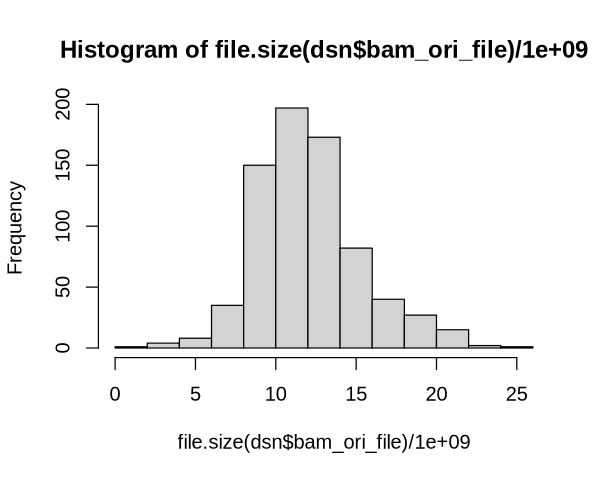

In [376]:
hist(file.size(dsn$bam_ori_file) / 1000000000)

# read tecount file

In [847]:
getwd()

[1] "/research_jude/rgs01_jude/groups/jxugrp/home/common/Lab_Members/WenhuoHu/dataset/beataml"

In [852]:
fwrite(dsn, file = 'tsv/dsn_beat_all_gdc.tsv', sep = '\t')

In [387]:
tmp = fread('tsv/dsn_beat_735cases_sep5.tsv')
dsn = merge(dsn, tmp[, .(sample_name, tecount_file, telocal_file, bam_ori_file, read_n)], by = 'sample_name', all.x = T)
dim(dsn)


[1] 735  57

In [900]:
dsn[, bam_ori_gdc_file := paste0(data_dir, 'GDCdata/', id, '/', file_name) ]

In [854]:
dsn[if_gdc == 'Yes', tecount_gdc_file := tecount_file ]

In [876]:
dsn[if_gdc == 'Yes', tecount_gdc_file ][1]
dsn[if_gdc == 'No', tecount_gdc_file ][1]

[1] "/research_jude/rgs01_jude/groups/jxugrp/home/common/Lab_Members/WenhuoHu/dataset/beataml/data/2002_BA2111/tecount.cntTable"

[1] "/research_jude/rgs01_jude/groups/jxugrp/home/common/Lab_Members/WenhuoHu/dataset/beataml/data/2000_BA2123/tecount_gdc.cntTable"

In [390]:
file.exists(dsn$tecount_file) 

[1] TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE
 [16] TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE
 [31] TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE
 [46] TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE
 [61] TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE
 [76] TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE
 [91] TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE
[106] TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE
[121] TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE
[136] TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE
[151] TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE
[166] TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE
[181] TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE
[196] TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE
[211] TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE
[226] TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE
[241] TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE
[256] TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE
[271] TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE
[286] TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE
[301] TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE
[316] TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE
[331] TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE
[346] TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE
[361] TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE
[376] TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE
[391] TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE
[406] TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE
[421] TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE
[436] TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE
[451] TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE
[466] TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE
[481] TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE
[496] TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE
[511] TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE
[526] TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE
[541] TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE
[556] TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE
[571] TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE
[586] TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE
[601] TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE
[616] TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE
[631] TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE
[646] TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE
[661] TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE
[676] TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE
[691] TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE
[706] TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE
[721] TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE

In [855]:
# this is the first try with 380 samples from bam files previously downloaded by Yuxuan
count_list = lapply(dsn[, tecount_file], function(fname){
    # message(fname)
    tmp = fread(fname)
    sname = sub('_Aligned.sortedByCoord.out.bam', '', basename(colnames(tmp)[2]))
    setnames(tmp, 1, 'gene') 
    setnames(tmp, 2, 'value')
    tmp
})
names(count_list) = dsn[file.size(bam_file) > 1000, sample_name]
count_dt = rbindlist(count_list, idcol = T)
count_dt = dcast(formula = gene ~ .id, value.var = 'value', count_dt) 
count_df = setDF(count_dt[, 2:ncol(count_dt)], rownames = count_dt$gene)
head(count_df)
saveRDS(count_df, file = 'rds/beataml_count_df_tecount.rds')


In [29]:
count_df = readRDS('rds/beataml_count_df_tecount.rds')

In [ ]:
# all bam files downloaded from GDC

count_list = lapply(1:nrow(dsn), function(ii){
    fname = dsn[ii, tecount_gdc_file]
    # message(fname)
    tmp = fread(fname)
    setnames(tmp, 1, 'gene') 
    setnames(tmp, 2, dsn[ii, sample_name])
    tmp
})

fun = function(x, y){ merge(x, y, by = 'gene') }
count_gdc_dt = Reduce(f = fun, count_list)
count_gdc_df = setDF(tecount_gdc_dt[, 2:ncol(tecount_gdc_dt)], rownames = count_gdc_dt$gene)

saveRDS(tecount_gdc_df, file = 'rds/beataml_tecount_gdc_df.rds')


In [499]:
count_gdc_df = readRDS('rds/beataml_tecount_gdc_df.rds')


In [500]:
dim(count_gdc_df)
head2(count_gdc_df)


[1] 58824   735

,2000_BA2123,2002_BA2111,2003_BA2499,2004_BA2846,2005_BA2802
,<int>,<int>,<int>,<int>,<int>
(CATTC)n:Satellite:Satellite,0,0,0,1,0
(GAATG)n:Satellite:Satellite,1,1,0,1,0
7SLRNA:srpRNA:srpRNA,0,0,0,0,0


# cpm tecount

In [27]:
library(sva)

In [502]:
coding_genes = read.table('/research_jude/rgs01_jude/groups/jxugrp/home/common/Lab_Members/WenhuoHu/collab_Farhan/coding_gene_list', header = F)$V1


In [34]:
count_df_coding = count_df[rownames(count_df) %in% coding_genes, ] 
count_df_te     = count_df[!(rownames(count_df) %in% coding_genes), ] 


In [35]:
count_gdc_df_coding = count_df[  rownames(count_gdc_df) %in% coding_genes, ] 
count_gdc_df_te     = count_df[!(rownames(count_gdc_df) %in% coding_genes), ] 

count_gdc_df_te_combat <- ComBat_seq(as.matrix(count_gdc_df_te), batch=dsn$if_gdc)
dge <- DGEList(count_gdc_df_te_combat)
dge <- calcNormFactors(dge)
logcpm_beat_te_gdc_combat = cpm(dge, normalized.lib.sizes = T, log = T)

count_gdc_df_coding_combat <- ComBat_seq(as.matrix(count_gdc_df_coding), batch=dsn$if_gdc)
dge <- DGEList(count_gdc_df_coding_combat)
dge <- calcNormFactors(dge)
logcpm_beat_coding_gdc_combat = cpm(dge, normalized.lib.sizes = T, log = T)

# protein coding 
ex = fread('/research_jude/rgs01_jude/groups/jxugrp/home/common/Lab_Members/WenhuoHu/share_data/BeatAML_671cases_logcpm.xls')
count_gdc_df_pcoding = count_gdc_df_coding[rownames(count_gdc_df_coding) %in% ex$geneName, ]
count_gdc_df_pcoding_combat <- ComBat_seq(as.matrix(count_gdc_df_pcoding), batch=dsn$if_gdc)
dge <- DGEList(count_gdc_df_pcoding_combat)
dge <- calcNormFactors(dge)
logcpm_beat_pcoding_gdc = cpm(dge, normalized.lib.sizes = T, log = T)


Found 2 batches
Using null model in ComBat-seq.
Adjusting for 0 covariate(s) or covariate level(s)
Estimating dispersions
Fitting the GLM model
Shrinkage off - using GLM estimates for parameters
Adjusting the data
Found 2 batches
Using null model in ComBat-seq.
Adjusting for 0 covariate(s) or covariate level(s)
Estimating dispersions
Fitting the GLM model
Shrinkage off - using GLM estimates for parameters
Adjusting the data
Found 2 batches
Using null model in ComBat-seq.
Adjusting for 0 covariate(s) or covariate level(s)
Estimating dispersions
Fitting the GLM model
Shrinkage off - using GLM estimates for parameters
Adjusting the data


In [36]:
all(colnames(count_gdc_df_coding) == dsn$sample_name)


[1] TRUE

In [918]:
count_gdc_df_coding_combat <- ComBat_seq(as.matrix(count_gdc_df_coding), batch=dsn$if_gdc)


Found 2 batches
Using null model in ComBat-seq.
Adjusting for 0 covariate(s) or covariate level(s)
Estimating dispersions
Fitting the GLM model
Shrinkage off - using GLM estimates for parameters
Adjusting the data


In [919]:
dge <- DGEList(count_gdc_df_coding_combat) 
dge <- calcNormFactors(dge)
logcpm_beat_coding_gdc_combat = cpm(dge, normalized.lib.sizes = T, log = T)


In [920]:
head2(logcpm_beat_coding_gdc_combat)


,2000_BA2123,2002_BA2111,2003_BA2499,2004_BA2846,2005_BA2802
A1BG,1.6595462,0.891965,2.5191907,1.407486,2.219885
A1BG-AS1,0.6123581,1.477236,0.8131289,1.976770,1.624462
A1CF,-4.0902679,-4.090268,-4.0902679,-4.090268,-4.090268


In [661]:
dim(dsn)
dim(count_df_coding)


[1] 735 177

[1] 57514   735

In [669]:
class(count_df_te)

[1] "data.frame"

In [707]:
count_df_te_combat <- ComBat_seq(as.matrix(count_df_te), batch=dsn$if_gdc)


Found 2 batches
Using null model in ComBat-seq.
Adjusting for 0 covariate(s) or covariate level(s)
Estimating dispersions
Fitting the GLM model
Shrinkage off - using GLM estimates for parameters
Adjusting the data


In [672]:
count_df_coding_combat <- ComBat_seq(as.matrix(count_df_coding), batch=dsn$if_gdc)


Found 2 batches
Using null model in ComBat-seq.
Adjusting for 0 covariate(s) or covariate level(s)
Estimating dispersions
Fitting the GLM model
Shrinkage off - using GLM estimates for parameters
Adjusting the data


In [680]:
dge <- DGEList(count_df_coding)
dge <- calcNormFactors(dge)
logcpm_beat_coding = cpm(dge, normalized.lib.sizes = T, log = T)


In [708]:
dge <- DGEList(count_df_coding_combat)
dge <- calcNormFactors(dge)
logcpm_beat_coding_combat = cpm(dge, normalized.lib.sizes = T, log = T)


In [705]:
dge <- DGEList(count_df_te)
dge <- calcNormFactors(dge)
logcpm_beat_te = cpm(dge, normalized.lib.sizes = T, log = T)


In [698]:
dge <- DGEList(count_df_te_combat)
dge <- calcNormFactors(dge)
logcpm_beat_te_combat = cpm(dge, normalized.lib.sizes = T, log = T)


In [675]:
saveRDS(count_df_te, file = 'count_df_te_735cases.rds') 
saveRDS(count_df_coding, file = 'count_df_coding_735cases.rds') 


In [688]:
saveRDS(count_df_te_combat, file = 'count_df_te_735cases_combat.rds') 
saveRDS(count_df_coding_combat, file = 'count_df_coding_735cases_combat.rds') 


In [689]:
saveRDS(logcpm_beat_te, file = 'logcpm_beat_te_combat_735cases.rds') 
saveRDS(logcpm_beat_coding, file = 'logcpm_beat_coding_combat_735cases.rds') 


In [690]:
saveRDS(logcpm_beat_te_combat, file = 'logcpm_beat_te_combat_735cases_combat.rds') 
saveRDS(logcpm_beat_coding_combat, file = 'logcpm_beat_coding_combat_735cases_combat.rds') 


In [12]:
count_df_te = readRDS('rds/beataml_logcpm_te.rds')
count_df_coding = readRDS('rds/beataml_logcpm_coding.rds')


In [ ]:
logcpm_beat_te_combat = readRDS('rds/logcpm_beat_te_combat_735cases_combat.rds')
logcpm_beat_coding_combat = readRDS('rds/logcpm_beat_coding_combat_735cases_combat.rds')


In [ ]:
logcpm_beat_te_ori = readRDS('rds/logcpm_beat_te_combat_735cases.rds')
logcpm_beat_coding_ori = readRDS('rds/logcpm_beat_coding_combat_735cases.rds')


In [400]:
dim(logcpm_beat_te_combat)
datatable(logcpm_beat_te_combat[grep('LINE$', rownames(logcpm_beat_te_combat)), ])

[1] 1310  735

HTML widgets cannot be represented in plain text (need html)

# tecount PCA

## pca analysis

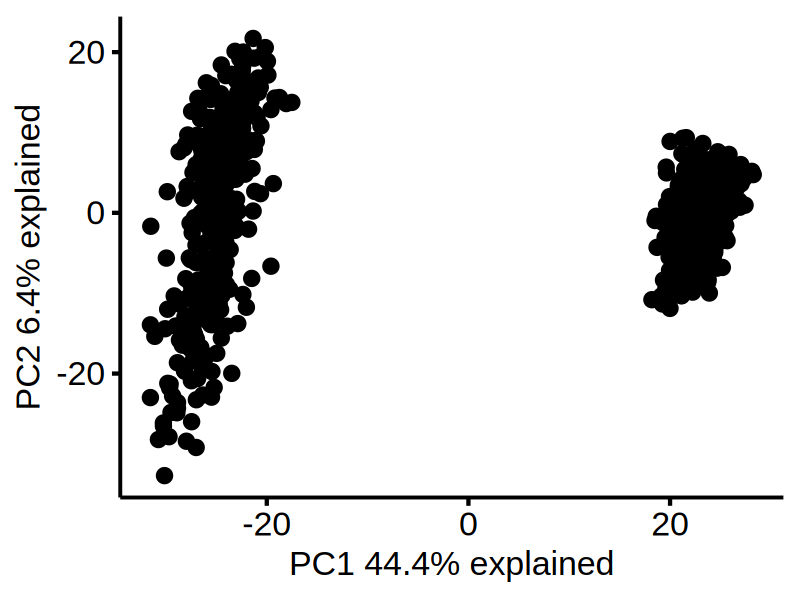

In [714]:
pc <- prcomp(t(logcpm_beat_te), center = TRUE, scale = TRUE)
lblx = paste0('PC1 ', round(100 * pc$sdev[1]^2/sum(pc$sdev^2), 1), '% explained') 
lbly = paste0('PC2 ', round(100 * pc$sdev[2]^2/sum(pc$sdev^2), 1), '% explained') 
plotdat = as.data.table(pc$x, keep.rownames = T)
#plotdat = merge(plotdat, dsn[, .(sample_name, subtype)], by.x = 'rn', by.y = 'sample_name')
options(repr.plot.width = 4, repr.plot.height = 3, repr.plot.res = 200)
ggscatter(plotdat, x = 'PC1', y = 'PC2') + xlab(lblx) + ylab(lbly)


In [904]:
head2(logcpm_beat_coding_gdc)

,2000_BA2123,2002_BA2111,2003_BA2499,2004_BA2846,2005_BA2802
A1BG,1.5688717,1.082803,2.5248340,1.312706,2.232637
A1BG-AS1,0.3550774,1.639995,0.5774915,1.896731,1.768511
A1CF,-4.0895709,-4.089571,-4.0895709,-4.089571,-4.089571


In [915]:
dsn[, bam_ori_file_size := file.size(bam_ori_file) ]
dsn[, bam_ori_gdc_file_size := file.size(bam_ori_gdc_file) ]


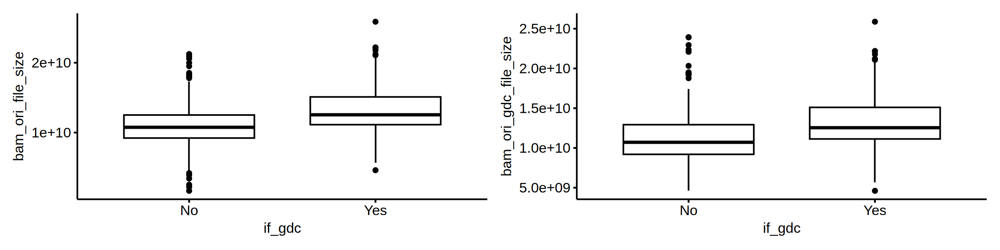

In [916]:
ggboxplot(dsn, x = 'if_gdc', y = 'bam_ori_file_size')  | 
ggboxplot(dsn, x = 'if_gdc', y = 'bam_ori_gdc_file_size') 

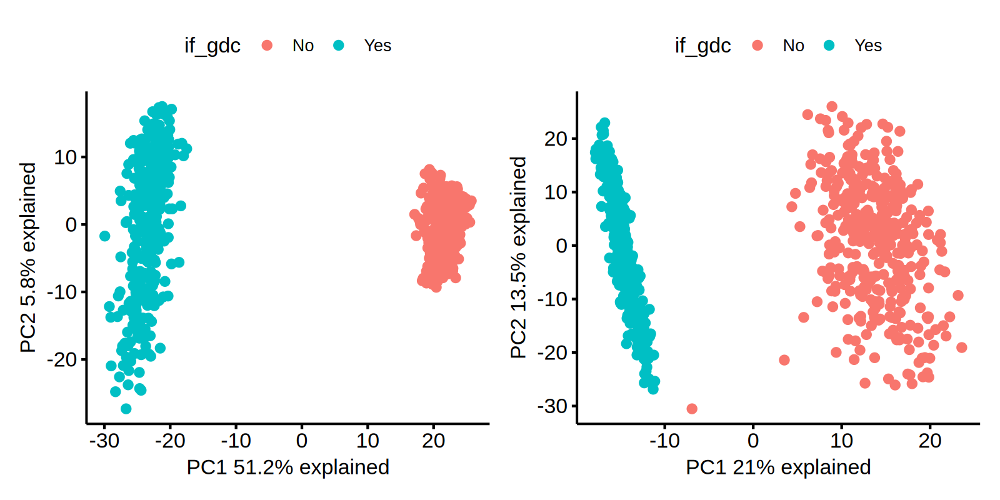

In [953]:
# PCA analysis based on TE, coding gene, and protein coding gene
plotdat = pca_fun(logcpm_beat_te_gdc) 
plotdat$plotdat$if_gdc = dsn$if_gdc
gg1 = ggscatter(plotdat$plotdat, x = 'PC1', y = 'PC2', color = 'if_gdc') + xlab(plotdat$labx) + ylab(plotdat$laby) 

plotdat = pca_fun(logcpm_beat_coding_gdc) 
plotdat$plotdat$if_gdc = dsn$if_gdc
gg2 = ggscatter(plotdat$plotdat, x = 'PC1', y = 'PC2', color = 'if_gdc') + xlab(plotdat$labx) + ylab(plotdat$laby) 

options(repr.plot.width = 8, repr.plot.height = 4, repr.plot.res = 200)
gg1 | gg2 


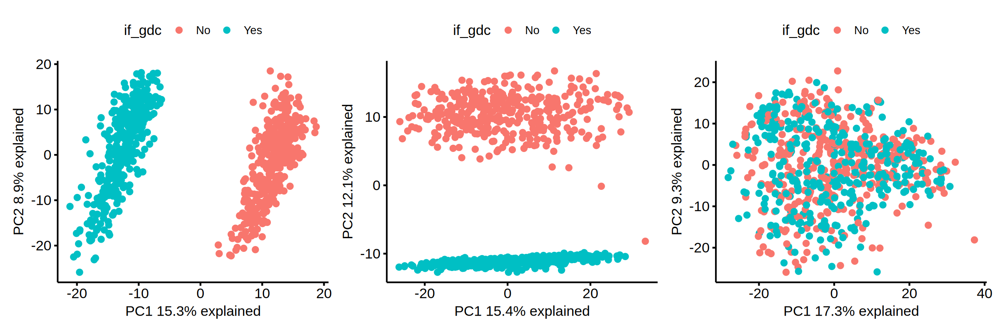

In [947]:
# PCA analysis based on TE, coding gene, and protein coding gene
plotdat = pca_fun(logcpm_beat_te_gdc_combat) 
plotdat$plotdat$if_gdc = dsn$if_gdc
gg1 = ggscatter(plotdat$plotdat, x = 'PC1', y = 'PC2', color = 'if_gdc') + xlab(plotdat$labx) + ylab(plotdat$laby) 

plotdat = pca_fun(logcpm_beat_coding_gdc_combat) 
plotdat$plotdat$if_gdc = dsn$if_gdc
gg2 = ggscatter(plotdat$plotdat, x = 'PC1', y = 'PC2', color = 'if_gdc') + xlab(plotdat$labx) + ylab(plotdat$laby) 

plotdat = pca_fun(logcpm_beat_pcoding_gdc) 
plotdat$plotdat$if_gdc = dsn$if_gdc
gg3 = ggscatter(plotdat$plotdat, x = 'PC1', y = 'PC2', color = 'if_gdc') + xlab(plotdat$labx) + ylab(plotdat$laby) 

options(repr.plot.width = 12, repr.plot.height = 4, repr.plot.res = 200)
gg1 | gg2 | gg3


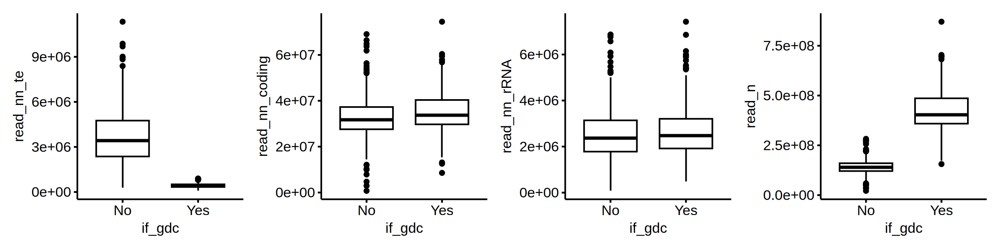

In [951]:
plotdat$plotdat$read_n = dsn$read_n
plotdat$plotdat$if_gdc = dsn$if_gdc
plotdat$plotdat$read_nn_te = colSums(count_gdc_df_te) 
plotdat$plotdat$read_nn_coding = colSums(count_gdc_df_coding) 
plotdat$plotdat$read_nn_rRNA = colSums(count_gdc_df_coding[grepl("^RPL|^RPS", rownames(count_gdc_df_coding)), ]) 
options(repr.plot.width = 12, repr.plot.height = 3, repr.plot.res = 200)
ggboxplot(plotdat$plotdat, x = 'if_gdc', y = 'read_nn_te') | 
ggboxplot(plotdat$plotdat, x = 'if_gdc', y = 'read_nn_coding') | 
ggboxplot(plotdat$plotdat, x = 'if_gdc', y = 'read_nn_rRNA') |
ggboxplot(plotdat$plotdat, x = 'if_gdc', y = 'read_n') 


In [521]:
dsn[, subtype_pca := 'PC1_lo' ]
dsn[sample_name %in% plotdat[PC1 > 0, rn], subtype_pca := 'PC1_hi' ]
dsn[, subtype_pca := factor(subtype_pca, levels = c('PC1_lo', 'PC1_hi')) ]


In [522]:
fwrite(dsn, file = 'dsn_beat_sep6.tsv')


In [958]:
gene_info = fread('/home/whu78/script/dataset/gene_info_9606')
setkey(gene_info, 'Symbol')
head2(gene_info) 


tax_id,GeneID,Symbol,LocusTag,Synonyms
<int>,<int>,<chr>,<chr>,<chr>
9606,1,A1BG,-,A1B|ABG|GAB|HYST2477
9606,2,A2M,-,A2MD|CPAMD5|FWP007|S863-7
9606,3,A2MP1,-,A2MP


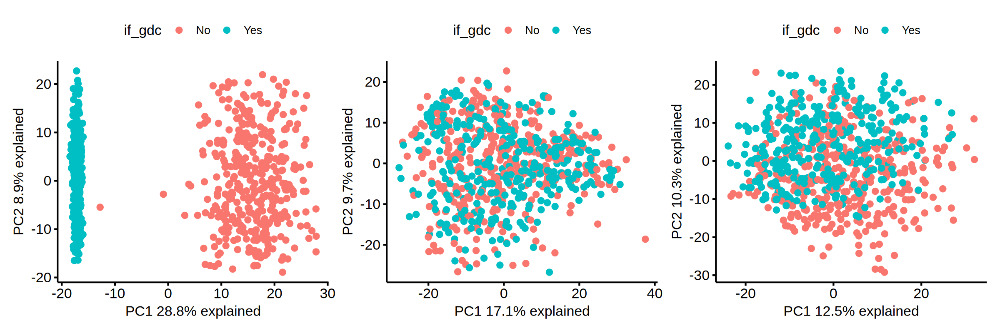

In [981]:
plotdat = as.data.table(logcpm_beat_coding_gdc_combat, keep.rownames = T)
plotdat = merge(plotdat, gene_info[, .(Symbol, type_of_gene) ], by.x = 'rn', by.y = 'Symbol') 

plotdat1 = plotdat[type_of_gene %in% 'ncRNA', ] 
plotdat1 = setDF(plotdat1[, 2:(ncol(plotdat) - 1)], rownames = plotdat1$rn)
plotdat1 = plotdat1[!duplicated(rownames(plotdat1)), ]
plotdat1 = pca_fun(plotdat1) 
plotdat1$plotdat$if_gdc = dsn$if_gdc
gg1 = ggscatter(plotdat1$plotdat, x = 'PC1', y = 'PC2', color = 'if_gdc') + xlab(plotdat1$labx) + ylab(plotdat1$laby) 

plotdat1 = plotdat[type_of_gene %in% 'protein-coding', ] 
plotdat1 = setDF(plotdat1[, 2:(ncol(plotdat) - 1)], rownames = plotdat1$rn)
plotdat1 = plotdat1[!duplicated(rownames(plotdat1)), ]
plotdat1 = pca_fun(plotdat1) 
plotdat1$plotdat$if_gdc = dsn$if_gdc
gg2 = ggscatter(plotdat1$plotdat, x = 'PC1', y = 'PC2', color = 'if_gdc') + xlab(plotdat1$labx) + ylab(plotdat1$laby) 

plotdat1 = plotdat[type_of_gene %in% 'pseudo', ] 
plotdat1 = setDF(plotdat1[, 2:(ncol(plotdat) - 1)], rownames = plotdat1$rn)
plotdat1 = plotdat1[!duplicated(rownames(plotdat1)), ]
plotdat1 = pca_fun(plotdat1) 
plotdat1$plotdat$if_gdc = dsn$if_gdc
gg3 = ggscatter(plotdat1$plotdat, x = 'PC1', y = 'PC2', color = 'if_gdc') + xlab(plotdat1$labx) + ylab(plotdat1$laby) 

options(repr.plot.width = 12, repr.plot.height = 4, repr.plot.res = 200)
gg1 | gg2 | gg3


In [984]:
dsn[if_gdc == 'No', bam_ori_file][1]


[1] "/research_jude/rgs01_jude/groups/jxugrp/home/common/Lab_Members/YuxuanLiu/Data_Yuxuan/BEAT_AML/./AML_samples_bam_1/2000_BA2123/2000_BA2123.bqsr.bam"

In [17]:
#fwrite(dsn, file = 'tsv/dsn_beataml_sep11.tsv', sep = '\t')
dsn = fread('tsv/dsn_beataml_sep11.tsv')


## DEG TE

- BEAT AML will analyzed as two separate cohorts

In [18]:
dim(dsn[if_gdc == 'Yes', ])
dim(dsn[if_gdc == 'No', ])


[1] 355  85

[1] 380  85

In [991]:
dim(dsn)
count_df_coding_b1 = count_gdc_df[rownames(count_gdc_df) %in% coding_genes, dsn[if_gdc == 'Yes', sample_name]] # 355 cases

[1] 735  85

In [20]:
beat_clin = fread('/research_jude/rgs01_jude/groups/jxugrp/home/common/Lab_Members/WenhuoHu/share_data/BeatAML_671cases_clincalInfo.xls')
beat_clin[, sample_name := paste0(dbgap_subject_id, '_', sub('R$', '', sampleName)) ]
head(beat_clin)


sampleName,dbgap_subject_id,dbgap_dnaseq_sample,dbgap_rnaseq_sample,cohort,used_manuscript_analyses,manuscript_dnaseq,manuscript_rnaseq,manuscript_inhibitor,consensus_sex,⋯,ASXL1_mut,NRAS_mut,JAK2_mut,GNB1_mut,KRAS_mut,CBL_mut,IDH1_mut,IDH2_mut,OS_Stat,sample_name
<chr>,<int>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,⋯,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<int>,<chr>
BA2452R,2157,BA2452D,BA2452R,Both,no,no,no,no,Male,⋯,WT,WT,WT,WT,WT,WT,WT,WT,1,2157_BA2452
BA2922R,2269,,BA2922R,Waves1+2,yes,no,yes,yes,Male,⋯,WT,WT,WT,WT,WT,WT,WT,WT,1,2269_BA2922
BA2707R,2313,BA2707D,BA2707R,Both,no,no,no,no,Male,⋯,WT,WT,WT,WT,WT,WT,WT,WT,1,2313_BA2707
BA2409R,2418,,BA2409R,Waves1+2,yes,no,yes,yes,Female,⋯,WT,WT,WT,WT,WT,WT,WT,WT,1,2418_BA2409
BA2480R,2374,,BA2480R,Waves1+2,yes,no,yes,no,Male,⋯,WT,WT,WT,WT,WT,WT,WT,WT,1,2374_BA2480
BA2496R,2099,,BA2496R,Waves1+2,yes,no,yes,yes,Male,⋯,WT,WT,WT,WT,WT,WT,WT,WT,1,2099_BA2496


In [503]:
count_df_coding_b1 = count_gdc_df[rownames(count_gdc_df) %in% coding_genes, dsn_b1[, sample_name]] # 355 cases
count_df_coding_b2 = count_gdc_df[rownames(count_gdc_df) %in% coding_genes, dsn_b2[, sample_name]]  # 380 cases

count_df_te_b1 = count_gdc_df[! rownames(count_gdc_df) %in% coding_genes, dsn_b1[, sample_name]]
count_df_te_b2 = count_gdc_df[! rownames(count_gdc_df) %in% coding_genes, dsn_b2[, sample_name]] 


In [38]:
source('~/script/utils.r')

In [504]:
logcpm_te_b1 = cpm_fun(count_df_te_b1)
logcpm_te_b2 = cpm_fun(count_df_te_b2)


In [1049]:
deg_te_b1_list = lapply(aml_mut, function(gene_mut){
    dsn_wt = dsn_b1[dsn_b1$karyotype == 'Normal', ]
    dsn_wt = dsn_wt[get(gene_mut) == 'WT', ]
    dsn_wt$group = 'WT'
    dsn_mut = dsn_b1[get(gene_mut) != 'WT', ]
    dsn_mut$group = 'mut'
    if(nrow(dsn_wt) > 10 & nrow(dsn_mut) > 4){
        dsn_sel = rbind(dsn_wt, dsn_mut)
        dsn_sel$group = factor(dsn_sel$group, levels = c('WT', 'mut'))
        mtx = count_df_te_b1[, dsn_sel$sample_name]
        deg_fun2(dsn_sel, mtx)
    }
})
names(deg_te_b1_list) = aml_mut
deg_te_b1_list = deg_te_b1_list[!is.na(deg_te_b1_list)]

deg_te_b1_dt = rbindlist(deg_te_b1_list, idcol = T)
deg_te_b1_dt$batch = 'Batch1'

deg_te_b2_list = lapply(aml_mut, function(gene_mut){
    dsn_wt = dsn_b2[dsn_b2$karyotype == 'Normal', ]
    dsn_wt = dsn_wt[get(gene_mut) == 'WT', ]
    dsn_wt$group = 'WT'
    dsn_mut = dsn_b2[get(gene_mut) != 'WT', ]
    dsn_mut$group = 'mut'
    if(nrow(dsn_wt) > 10 & nrow(dsn_mut) > 4){
        dsn_sel = rbind(dsn_wt, dsn_mut)
        dsn_sel$group = factor(dsn_sel$group, levels = c('WT', 'mut'))
        mtx = count_df_te_b2[, dsn_sel$sample_name]
        deg_fun2(dsn_sel, mtx)
    }
})
names(deg_te_b2_list) = aml_mut
deg_te_b2_list = deg_te_b2_list[!is.na(deg_te_b2_list)]
deg_te_b2_dt = rbindlist(deg_te_b2_list, idcol = T)
deg_te_b2_dt$batch = 'Batch2'


In [1127]:
deg_te_dt[, class_id := unlist(strsplit(rn, ':'))[3], by = 1:nrow(deg_te_dt) ]
deg_te_dt[, family_id := unlist(strsplit(rn, ':'))[2], by = 1:nrow(deg_te_dt) ]
deg_te_dt[, gene_id := unlist(strsplit(rn, ':'))[1], by = 1:nrow(deg_te_dt) ]

saveRDS(deg_te_dt, file = 'deg_te_dt.rds')


In [40]:
deg_te_dt = readRDS('deg_te_dt.rds')

In [41]:
head(deg_te_dt)

.id,rn,logFC,logCPM,PValue,FDR,batch,class_id,family_id,gene_id
<chr>,<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<chr>,<chr>,<chr>,<chr>
TP53_mut,UCON41:Unknown:Unknown,3.8504681,5.740474,6.197588e-09,8.118840e-06,Batch1,Unknown,Unknown,UCON41
TP53_mut,LTR76:ERV1:LTR,1.0271402,8.551879,2.416897e-06,1.583068e-03,Batch1,LTR,ERV1,LTR76
TP53_mut,L1MA4A:L1:LINE,1.0864904,8.086361,9.139608e-06,3.990962e-03,Batch1,LINE,L1,L1MA4A
TP53_mut,LTR75:ERVL:LTR,0.9631071,7.196139,8.245217e-05,2.324938e-02,Batch1,LTR,ERVL,LTR75
TP53_mut,MER4-int:ERV1:LTR,-0.7402220,10.287484,8.873810e-05,2.324938e-02,Batch1,LTR,ERV1,MER4-int
TP53_mut,L1M4a2:L1:LINE,1.3092882,7.461221,3.516791e-04,6.495455e-02,Batch1,LINE,L1,L1M4a2


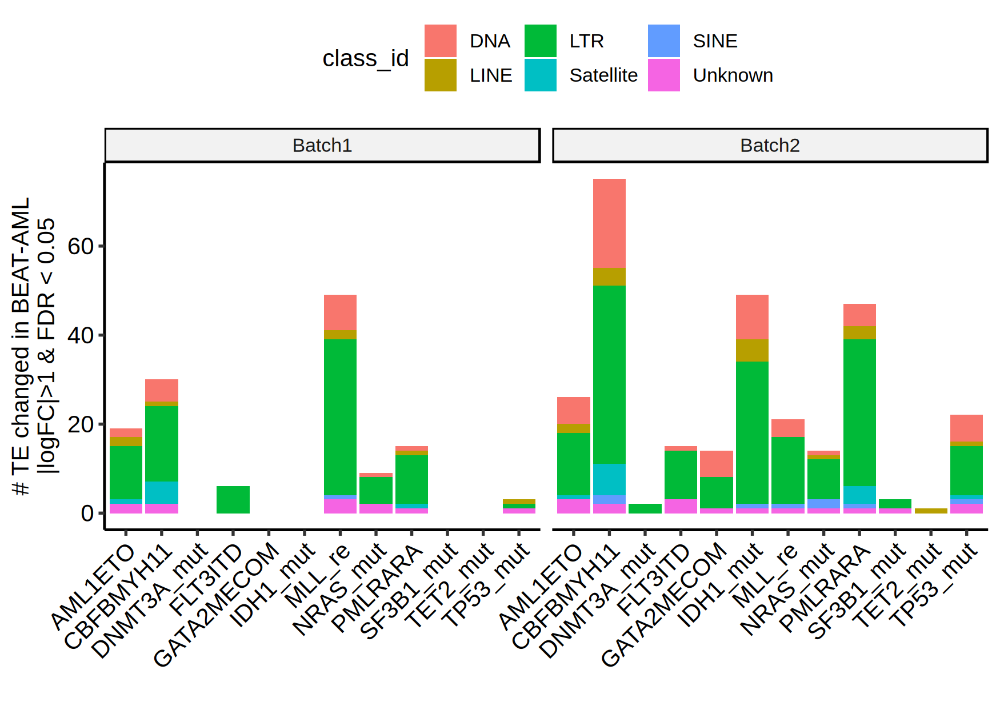

In [1058]:
options(repr.plot.width = 7, repr.plot.height = 5, repr.plot.res = 250)
plotdat = deg_te_dt[abs(logFC) > 1 & FDR < 0.05, ]
options(repr.plot.width = 7, repr.plot.height = 5, repr.plot.res = 250)
ggplot(plotdat, aes(x = .id, fill = class_id)) + geom_bar() + theme_pubr() + theme(axis.text.x = element_text(angle = 45, vjust = 1, hjust = 1)) + 
xlab('') + ylab('# TE changed in BEAT-AML\n|logFC|>1 & FDR < 0.05') + facet_wrap(~ batch)

In [43]:
dim(count_df_te_b1)
dim(count_df_te_b2)


[1] 1310  312

[1] 1310  359

In [1059]:
dge = DGEList(counts = count_df_te_b1)
dge = calcNormFactors(dge)
dge = normLibSizes(dge)
mtx = cpm(dge, normalized.lib.sizes = T, log = F)
mtx = log2(mtx + 1)
logcpm_te_b1 = copy(mtx)

dge = DGEList(counts = count_df_te_b2)
dge = calcNormFactors(dge)
dge = normLibSizes(dge)
mtx = cpm(dge, normalized.lib.sizes = T, log = F)
mtx = log2(mtx + 1)
logcpm_te_b2 = copy(mtx)


In [1115]:
deg_te_dt[, class_id := unlist(strsplit(rn, ':'))[3], by = 1:nrow(deg_te_dt)]
deg_te_dt[, family_id := unlist(strsplit(rn, ':'))[2], by = 1:nrow(deg_te_dt)]
deg_te_dt[, gene_id := unlist(strsplit(rn, ':'))[1], by = 1:nrow(deg_te_dt)]

In [1078]:
saveRDS(deg_te_dt, file = 'deg_te_dt_twoBatch_beataml.rds')

In [1079]:
dim(logcpm_te_b1) 
dim(logcpm_te_b2) 

[1] 1310  312

[1] 1310  359

In [1114]:
head(deg_te_dt)

.id,rn,logFC,logCPM,PValue,FDR,batch,class_id,family_id,gene_id
<chr>,<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<chr>,<chr>,<chr>,<chr>
TP53_mut,UCON41:Unknown:Unknown,3.8504681,5.740474,6.197588e-09,8.118840e-06,Batch1,Unknown,Unknown,UCON41
TP53_mut,LTR76:ERV1:LTR,1.0271402,8.551879,2.416897e-06,1.583068e-03,Batch1,LTR,ERV1,LTR76
TP53_mut,L1MA4A:L1:LINE,1.0864904,8.086361,9.139608e-06,3.990962e-03,Batch1,LINE,L1,L1MA4A
TP53_mut,LTR75:ERVL:LTR,0.9631071,7.196139,8.245217e-05,2.324938e-02,Batch1,LTR,ERVL,LTR75
TP53_mut,MER4-int:ERV1:LTR,-0.7402220,10.287484,8.873810e-05,2.324938e-02,Batch1,LTR,ERV1,MER4-int
TP53_mut,L1M4a2:L1:LINE,1.3092882,7.461221,3.516791e-04,6.495455e-02,Batch1,LINE,L1,L1M4a2


In [1080]:
saveRDS(logcpm_te_b1, file = 'logcpm_te_batch1_312cases.rds')
saveRDS(logcpm_te_b2, file = 'deg_te_dt_twoBatch_beataml_359cases.rds')


# TEcount summary

In [44]:
dsn_b2[, subtype := paste(setdiff(unlist(.SD[, aml_mut, with = F]), 'WT'), collapse = '__'), by = 1:nrow(dsn_b2)]
dsn_b2[subtype == '', subtype := 'WT']


In [45]:
subtype_sel = c('CBFB-MYH11', 'DNMT3A_mut', 'FLT3-ITD', 'PML-RARA', 'MLL_re', 'GATA2-MECOM', 'AML1-ETO', 'NRAS_mut', 'TP53_mut')
subtype_sel


[1] "CBFB-MYH11"  "DNMT3A_mut"  "FLT3-ITD"    "PML-RARA"    "MLL_re"     
[6] "GATA2-MECOM" "AML1-ETO"    "NRAS_mut"    "TP53_mut"

In [49]:
nn = lapply(aml_mut, function(mut){
    nrow(dsn_b2[get(mut) != 'WT',])
})
names(nn) = aml_mut
subtypes = names(nn[nn > 10])
subtypes

[1] "DNMT3A_mut" "NRAS_mut"   "FLT3ITD"    "PMLRARA"    "CBFBMYH11"

In [51]:
dsn_b2[, subtype2 := 'WT'] 
dsn_b2[grep('CBFB-MYH11', subtype), subtype2 := 'CBFBMYH11' ]
#dsn_b2[grep('DNMT3A_mut', subtype), subtype2 := 'DNMT3A_mut' ]
dsn_b2[grep('FLT3-ITD', subtype), subtype2 := 'FLT3ITD' ]
dsn_b2[grep('PML-RARA', subtype), subtype2 := 'PMLRARA' ]
dsn_b2[grep('MLL_re', subtype), subtype2 := 'MLL_re' ]
dsn_b2[grep('GATA2-MECOM', subtype), subtype2 := 'GATA2MECOM' ]
dsn_b2[grep('AML1-ETO', subtype), subtype2 := 'AML1ETO' ]
#dsn_b2[grep('NRAS_mut', subtype), subtype2 := 'NRAS_mut' ]
dsn_b2[grep('TP53_mut', subtype), subtype2 := 'TP53_mut' ]


In [52]:
table(dsn_b2$subtype2)


   AML1ETO  CBFBMYH11    FLT3ITD GATA2MECOM     MLL_re    PMLRARA   TP53_mut 
        10         18         59          8          9         12          8 
        WT 
       235 

In [1433]:
lvl

[1] "AML1ETO"    "FLT3ITD"    "GATA2MECOM" "MLL_re"     "PMLRARA"   
[6] "TP53_mut"   "CBFB-MYH11" "WT"

In [1450]:
sel = deg_te_dt[batch == 'Batch2' & class_id %in% c('LTR') & logFC > 0 & FDR < .1 , ] 
sel[, subtype := .id]
subtype_sel = names( table(sel$subtype) )
subtype_sel
subtype_sel = c('AML1ETO', 'FLT3ITD', 'GATA2MECOM', 'MLL_re', 'PMLRARA', 'TP53_mut', 'CBFBMYH11') 
subtype_sel
subtype_sel = c('AML1ETO', 'MLL_re', 'PMLRARA')
lvl = c(subtype_sel, 'WT')


[1] "AML1ETO"    "CBFBMYH11"  "DNMT3A_mut" "FLT3ITD"    "GATA2MECOM"
 [6] "IDH1_mut"   "MLL_re"     "NRAS_mut"   "PMLRARA"    "SF3B1_mut" 
[11] "TP53_mut"

[1] "AML1ETO"    "FLT3ITD"    "GATA2MECOM" "MLL_re"     "PMLRARA"   
[6] "TP53_mut"   "CBFBMYH11"

In [53]:
dsn_b2[, subtype2 := 'WT'] 
#dsn_b2[grep('CBFB-MYH11', subtype), subtype2 := 'CBFBMYH11' ]
#dsn_b2[grep('DNMT3A_mut', subtype), subtype2 := 'DNMT3A_mut' ]
#dsn_b2[grep('FLT3-ITD', subtype), subtype2 := 'FLT3ITD' ]
dsn_b2[grep('PML-RARA', subtype), subtype2 := 'PMLRARA' ]
dsn_b2[grep('MLL_re', subtype), subtype2 := 'MLL_re' ]
#dsn_b2[grep('GATA2-MECOM', subtype), subtype2 := 'GATA2MECOM' ]
dsn_b2[grep('AML1-ETO', subtype), subtype2 := 'AML1ETO' ]
#dsn_b2[grep('NRAS_mut', subtype), subtype2 := 'NRAS_mut' ]
#dsn_b2[grep('TP53_mut', subtype), subtype2 := 'TP53_mut' ]


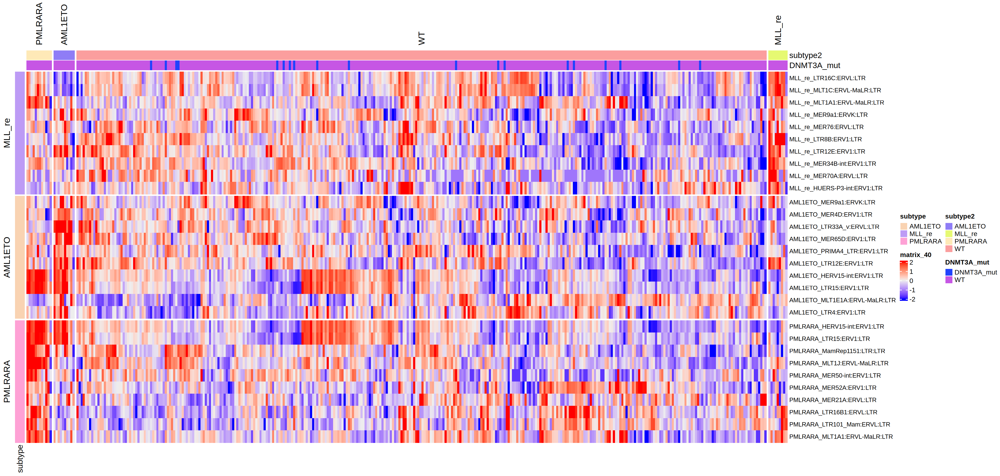

In [1454]:
sel = deg_te_dt[batch == 'Batch2' & class_id %in% c('LTR') & logFC > 0 & FDR < .1 & .id %in% subtype_sel, ] %>% group_by(.id) %>% slice_min(FDR, n = 10) %>% as.data.table()
sel[, subtype := .id]
row_ann = sel[, .(rn, subtype, class_id)]
row_ann[, rname := paste0(subtype, '_', rn) ]
row_ann[, subtype := factor(subtype, levels = subtype_sel)]
row_ann = row_ann[order(subtype), ]
row_ann_df = setDF(row_ann[, 1:ncol(row_ann)], rownames = row_ann$rname)

col_ann = copy(dsn_b2) #[subtype %in% subtype_sel, .(sample_name, subtype)]
col_ann[, subtype2 := factor(subtype2, levels = lvl) ]
col_ann = col_ann[order(subtype2), ]
col_ann_df =  setDF(col_ann[, 2:ncol(col_ann)], rownames = col_ann$sample_name) 

plotdat = logcpm_te_b2[row_ann$rn, rownames(col_ann_df)]
rownames(plotdat) = rownames(row_ann_df)
plotdat = scale_fun(plotdat)
plotdat[plotdat > 2] = 2
plotdat[plotdat < -2] = -2
column_ha = HeatmapAnnotation(df = col_ann_df[, c('subtype2', 'DNMT3A_mut'), drop = F])
row_ha    = rowAnnotation(df = row_ann_df[, 'subtype', drop = F])
args = list(matrix = plotdat, top_annotation = column_ha,  column_split = factor(col_ann_df$subtype2, levels = lvl),#, levels = subtype_sel), 
            show_column_names = F, 
            show_row_names = T, show_column_dend = F, cluster_columns = T,  cluster_rows = T, row_names_gp = grid::gpar(fontsize = 9), 
            show_row_dend = F, column_title_rot = 90, left_annotation = row_ha, row_split = factor(row_ann_df$subtype, levels = (subtype_sel)))
hp = do.call(Heatmap, args)
options(repr.plot.width = 21, repr.plot.height = 10, repr.plot.res = 200)
draw(hp)


In [54]:
tmp1 = deg_te_dt[batch == 'Batch2' & .id == 'FLT3ITD' & FDR < 0.1 & logFC > 0, rn]
tmp2 = deg_te_dt[batch == 'Batch2' & .id == 'PMLRARA' & FDR < 0.1 & logFC > 0, rn]
length(intersect(tmp1, tmp2)) 
length(tmp1) 
length(tmp2) 


[1] 13

[1] 44

[1] 80

# read telocal file & DEG 


In [483]:
dsn[, telocal_file_size := file.size(telocal_file)]

In [15]:
dim(dsn)

[1] 735  55

In [26]:
ii =1 
dsn[ii, sample_name]

[1] "2219_BA2244"

In [ ]:
telocal_dt = fread(dsn[1, telocal_file])
setnames(telocal_dt, 1, 'gene')
setnames(telocal_dt, 2, dsn[1, sample_name])


In [28]:
for(ii in 2:nrow(dsn)){
    tmp = fread(dsn[1, telocal_file])
    setnames(tmp, 1, 'gene')
    setnames(tmp, 2, dsn[ii, sample_name])
    telocal_dt = merge(telocal_dt, tmp, by = 'gene')
}


In [ ]:
head(telocal_dt)

In [30]:
dim(telocal_dt)

[1] 3845463     736

In [29]:
#saveRDS(telocal_dt, file = 'rds/telocal_dt_736cases.rds')
telocal_dt = readRDS(file = 'rds/telocal_dt_736cases.rds')

In [39]:
#dsn_b1 = dsn[if_gdc == 'Yes' & sample_name %in% beat_clin$sample_name, ]
#dsn_b2 = dsn[if_gdc == 'No' & sample_name %in% beat_clin$sample_name, ]
#dsn_b1 = merge(dsn_b1, beat_clin, by = 'sample_name')
#dsn_b2 = merge(dsn_b2, beat_clin, by = 'sample_name')

telocal_df = setDF(telocal_dt[, 2:ncol(telocal_dt)], rownames = telocal_dt$gene)
telocal_df_b1 = telocal_df[, dsn_b1[, sample_name]]
telocal_df_b2 = telocal_df[, dsn_b2[, sample_name]]


In [1092]:
row_sum_b1 = rowSums(telocal_df_b1)
row_sum_b2 = rowSums(telocal_df_b2)


In [1093]:
summary(row_sum_b1)
summary(row_sum_b2)


     Min.   1st Qu.    Median      Mean   3rd Qu.      Max. 
        0         0         0      2948         0 193586493 

     Min.   1st Qu.    Median      Mean   3rd Qu.      Max. 
        0         0         0      3214        10 202371985 

In [40]:
dim(telocal_df_b1)
dim(telocal_df_b2)


[1] 3845463     312

[1] 3845463     359

In [41]:
logcpm_telocal_b1 = logcpm_fun(telocal_df_b1) 
logcpm_telocal_b2 = logcpm_fun(telocal_df_b2) 


In [1101]:
dim(telocal_df_b1[row_sum_b1 >  312 * 5, ])
dim(telocal_df_b2[row_sum_b2 >  359 * 5, ])

[1] 27256   312

[1] 92102   359

In [1102]:
telocal_df_sel_1 = telocal_df_b1[row_sum_b1 > 312 * 5, ]
telocal_df_sel_2 = telocal_df_b2[row_sum_b2 > 359 * 5, ]


In [1104]:
saveRDS(telocal_df_sel_1, file = 'rds/telocal_df_batch1.rds')
saveRDS(telocal_df_sel_2, file = 'rds/telocal_df_batch2.rds')


In [55]:
telocal_df_sel_1 = readRDS('rds/telocal_df_batch1.rds')
telocal_df_sel_2 = readRDS('rds/telocal_df_batch2.rds')


In [1103]:
dge = DGEList(counts = telocal_df_sel_1, group = NULL)
dge = calcNormFactors(dge)
dge = normLibSizes(dge)
logcpm_telocal_b1 = cpm(telocal_df_sel_1, log = T)

dge = DGEList(counts = telocal_df_sel_2, group = NULL)
dge = calcNormFactors(dge)
dge = normLibSizes(dge)
logcpm_telocal_b2 = cpm(telocal_df_sel_2, log = T)


In [1105]:
saveRDS(logcpm_telocal_b1, file = 'rds/logcpm_telocal_b1.rds')
saveRDS(logcpm_telocal_b2, file = 'rds/logcpm_telocal_b2.rds')


In [42]:
head(logcpm_telocal_b2) 

,2000_BA2123,2003_BA2499,2004_BA2846,2008_BA2676,2010_BA2304,2014_BA2226,2015_BA2861,2016_BA2816,2018_BA2950,2019_BA2905,⋯,2566_BA2577,2566_BA2748,2567_BA2511,2568_BA2880,2572_BA2228,2573_BA2791,2574_BA2282,2575_BA2464,2576_BA2636,2577_BA2944
(CATTC)n:(CATTC)n:Satellite:Satellite,-4.122279,-4.122279,-4.122279,-4.122279,-4.122279,-4.122279,-4.122279,-4.122279,-4.122279,-4.122279,⋯,-4.122279,-4.122279,-4.122279,-4.122279,-4.122279,-4.122279,-4.122279,-4.122279,-4.122279,-4.122279
(CATTC)n_dup100:(CATTC)n:Satellite:Satellite,-4.122279,-4.122279,-4.122279,-4.122279,-4.122279,-4.122279,-4.122279,-4.122279,-4.122279,-4.122279,⋯,-4.122279,-4.122279,-4.122279,-4.122279,-4.122279,-4.122279,-4.122279,-4.122279,-4.122279,-4.122279
(CATTC)n_dup101:(CATTC)n:Satellite:Satellite,-4.122279,-4.122279,-4.122279,-4.122279,-4.122279,-4.122279,-4.122279,-4.122279,-4.122279,-4.122279,⋯,-4.122279,-4.122279,-4.122279,-4.122279,-4.122279,-4.122279,-4.122279,-4.122279,-4.122279,-4.122279
(CATTC)n_dup102:(CATTC)n:Satellite:Satellite,-4.122279,-4.122279,-4.122279,-4.122279,-4.122279,-4.122279,-4.122279,-4.122279,-4.122279,-4.122279,⋯,-4.122279,-4.122279,-4.122279,-4.122279,-4.122279,-4.122279,-4.122279,-4.122279,-4.122279,-4.122279
(CATTC)n_dup103:(CATTC)n:Satellite:Satellite,-4.122279,-4.122279,-4.122279,-4.122279,-4.122279,-4.122279,-4.122279,-4.122279,-4.122279,-4.122279,⋯,-4.122279,-4.122279,-4.122279,-4.122279,-4.122279,-4.122279,-4.122279,-4.122279,-4.122279,-4.122279
(CATTC)n_dup104:(CATTC)n:Satellite:Satellite,-4.122279,-4.122279,-4.122279,-4.122279,-4.122279,-4.122279,-4.122279,-4.122279,-4.122279,-4.122279,⋯,-4.122279,-4.122279,-4.122279,-4.122279,-4.122279,-4.122279,-4.122279,-4.122279,-4.122279,-4.122279


In [1111]:
fwrite(dsn_b1, file = 'tsv/dsn_b1.tsv', sep = '\t') 
fwrite(dsn_b2, file = 'tsv/dsn_b2.tsv', sep = '\t') 


In [58]:
library(edgeR)
library(BiocParallel)
library(data.table)
register(MulticoreParam(10))

source('~/script/utils.r')

dsn_b1 = fread('tsv/dsn_b1.tsv')
dsn_b2 = fread('tsv/dsn_b2.tsv')

telocal_df_sel_1 = readRDS(file = 'rds/telocal_df_batch1.rds')
telocal_df_sel_2 = readRDS(file = 'rds/telocal_df_batch2.rds')

deg_telocal_b1_list = lapply(aml_mut, function(gene_mut){
    dsn_wt = dsn_b1[dsn_b1$karyotype == 'Normal', ]
    dsn_wt = dsn_wt[get(gene_mut) == 'WT', ]
    dsn_wt$group = 'WT'
    dsn_mut = dsn_b1[get(gene_mut) != 'WT', ]
    dsn_mut$group = 'mut'
    if(nrow(dsn_wt) > 10 & nrow(dsn_mut) > 4){
        dsn_sel = rbind(dsn_wt, dsn_mut)
        dsn_sel$group = factor(dsn_sel$group, levels = c('WT', 'mut'))
        mtx = telocal_df_sel_1[, dsn_sel$sample_name]
        deg_fun2(dsn_sel, mtx)
    }
})
names(deg_telocal_b1_list) = aml_mut
deg_telocal_b1_list = deg_telocal_b1_list[!is.na(deg_telocal_b1_list)]

deg_telocal_b1_dt = rbindlist(deg_telocal_b1_list, idcol = T)
deg_telocal_b1_dt$batch = 'Batch1'

deg_telocal_b2_list = lapply(aml_mut, function(gene_mut){
    dsn_wt = dsn_b2[dsn_b2$karyotype == 'Normal', ]
    dsn_wt = dsn_wt[get(gene_mut) == 'WT', ]
    dsn_wt$group = 'WT'
    dsn_mut = dsn_b2[get(gene_mut) != 'WT', ]
    dsn_mut$group = 'mut'
    if(nrow(dsn_wt) > 10 & nrow(dsn_mut) > 4){
        dsn_sel = rbind(dsn_wt, dsn_mut)
        dsn_sel$group = factor(dsn_sel$group, levels = c('WT', 'mut'))
        mtx = telocal_df_sel_2[, dsn_sel$sample_name]
        deg_fun2(dsn_sel, mtx)
    }
})
names(deg_telocal_b2_list) = aml_mut
deg_telocal_b2_list = deg_telocal_b2_list[!is.na(deg_telocal_b2_list)]
deg_telocal_b2_dt = rbindlist(deg_telocal_b2_list, idcol = T)
deg_telocal_b2_dt$batch = 'Batch2'


ERROR: Error in DGEList.default(counts = mtx, group = groups): Negative counts not allowed


In [ ]:
saveRDS(deg_telocal_b1_dt, file = 'deg_telocal_b1_dt.rds')
saveRDS(deg_telocal_b2_dt, file = 'deg_telocal_b2_dt.rds')


# DEG telocal deprecated

In [ ]:
deg_telocal_b1_list = lapply(aml_mut, function(gene_mut){
    dsn_wt = dsn_b1[dsn_b1$karyotype == 'Normal', ]
    dsn_wt = dsn_wt[get(gene_mut) == 'WT', ]
    dsn_wt$group = 'WT'
    dsn_mut = dsn_b1[get(gene_mut) != 'WT', ]
    dsn_mut$group = 'mut'
    if(nrow(dsn_wt) > 10 & nrow(dsn_mut) > 4){
        dsn_sel = rbind(dsn_wt, dsn_mut)
        dsn_sel$group = factor(dsn_sel$group, levels = c('WT', 'mut'))
        mtx = count_df_te_b1[, dsn_sel$sample_name]
        deg_fun2(dsn_sel, mtx)
    }
})
names(deg_telocal_b1_list) = aml_mut
deg_telocal_b1_list = deg_telocal_b1_list[!is.na(deg_te_b1_list)]


In [ ]:
deg_te_b1_dt = rbindlist(deg_te_b1_list, idcol = T)
deg_te_b1_dt$batch = 'Batch1'

deg_te_b2_list = lapply(aml_mut, function(gene_mut){
    dsn_wt = dsn_b2[dsn_b2$karyotype == 'Normal', ]
    dsn_wt = dsn_wt[get(gene_mut) == 'WT', ]
    dsn_wt$group = 'WT'
    dsn_mut = dsn_b2[get(gene_mut) != 'WT', ]
    dsn_mut$group = 'mut'
    if(nrow(dsn_wt) > 10 & nrow(dsn_mut) > 4){
        dsn_sel = rbind(dsn_wt, dsn_mut)
        dsn_sel$group = factor(dsn_sel$group, levels = c('WT', 'mut'))
        mtx = count_df_te_b2[, dsn_sel$sample_name]
        deg_fun2(dsn_sel, mtx)
    }
})
names(deg_te_b2_list) = aml_mut
deg_te_b2_list = deg_te_b2_list[!is.na(deg_te_b2_list)]
deg_te_b2_dt = rbindlist(deg_te_b2_list, idcol = T)
deg_te_b2_dt$batch = 'Batch2'


# HERV-FC, LTR12 and HERV-9N ERVs  

In [1126]:
head(deg_te_dt)

.id,rn,logFC,logCPM,PValue,FDR,batch,class_id,family_id,gene_id
<chr>,<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<chr>,<chr>,<chr>,<chr>
TP53_mut,UCON41:Unknown:Unknown,3.8504681,5.740474,6.197588e-09,8.118840e-06,Batch1,Unknown,Unknown,UCON41
TP53_mut,LTR76:ERV1:LTR,1.0271402,8.551879,2.416897e-06,1.583068e-03,Batch1,LTR,ERV1,LTR76
TP53_mut,L1MA4A:L1:LINE,1.0864904,8.086361,9.139608e-06,3.990962e-03,Batch1,LINE,L1,L1MA4A
TP53_mut,LTR75:ERVL:LTR,0.9631071,7.196139,8.245217e-05,2.324938e-02,Batch1,LTR,ERVL,LTR75
TP53_mut,MER4-int:ERV1:LTR,-0.7402220,10.287484,8.873810e-05,2.324938e-02,Batch1,LTR,ERV1,MER4-int
TP53_mut,L1M4a2:L1:LINE,1.3092882,7.461221,3.516791e-04,6.495455e-02,Batch1,LINE,L1,L1M4a2


In [1141]:
head(deg_te_dt[grepl('ltr12', rn), ])


.id,rn,logFC,logCPM,PValue,FDR,batch,class_id,family_id,gene_id
<chr>,<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<chr>,<chr>,<chr>,<chr>


[1] "HERV-Fc2-int:ERV1:LTR" "HERV-Fc1-int:ERV1:LTR" "LTR12E:ERV1:LTR"      
[4] "LTR12D:ERV1:LTR"       "LTR12_v:ERV1:LTR"      "LTR12C:ERV1:LTR"      
[7] "LTR12F:ERV1:LTR"       "HERV9NC-int:ERV1:LTR"

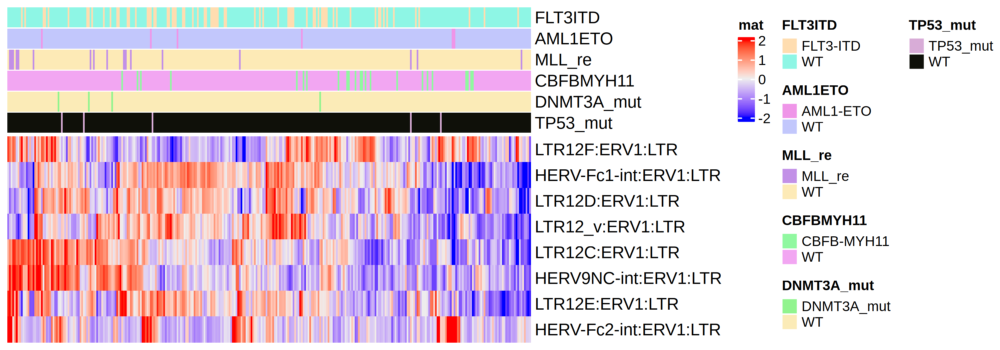

In [1320]:
# significant TEs
options(repr.plot.width = 10, repr.plot.height = 3.5, repr.plot.res = 300)
te_sel = c(deg_te_dt[grepl('herv-fc', gene_id, ignore.case = T) & FDR < 0.1 & batch == 'Batch1', rn],
           deg_te_dt[grepl('ltr12', gene_id, ignore.case = T) & FDR < 0.1 & batch == 'Batch1', rn],
           deg_te_dt[grepl('herv9n', gene_id, ignore.case = T) & FDR < 0.1 & batch == 'Batch1', rn])
te_sel = unique(te_sel)

te_sel

plotdat = logcpm_te_b1[te_sel, dsn_b1$sample_name]

plotdat = scale_fun(plotdat) 
plotdat[plotdat > 2] = 2
plotdat[plotdat < -2] = -2

column_ha = HeatmapAnnotation(df = dsn_b1[, .(FLT3ITD, AML1ETO, MLL_re, CBFBMYH11, DNMT3A_mut, TP53_mut)])
#column_ra = rowAnnotation(df = row_sel[, .(.id)]) 
Heatmap(plotdat, name = "mat", show_column_names = F, show_row_names = T, show_column_dend = F, cluster_columns  = T, 
        cluster_rows = T, # row_split = row_sel$.id, 
        show_row_dend = F , top_annotation = column_ha) #, #left_annotation = column_ra, 
#        column_split = factor(dsn_sel$cell_type, levels = cell_types))  

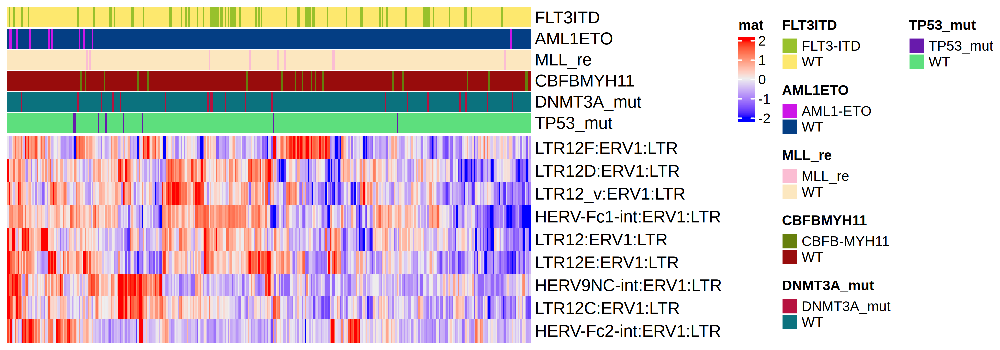

In [1335]:
# significant TEs
options(repr.plot.width = 10, repr.plot.height = 3.5, repr.plot.res = 300)
te_sel = c(deg_te_dt[grepl('herv-fc', gene_id, ignore.case = T) & FDR < 0.1 & batch == 'Batch2', rn],
           deg_te_dt[grepl('ltr12', gene_id, ignore.case = T) & FDR < 0.1 & batch == 'Batch2', rn],
           deg_te_dt[grepl('herv9n', gene_id, ignore.case = T) & FDR < 0.1 & batch == 'Batch2', rn])
te_sel = unique(te_sel)

plotdat = logcpm_te_b2[te_sel, dsn_b2$sample_name]

plotdat = scale_fun(plotdat) 
plotdat[plotdat > 2] = 2
plotdat[plotdat < -2] = -2

column_ha = HeatmapAnnotation(df = dsn_b2[, .(FLT3ITD, AML1ETO, MLL_re, CBFBMYH11, DNMT3A_mut, TP53_mut)])
#column_ra = rowAnnotation(df = row_sel[, .(.id)]) 
Heatmap(plotdat, name = "mat", show_column_names = F, show_row_names = T, show_column_dend = F, cluster_columns  = T, 
        cluster_rows = T, # row_split = row_sel$.id, 
        show_row_dend = F , top_annotation = column_ha) #, #left_annotation = column_ra, 
#        column_split = factor(dsn_sel$cell_type, levels = cell_types))  

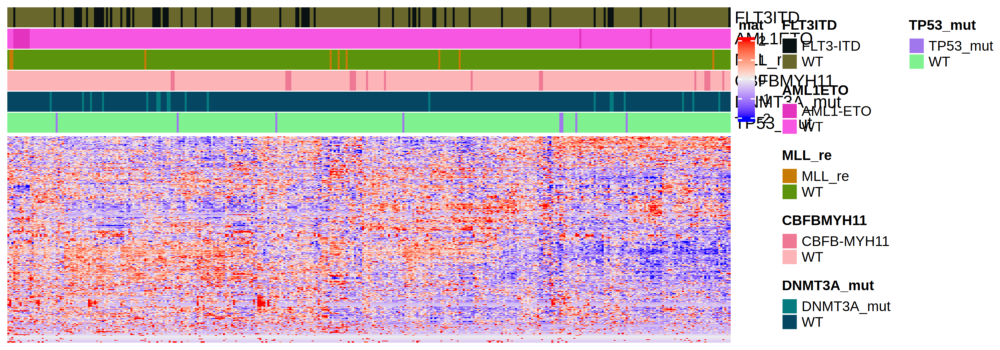

In [1327]:
# significant TEs
options(repr.plot.width = 10, repr.plot.height = 3.5, repr.plot.res = 300)
te_sel = deg_te_dt[abs(logFC) > 1 & FDR < .1, rn]
te_sel = unique(te_sel)

plotdat = logcpm_te_b2[te_sel, dsn_b2$sample_name]

plotdat = scale_fun(plotdat) 
plotdat[plotdat > 2] = 2
plotdat[plotdat < -2] = -2

column_ha = HeatmapAnnotation(df = dsn_b2[, .(FLT3ITD, AML1ETO, MLL_re, CBFBMYH11, DNMT3A_mut, TP53_mut)])
#column_ra = rowAnnotation(df = row_sel[, .(.id)]) 
Heatmap(plotdat, name = "mat", show_column_names = F, show_row_names = F, show_column_dend = F, cluster_columns  = T, 
        cluster_rows = T, # row_split = row_sel$.id, 
        show_row_dend = F , top_annotation = column_ha) 

In [1338]:
te_sel
length(te_sel)

[1] "HERV-Fc2-int:ERV1:LTR" "HERV-Fc1-int:ERV1:LTR" "LTR12C:ERV1:LTR"      
[4] "LTR12:ERV1:LTR"        "LTR12E:ERV1:LTR"       "LTR12_v:ERV1:LTR"     
[7] "LTR12F:ERV1:LTR"       "LTR12D:ERV1:LTR"       "HERV9NC-int:ERV1:LTR"

[1] 9

In [ ]:
te_sel = c('HERV-Fc2-int:ERV1:LTR', 'HERV-Fc1-int:ERV1:LTR', 'LTR12C:ERV1:LTR', 'LTR12:ERV1:LTR', 'LTR12E:ERV1:LTR', 
           'LTR12_v:ERV1:LTR', 'LTR12F:ERV1:LTR', 'LTR12D:ERV1:LTR', 'HERV9NC-int:ERV1:LTR')


In [1334]:
logcpm_te_b2[te_sel, ]

,2000_BA2123,2003_BA2499,2004_BA2846,2008_BA2676,2010_BA2304,2014_BA2226,2015_BA2861,2016_BA2816,2018_BA2950,2019_BA2905,⋯,2566_BA2577,2566_BA2748,2567_BA2511,2568_BA2880,2572_BA2228,2573_BA2791,2574_BA2282,2575_BA2464,2576_BA2636,2577_BA2944
HERV-Fc2-int:ERV1:LTR,3.757905,14.718600,6.219689,6.319484,5.609357,8.349422,6.450213,8.928452,11.887838,6.614805,⋯,8.022167,6.752114,6.291360,6.085763,6.527992,6.486499,5.825609,5.911415,6.214272,9.116195
HERV-Fc1-int:ERV1:LTR,5.023082,6.498972,7.794438,6.619816,5.380971,7.186144,8.777866,6.428760,8.848057,5.699602,⋯,8.959364,7.934135,7.290052,7.069684,4.226948,7.549636,7.118195,8.810631,7.495971,8.524657
LTR12C:ERV1:LTR,10.382711,11.032451,10.969703,11.293679,11.216094,11.188258,12.183572,10.239800,11.780744,10.612339,⋯,10.717811,10.527105,10.370060,11.941502,9.957332,11.218584,10.157897,11.634752,11.149554,12.455535
LTR12:ERV1:LTR,7.302280,7.577842,7.293144,7.750912,7.147072,8.112316,7.908476,7.356301,10.355728,7.735374,⋯,7.929253,7.564379,7.579320,8.037467,6.424362,8.246276,7.656771,7.710053,7.555394,8.377618
LTR12E:ERV1:LTR,9.269924,8.302916,8.418032,7.175471,7.959715,8.281293,9.145396,8.098845,8.957013,9.161786,⋯,9.280986,9.163488,7.763616,7.649247,7.844254,10.058746,7.924254,8.962180,9.059270,10.700389
LTR12_v:ERV1:LTR,6.761117,5.091862,6.671921,5.072853,4.774832,6.825159,8.396831,5.743117,6.655733,6.812408,⋯,9.354298,9.591212,4.711618,4.811023,6.369615,9.041499,5.223744,8.624843,6.420100,9.043006
LTR12F:ERV1:LTR,3.282544,5.252787,4.296596,3.596231,3.709369,5.408329,5.694336,4.832577,8.683392,3.139213,⋯,4.784126,3.874202,6.180538,4.264238,4.650879,4.617098,4.171815,2.568796,4.843211,4.297073
LTR12D:ERV1:LTR,6.709701,5.397549,5.448230,4.415186,4.338302,6.223152,6.819033,3.996398,5.172250,6.052161,⋯,7.194370,6.542896,5.929537,5.649886,4.650879,6.150949,5.399325,6.448177,7.335732,5.790355
HERV9NC-int:ERV1:LTR,5.023082,2.568796,5.201647,3.923584,4.338302,3.014765,6.752429,2.568796,6.015175,3.139213,⋯,3.503101,4.135389,3.551431,7.649247,3.190818,5.431223,3.963983,5.911415,2.568796,6.633210


In [1339]:
dim(logcpm_te_b2)

[1] 1310  359

Warning message in .filterFeatures(expr, method):
"173 genes with constant expression values throuhgout the samples."
Warning message in .filterFeatures(expr, method):
"Since argument method!="ssgsea", genes with constant expression values are discarded."


Estimating GSVA scores for 1 gene sets.
Estimating ECDFs with Gaussian kernels
  |======================================================================| 100%



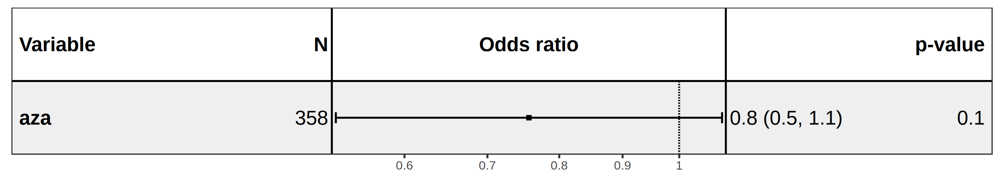

In [1350]:
res = gsva(expr = as.matrix(logcpm_te_b2), list(aza = te_sel))
res = as.data.table(t( res ), keep.rownames = T)

res = merge(dsn_b2, res, by.x = 'sample_name', by.y = 'rn', all.x = T)

res[, OS_STATUS := as.numeric(OS_Stat) ]
res[, OS_MONTHS := as.numeric(OS_Month) ]
plotdat = copy(res)

dependent_os  <- "Surv(OS_MONTHS, OS_STATUS)"
vars = 'aza'
for(var in vars){
    fm = as.formula(paste0(dependent_os, ' ~ ', var ))
    mylogit = coxph(fm, data = plotdat)
    options(repr.plot.width = 10, repr.plot.height = 1.8, repr.plot.res = 300)
    mm = forest_model(mylogit, recalculate_width = F, exponentiate = T, panels = panels,
             format_options = forest_model_format_options(text_size = 5, point_size = 1.5, banded = TRUE))
    print(mm)
}



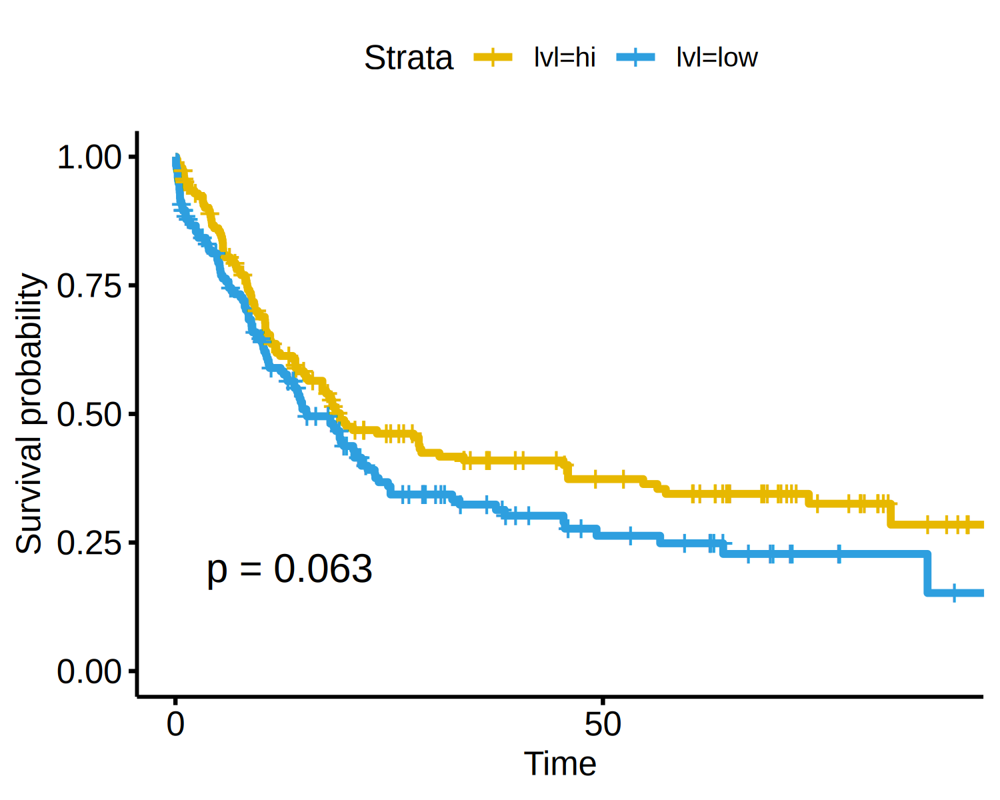

In [1351]:
plotdat = copy(res)
plotdat[, lvl := 'low' ]
plotdat[aza > mean(plotdat$aza, na.rm = T), lvl := 'hi' ]
fit <- survfit(Surv(OS_MONTHS, OS_STATUS) ~ lvl, data = plotdat)
options(repr.plot.width = 5, repr.plot.height = 4, repr.plo.res = 300)
ggsurvplot(fit, data = plotdat,
           size = 1,                 # change line size
           palette =  c("#E7B800", "#2E9FDF"),# custom color palettes
           pval = TRUE,              # Add p-value
           ggtheme = theme_pubr(), xlim = c(0, 90))      # Change ggplot2 theme



# combine batch 2 with blueprint data

In [1302]:
tmp = tecount_gdc_df[! rownames(tecount_gdc_df) %in% coding_genes, dsn_b2$sample_name]
dim(tmp)

[1] 1310  359

In [1303]:
mtx = readRDS('/research_jude/rgs01_jude/groups/jxugrp/home/common/Lab_Members/WenhuoHu/collab_Farhan/data/mtx_all_df.rds')
hsc_sel = c('HSC1', 'HSC2', 'HSC3', 'CMP1', 'CMP2', 'CMP3', 'GMP1', 'GMP2', 'GMP3')
mtx = mtx[rownames(tmp), hsc_sel]
mtx = cbind(mtx, tmp) 


In [1305]:
dim(mtx)
head2(mtx)

[1] 1310  368

,HSC1,HSC2,HSC3,CMP1,CMP2
,<int>,<int>,<int>,<int>,<int>
(CATTC)n:Satellite:Satellite,3487,263,704,1,0
(GAATG)n:Satellite:Satellite,8554,416,1777,1,0
7SLRNA:srpRNA:srpRNA,0,17,10,59,20


In [1306]:
dsn_dat = data.table(rn = colnames(mtx))
dsn_dat[, group := 'pAML' ]
dsn_dat[rn %in% hsc_sel, group := 'HSPC' ]
dsn_dat_df = setDF(dsn_dat[, 2:ncol(dsn_dat)], rownames = dsn_dat$rn)
head(dsn_dat_df)


,group
,<chr>
HSC1,HSPC
HSC2,HSPC
HSC3,HSPC
CMP1,HSPC
CMP2,HSPC
CMP3,HSPC


In [1289]:
row_sum = rowSums(mtx)
mtx = mtx[row_sum > 0, ]

In [1308]:
mtx_combat <- ComBat_seq(as.matrix(mtx), batch=dsn_dat_df$group)


Found 2 batches
Using null model in ComBat-seq.
Adjusting for 0 covariate(s) or covariate level(s)
Estimating dispersions
Fitting the GLM model
Shrinkage off - using GLM estimates for parameters
Adjusting the data


In [1309]:
logcpm_mtx = cpm_fun(mtx_combat) 

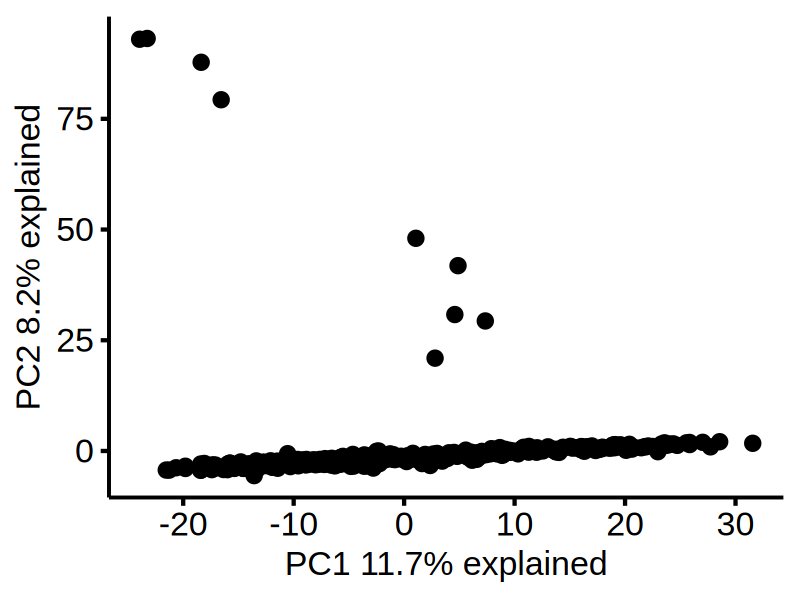

In [1310]:
pc <- prcomp(t(logcpm_mtx), center = TRUE, scale = TRUE)
lblx = paste0('PC1 ', round(100 * pc$sdev[1]^2/sum(pc$sdev^2), 1), '% explained') 
lbly = paste0('PC2 ', round(100 * pc$sdev[2]^2/sum(pc$sdev^2), 1), '% explained') 
plotdat = as.data.table(pc$x, keep.rownames = T)
#plotdat = merge(plotdat, dsn[, .(sample_name, subtype)], by.x = 'rn', by.y = 'sample_name')
options(repr.plot.width = 4, repr.plot.height = 3, repr.plot.res = 200)
ggscatter(plotdat, x = 'PC1', y = 'PC2') + xlab(lblx) + ylab(lbly)


In [1311]:
sel = deg_MEPCMP[batch == 'CMP' & abs(logFC) > 2 & FDR < 0.1 & class_id %in% c('LTR', 'LINE', 'DNA'), ][!duplicated(rn), ]
te_sel = unique(sel$rn)
row_ann = setDF(sel[, .(class_id)], rownames = sel$rn) 
dim(sel)
head(sel) 


[1] 78 11

.id,rn,logFC,logCPM,PValue,FDR,batch,target,class_id,family_id,gene_id
<chr>,<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<chr>,<chr>,<chr>,<chr>,<chr>
deg_CMP_HSC,HERV15-int:ERV1:LTR,3.502005,9.056600,2.279907e-20,2.485099e-17,CMP,HSC,LTR,ERV1,HERV15-int
deg_CMP_HSC,MER57E3:ERV1:LTR,2.167897,9.022278,3.704360e-14,1.345918e-11,CMP,HSC,LTR,ERV1,MER57E3
deg_CMP_HSC,L1MC:L1:LINE,2.362232,12.960150,1.535140e-11,2.091629e-09,CMP,HSC,LINE,L1,L1MC
deg_CMP_HSC,MER92D:ERV1:LTR,-12.146534,4.180275,3.142438e-09,1.902921e-07,CMP,HSC,LTR,ERV1,MER92D
deg_CMP_HSC,LTR13:ERVK:LTR,2.324998,9.673527,4.882078e-09,2.800771e-07,CMP,HSC,LTR,ERVK,LTR13
deg_CMP_HSC,LTR53B:ERVL:LTR,-12.110903,4.144844,6.639166e-09,3.435240e-07,CMP,HSC,LTR,ERVL,LTR53B


In [1366]:
mtx = readRDS('/research_jude/rgs01_jude/groups/jxugrp/home/common/Lab_Members/WenhuoHu/collab_Farhan/data/mtx_all_df.rds')
hsc_sel = c('HSC1', 'HSC2', 'HSC3', 'CMP1', 'CMP2', 'CMP3', 'GMP1', 'GMP2', 'GMP3')
mtx = mtx[rownames(tmp), hsc_sel]
head(mtx)

,HSC1,HSC2,HSC3,CMP1,CMP2,CMP3,GMP1,GMP2,GMP3
,<int>,<int>,<int>,<int>,<int>,<int>,<int>,<int>,<int>
(CATTC)n:Satellite:Satellite,3487,263,704,1,0,3,5778,11,1
(GAATG)n:Satellite:Satellite,8554,416,1777,1,0,4,15644,44,0
7SLRNA:srpRNA:srpRNA,0,17,10,59,20,0,1,106,2
A-rich:Low_complexity:Low_complexity,0,5,3,0,0,0,0,0,0
ACRO1:acro:Satellite,206,11,39,0,0,0,16,0,0
ALR/Alpha:centr:Satellite,46722,52583,53688,5207,1482,2139,47722,9287,4586


In [ ]:
plotdat = logcpm_fun(mtx)
plotdat[cmp_up_LTR, ] 
plotdat = scale_fun(plotdat)
plotdat[plotdat > 2] = 2
plotdat[plotdat < -2] = -2
dim(plotdat)
column_ha = HeatmapAnnotation(df = dsn_dat_df)
row_ha = rowAnnotation(df = row_ann)
args = list(matrix = plotdat, top_annotation = column_ha, left_annotation = row_ha,
            column_split = factor(dsn_dat_df$group), show_column_names = F, 
            show_row_names = F, show_column_dend = F, cluster_columns = T, 
            cluster_rows = T, row_names_gp = grid::gpar(fontsize = 7), row_split = row_ann$class_id,
            show_row_dend = F, column_title_rot = 90)
hp = do.call(Heatmap, args)
options(repr.plot.width = 21, repr.plot.height = 8, repr.plot.res = 200)
draw(hp)


[1]  78 368

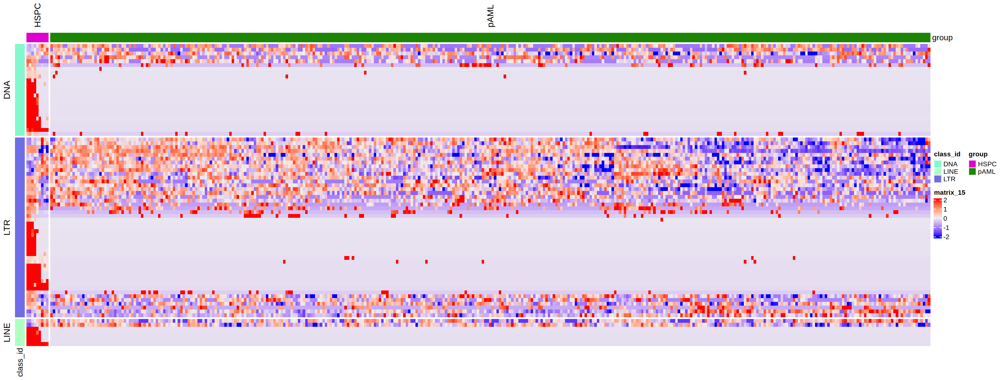

In [1312]:
plotdat = logcpm_mtx[te_sel, rownames(dsn_dat_df)]
plotdat = scale_fun(plotdat)
plotdat[plotdat > 2] = 2
plotdat[plotdat < -2] = -2
dim(plotdat)
column_ha = HeatmapAnnotation(df = dsn_dat_df)
row_ha = rowAnnotation(df = row_ann)
args = list(matrix = plotdat, top_annotation = column_ha, left_annotation = row_ha,
            column_split = factor(dsn_dat_df$group), show_column_names = F, 
            show_row_names = F, show_column_dend = F, cluster_columns = T, 
            cluster_rows = T, row_names_gp = grid::gpar(fontsize = 7), row_split = row_ann$class_id,
            show_row_dend = F, column_title_rot = 90)
hp = do.call(Heatmap, args)
options(repr.plot.width = 21, repr.plot.height = 8, repr.plot.res = 200)
draw(hp)


In [1316]:
res = deg_fun2(dsn_dat_df, mtx_combat)
res[, class_id := unlist(strsplit(rn, ':'))[3], by = 1:nrow(res) ]

In [1314]:
head(res)

rn,logFC,logCPM,PValue,FDR
<chr>,<dbl>,<dbl>,<dbl>,<dbl>
HERV9N-int:ERV1:LTR,-8.695295,2.493928,0.000000e+00,0.000000e+00
LTR71A:ERV1:LTR,-8.465296,2.389113,0.000000e+00,0.000000e+00
X13_LINE:L2:LINE,-7.368999,1.946641,0.000000e+00,0.000000e+00
Eulor9A:DNA:DNA,-8.068348,2.217558,2.250150e-285,7.369243e-283
UCON6:Unknown:Unknown,-8.018471,2.197171,4.067799e-260,1.065763e-257
UCON4:Kolobok:DNA,-7.920077,2.156353,2.789345e-247,6.090070e-245


In [1318]:
dim(res)

[1] 1310    6

[1] 149 368

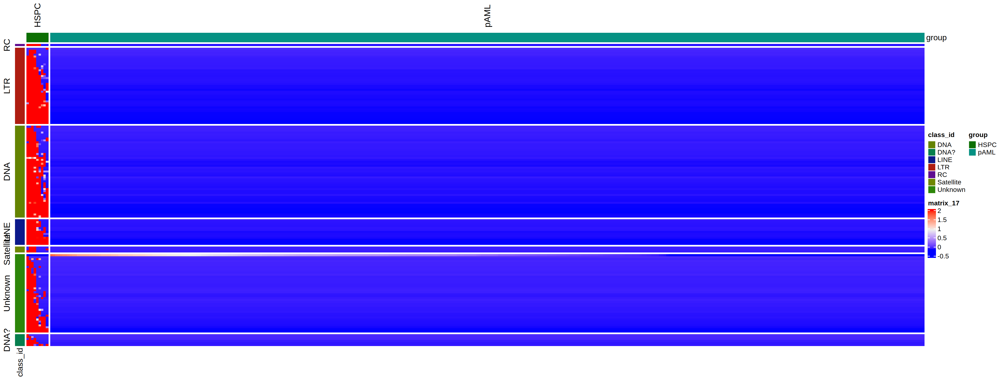

In [1319]:
sel = res[abs(logFC) > 1 & FDR < 0.1, ]
te_sel = sel$rn
row_ann = data.frame(class_id = sel$class_id, row.names = sel$rn)
plotdat = logcpm_mtx[te_sel, rownames(dsn_dat_df)]
plotdat = scale_fun(plotdat)
plotdat[plotdat > 2] = 2
plotdat[plotdat < -2] = -2
dim(plotdat)
column_ha = HeatmapAnnotation(df = dsn_dat_df)
row_ha = rowAnnotation(df = row_ann)
args = list(matrix = plotdat, top_annotation = column_ha, left_annotation = row_ha,
            column_split = factor(dsn_dat_df$group), show_column_names = F, 
            show_row_names = F, show_column_dend = F, cluster_columns = T, 
            cluster_rows = T, row_names_gp = grid::gpar(fontsize = 7), row_split = row_ann$class_id,
            show_row_dend = F, column_title_rot = 90)
hp = do.call(Heatmap, args)
options(repr.plot.width = 21, repr.plot.height = 8, repr.plot.res = 200)
draw(hp)


# CMP related TE signature score

## survival

In [1158]:
 panels <- list(forest_panel(width = 0.01), 
               forest_panel(width = 0.23, display = variable, fontface = "bold", heading = "Variable"), 
               forest_panel(width = 0.1, display = level), 
               forest_panel(width = 0.07, display = n, hjust = 1, heading = "N"), 
               forest_panel(width = 0.01, item = "vline", hjust = 0.5), 
               forest_panel(width = 0.5, item = "forest", hjust = 0.5, heading = "Odds ratio", linetype = "dashed", line_x = 0), 
               forest_panel(width = 0.01, item = "vline", hjust = 0.5), 
               forest_panel(width = 0.23, display = ifelse(reference, "Reference", paste0(
                   format(round(trans(estimate),1), digits = 2, scientific = F, trim = F), ' (', 
                   format(round(trans(conf.low),1), digits = 2, scientific = F, trim = F), ', ', 
                   format(round(trans(conf.high),1), digits = 2, scientific = F, trim = F), ')')), display_na = NA), 
               #forest_panel(width = 0.32, display = ifelse(reference, "Reference", sprintf("%0.2f (%0.2f, %0.2f)", trans(estimate), trans(conf.low), trans(conf.high))), display_na = NA), 

               forest_panel(width = 0.1, display = ifelse(reference, "", format.pval(p.value, digits = 1, eps = 0.001)), display_na = NA, hjust = 1, heading = "p-value"), 
               forest_panel(width = 0.01))


In [1118]:
sel = unique(deg_MEPCMP[batch == 'CMP' & logFC < -2 & FDR < 0.1, ])
table(sel$class_id)



 DNA LINE  LTR 
  21    7   39 

In [1251]:
cmp_up_DNA_LTR_LINE = unique(deg_MEPCMP[batch == 'CMP' & logFC > 2 & FDR < 0.1 & class_id %in% c('DNA', 'LTR', 'LINE'), rn])
cmp_up_DNA_LINE = unique(deg_MEPCMP[batch     == 'CMP' & logFC > 2 & FDR < 0.1 & class_id %in% c('DNA', 'LINE'), rn])
cmp_up_DNA_LTR = unique(deg_MEPCMP[batch      == 'CMP' & logFC > 2 & FDR < 0.1 & class_id %in% c('DNA', 'LTR'), rn])
cmp_up_LINE = unique(deg_MEPCMP[batch         == 'CMP' & logFC > 2 & FDR < 0.1 & class_id %in% c('LINE'), rn])
cmp_up_LTR = unique(deg_MEPCMP[batch          == 'CMP' & logFC > 2 & FDR < 0.1 & class_id %in% c('LTR'), rn])
cmp_up_DNA = unique(deg_MEPCMP[batch          == 'CMP' & logFC > 2 & FDR < 0.1 & class_id %in% c('DNA'), rn])

cmp_dn_DNA_LTR_LINE = unique(deg_MEPCMP[batch == 'CMP' & logFC < -2 & FDR < 0.1 & class_id %in% c('DNA', 'LTR', 'LINE'), rn])
cmp_dn_DNA_LINE = unique(deg_MEPCMP[batch     == 'CMP' & logFC < -2 & FDR < 0.1 & class_id %in% c('DNA', 'LINE'), rn])
cmp_dn_DNA_LTR = unique(deg_MEPCMP[batch      == 'CMP' & logFC < -2 & FDR < 0.1 & class_id %in% c('DNA', 'LTR'), rn])
cmp_dn_LINE = unique(deg_MEPCMP[batch         == 'CMP' & logFC < -2 & FDR < 0.1 & class_id %in% c('LINE'), rn])
cmp_dn_LTR = unique(deg_MEPCMP[batch          == 'CMP' & logFC < -2 & FDR < 0.1 & class_id %in% c('LTR'), rn])
cmp_dn_DNA = unique(deg_MEPCMP[batch          == 'CMP' & logFC < -2 & FDR < 0.1 & class_id %in% c('DNA'), rn])

gset = list(cmp_up_DNA_LTR_LINE = cmp_up_DNA_LTR_LINE, cmp_up_DNA_LINE = cmp_up_DNA_LINE, cmp_up_DNA_LTR = cmp_up_DNA_LTR, 
            cmp_up_LINE = cmp_up_LINE, cmp_up_LTR = cmp_up_LTR, cmp_up_DNA = cmp_up_DNA,
            cmp_dn_DNA_LTR_LINE = cmp_dn_DNA_LTR_LINE, cmp_dn_DNA_LINE = cmp_dn_DNA_LINE, cmp_dn_DNA_LTR = cmp_dn_DNA_LTR, 
            cmp_dn_LINE = cmp_dn_LINE, cmp_dn_LTR = cmp_dn_LTR, cmp_dn_DNA = cmp_dn_DNA)
vars = names(gset)


Warning message in .filterFeatures(expr, method):
"174 genes with constant expression values throuhgout the samples."
Warning message in .filterFeatures(expr, method):
"Since argument method!="ssgsea", genes with constant expression values are discarded."


Estimating GSVA scores for 11 gene sets.
Estimating ECDFs with Gaussian kernels
  |======================================================================| 100%



rn,cmp_up_DNA_LTR_LINE,cmp_up_DNA_LINE,cmp_up_DNA_LTR,cmp_up_LINE,cmp_up_LTR,cmp_up_DNA,cmp_dn_DNA_LTR_LINE,cmp_dn_DNA_LINE,cmp_dn_DNA_LTR,cmp_dn_LTR,cmp_dn_DNA
<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
2005_BA2802,-0.237135809,-0.16605605,-0.2253244,-0.3188168,-0.2898467,-0.099735216,-0.1490807,0.2151138,-0.1490807,-0.2550828,0.2151138
2009_BA3322,-0.074401917,0.31049956,-0.2265690,0.5590829,-0.2853676,0.227254121,0.1902152,0.1975199,0.1902152,0.2159725,0.1975199
2013_BA2195,0.172023605,0.02506519,0.1583651,0.3191318,0.1995609,-0.196680784,-0.1712315,0.1237858,-0.1712315,-0.2058908,0.1237858
2017_BA2156,0.336793367,0.02323718,0.3066312,0.2642311,0.3925848,-0.255781544,0.3912592,0.6391782,0.3912592,0.3330641,0.6391782
2025_BA2461,0.009334421,-0.32713900,0.2018247,-0.7540517,0.3039608,0.001039501,-0.1168381,0.2322784,-0.1168381,-0.1893363,0.2322784
2031_BA2501,0.332485562,0.51093094,0.4299379,-0.2774873,0.2438703,0.789755608,-0.2832850,-0.2125775,-0.2832850,-0.2941477,-0.2125775


Resized limits to included dashed line in forest panel



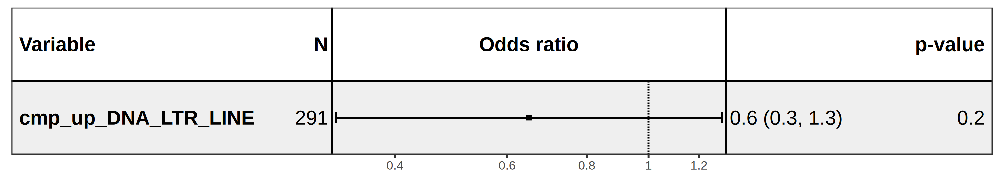

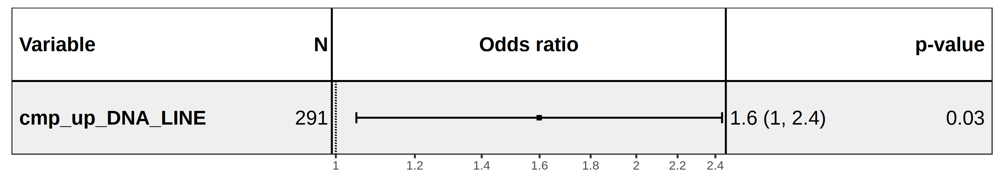

Resized limits to included dashed line in forest panel



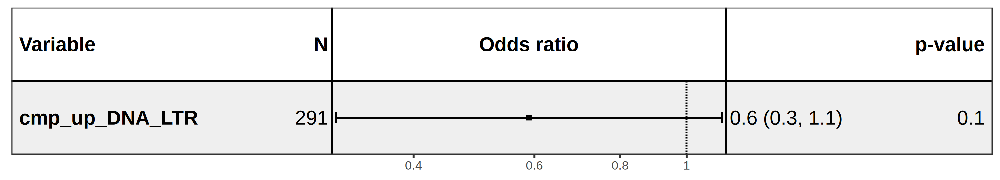

Resized limits to included dashed line in forest panel



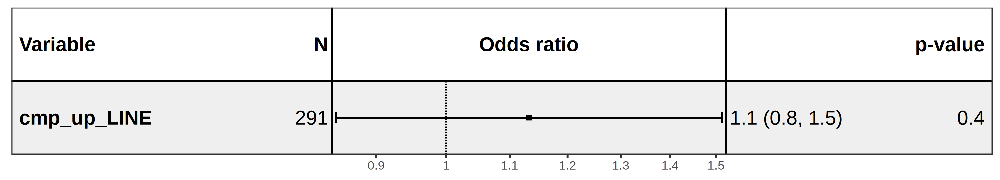

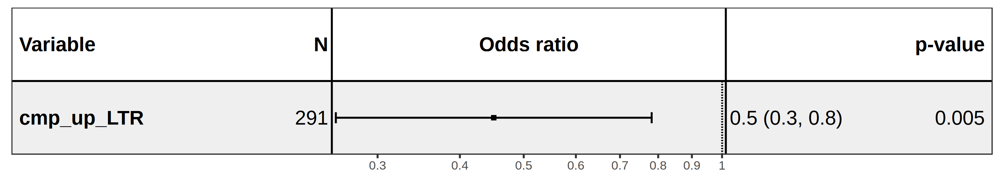

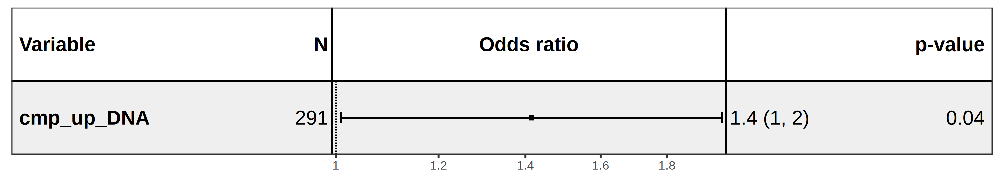

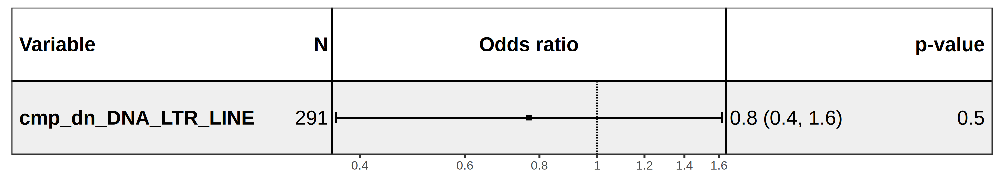

ERROR: Error in model.frame.default(formula = Surv(OS_MONTHS, OS_STATUS) ~ cmp_dn_LINE, : variable lengths differ (found for 'cmp_dn_LINE')


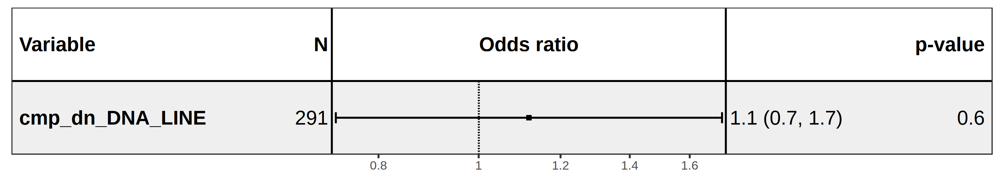

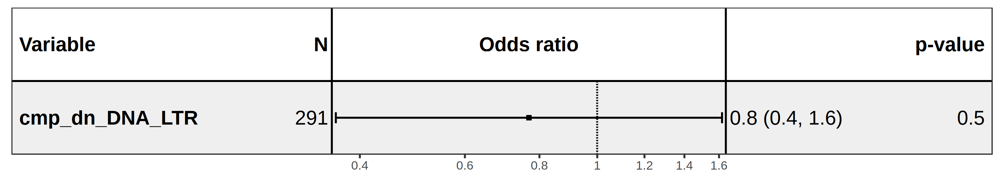

In [1252]:
gsva_res = gsva(expr = as.matrix(logcpm_te_b1), gset)
gsva_res = as.data.table(t(gsva_res), keep.rownames = T)
head(gsva_res)

dsn_CMP_TE_score_b1 = merge(dsn_b1, gsva_res, by.x = 'sample_name', by.y = 'rn', all.x = T)

dsn_CMP_TE_score_b1[, OS_STATUS := as.numeric(OS_Stat) ]
dsn_CMP_TE_score_b1[, OS_MONTHS := as.numeric(OS_Month) ]
plotdat = dsn_CMP_TE_score_b1

dependent_os  <- "Surv(OS_MONTHS, OS_STATUS)"

for(var in vars){
    fm = as.formula(paste0(dependent_os, ' ~ ', var ))
    mylogit = coxph(fm, data = plotdat)
    options(repr.plot.width = 10, repr.plot.height = 1.8, repr.plot.res = 300)
    mm = forest_model(mylogit, recalculate_width = F, exponentiate = T, panels = panels,
             format_options = forest_model_format_options(text_size = 5, point_size = 1.5, banded = TRUE))
    print(mm)
}



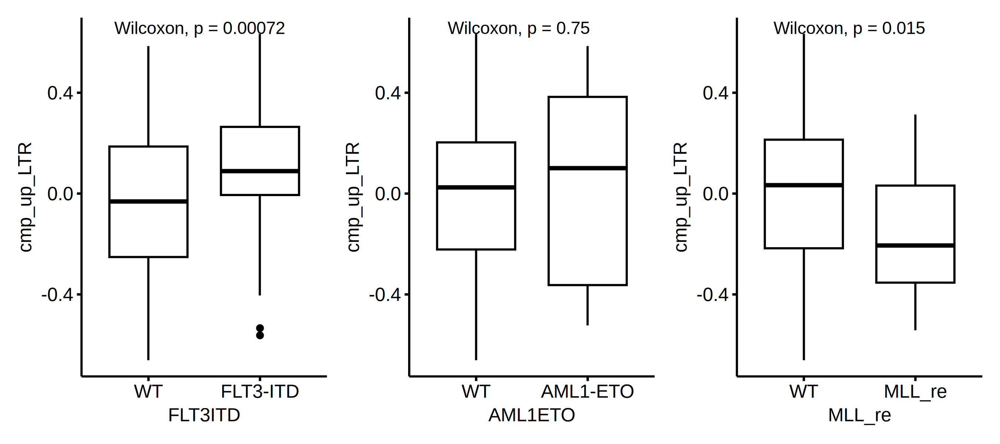

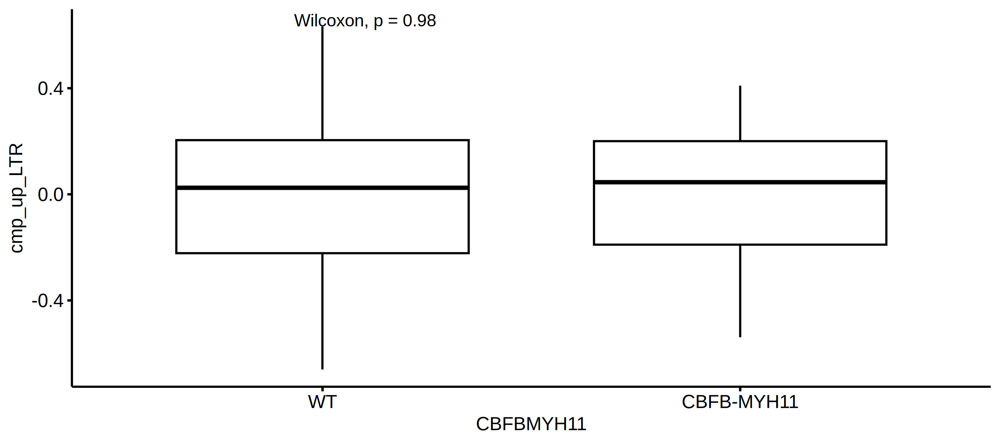

In [1257]:
plotdat = copy(dsn_CMP_TE_score_b1)
options(repr.plot.width = 9, repr.plot.height = 4, repr.plo.res = 300)
ggboxplot(plotdat, x = 'FLT3ITD', y = 'cmp_up_LTR' ) + stat_compare_means() | 
ggboxplot(plotdat, x = 'AML1ETO', y = 'cmp_up_LTR' ) + stat_compare_means() |
ggboxplot(plotdat, x = 'MLL_re',  y = 'cmp_up_LTR' )  + stat_compare_means() 
ggboxplot(plotdat, x = 'CBFBMYH11',  y = 'cmp_up_LTR' )  + stat_compare_means()
#ggboxplot(logcpm_beat_t, x = 'MLL_re', y = 'relapse', add = 'dotplot', add.params = list(color = 'grey', alpha = 0.5)) + stat_compare_means() 


In [1360]:
library(Hmisc)
library(gtools)


In [1365]:
cmp_up_LTR

[1] "HERV15-int:ERV1:LTR"  "MER57E3:ERV1:LTR"     "LTR13:ERVK:LTR"      
 [4] "LTR13A:ERVK:LTR"      "HERV1_I:ERV1:LTR"     "HERVS71-int:ERV1:LTR"
 [7] "LTR5_Hs:ERVK:LTR"     "HERV1_LTRa:ERV1:LTR"  "LTR6A:ERV1:LTR"      
[10] "LTR7Y:ERV1:LTR"       "MER83B:ERV1:LTR"      "LTR21B:ERV1:LTR"

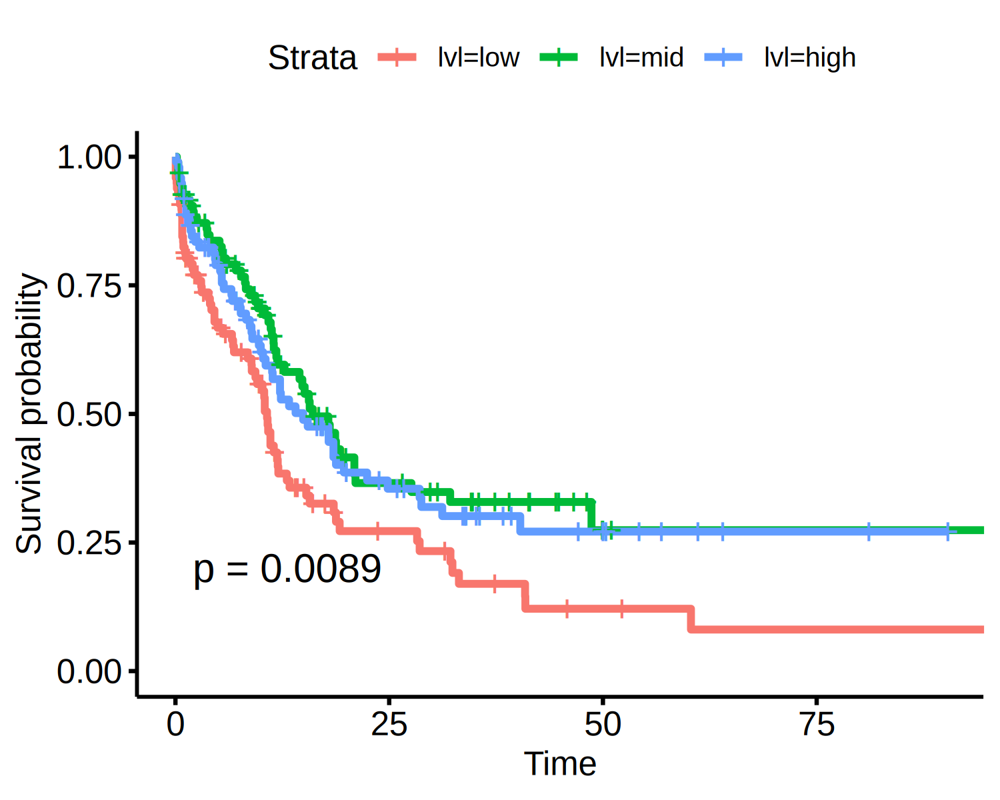

In [1364]:
plotdat = copy(dsn_CMP_TE_score_b1)
plotdat$lvl = quantcut(dsn_CMP_TE_score_b1$cmp_up_LTR,  q = c(0, 0.33, 0.66, 1),  labels = c("low", "mid", "high"))
fit <- survfit(Surv(OS_MONTHS, OS_STATUS) ~ lvl, data = plotdat)
options(repr.plot.width = 5, repr.plot.height = 4, repr.plo.res = 300)
ggsurvplot(fit, data = plotdat,
           size = 1,                 # change line size
           pval = TRUE,              # Add p-value
           ggtheme = theme_pubr(), xlim = c(0, 90))      # Change ggplot2 theme



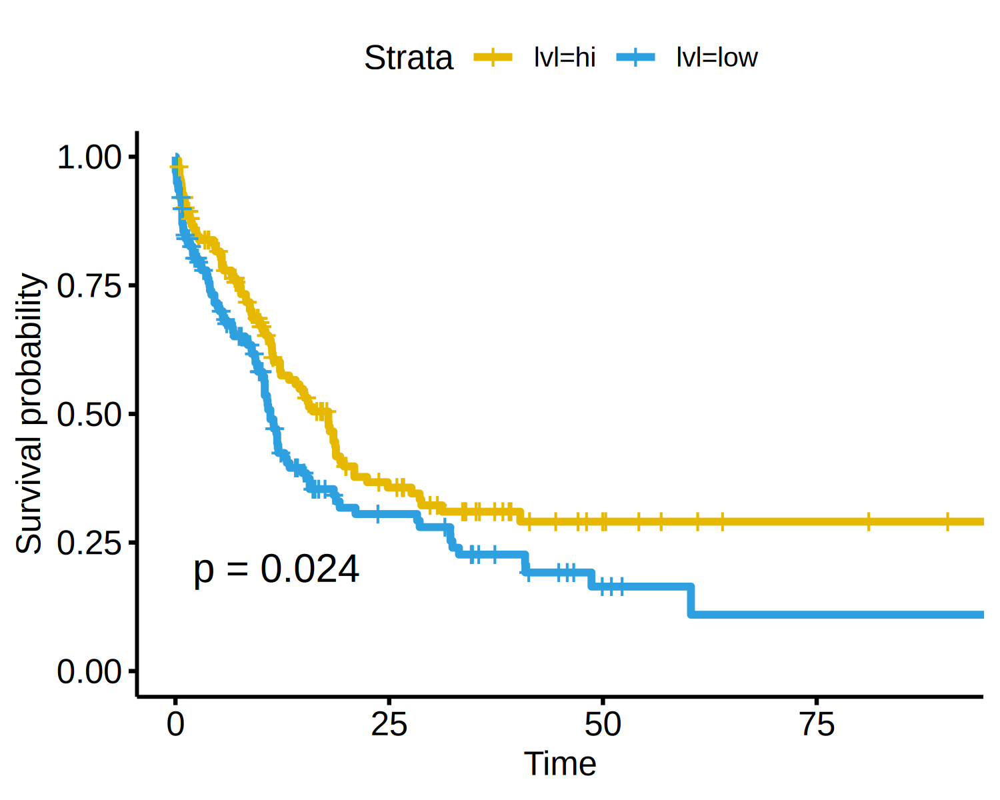

In [1260]:
plotdat = copy(dsn_CMP_TE_score_b1)
plotdat[, lvl := 'low' ]
plotdat[cmp_up_LTR > mean(plotdat$cmp_up_LTR, na.rm = T), lvl := 'hi' ]
fit <- survfit(Surv(OS_MONTHS, OS_STATUS) ~ lvl, data = plotdat)
options(repr.plot.width = 5, repr.plot.height = 4, repr.plo.res = 300)
ggsurvplot(fit, data = plotdat,
           size = 1,                 # change line size
           palette =  c("#E7B800", "#2E9FDF"),# custom color palettes
           pval = TRUE,              # Add p-value
           ggtheme = theme_pubr(), xlim = c(0, 90))      # Change ggplot2 theme



In [ ]:
# batch2 is wave1/2, is based on poly-A selection 

In [646]:
library(forestmodel)


In [1170]:
cmp_up_LTR

[1] "HERV15-int:ERV1:LTR"  "MER57E3:ERV1:LTR"     "LTR13:ERVK:LTR"      
 [4] "LTR13A:ERVK:LTR"      "HERV1_I:ERV1:LTR"     "HERVS71-int:ERV1:LTR"
 [7] "LTR5_Hs:ERVK:LTR"     "HERV1_LTRa:ERV1:LTR"  "LTR6A:ERV1:LTR"      
[10] "LTR7Y:ERV1:LTR"       "MER83B:ERV1:LTR"      "LTR21B:ERV1:LTR"

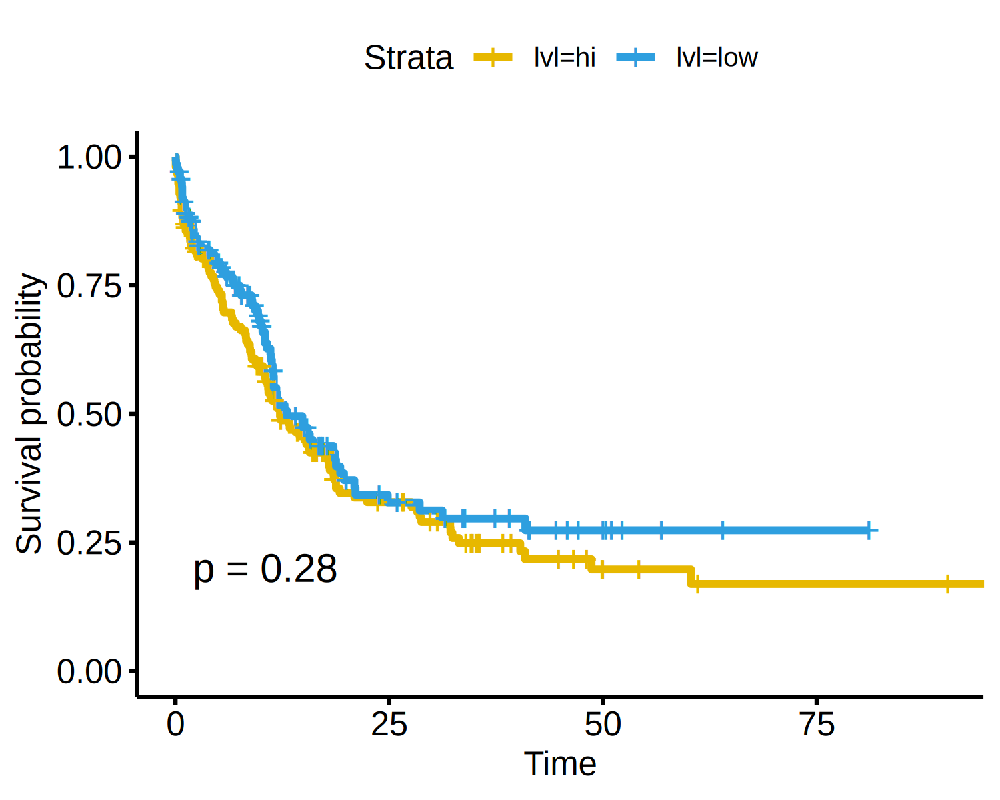

In [1274]:
plotdat = copy(dsn_CMP_TE_score_b1)
plotdat[, lvl := 'low' ]
plotdat[cmp_dn_DNA > mean(plotdat$cmp_dn_DNA, na.rm = T), lvl := 'hi' ]
fit <- survfit(Surv(OS_MONTHS, OS_STATUS) ~ lvl, data = plotdat)
options(repr.plot.width = 5, repr.plot.height = 4, repr.plo.res = 300)
ggsurvplot(fit, data = plotdat,
           size = 1,                 # change line size
           palette =  c("#E7B800", "#2E9FDF"),# custom color palettes
           pval = TRUE,              # Add p-value
#           legend.labs =  c("TE low in CMP", "TE High in HSC"),    # Change legend labels
           ggtheme = theme_pubr(), xlim = c(0, 90))      # Change ggplot2 theme



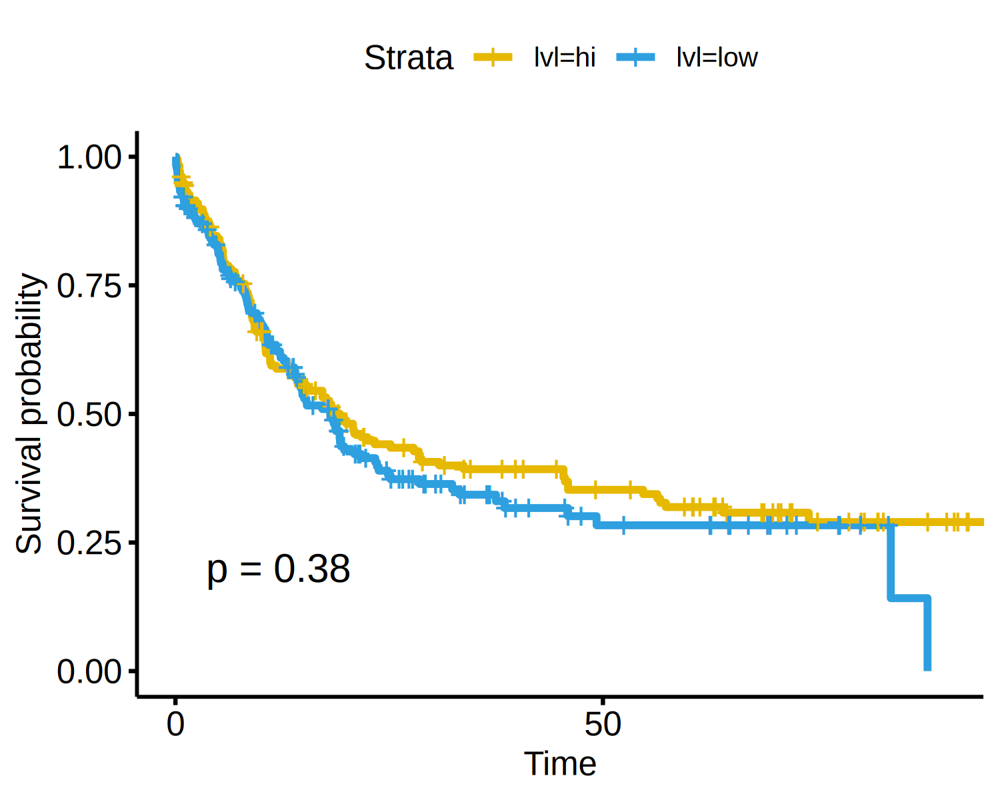

In [1278]:
plotdat = copy(dsn_CMP_TE_score_b2)
plotdat[, lvl := 'low' ]
plotdat[cmp_dn_DNA_LTR > mean(plotdat$cmp_dn_DNA_LTR, na.rm = T), lvl := 'hi' ]
fit <- survfit(Surv(OS_MONTHS, OS_STATUS) ~ lvl, data = plotdat)
options(repr.plot.width = 5, repr.plot.height = 4, repr.plo.res = 300)
ggsurvplot(fit, data = plotdat,
           size = 1,                 # change line size
           palette =  c("#E7B800", "#2E9FDF"),# custom color palettes
           pval = TRUE,              # Add p-value
#           legend.labs =  c("TE low in CMP", "TE High in HSC"),    # Change legend labels
           ggtheme = theme_pubr(), xlim = c(0, 90))      # Change ggplot2 theme



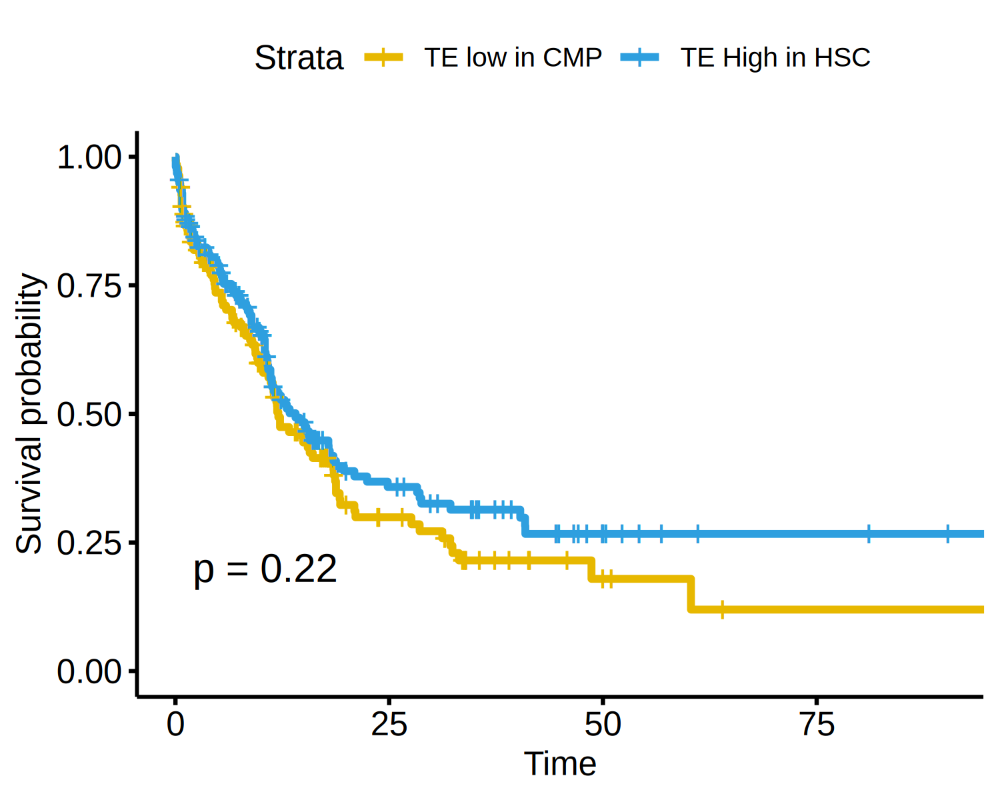

In [1193]:
plotdat[, lvl := 'low' ]
plotdat[cmp_up_DNA > mean(plotdat$cmp_up_DNA, na.rm = T), lvl := 'hi' ]
fit <- survfit(Surv(OS_MONTHS, OS_STATUS) ~ lvl, data = plotdat)
options(repr.plot.width = 5, repr.plot.height = 4, repr.plo.res = 300)
ggsurvplot(fit, data = plotdat,
           size = 1,                 # change line size
           palette =  c("#E7B800", "#2E9FDF"),# custom color palettes
           pval = TRUE,              # Add p-value
           legend.labs =  c("TE low in CMP", "TE High in HSC"),    # Change legend labels
           ggtheme = theme_pubr(), xlim = c(0, 90))      # Change ggplot2 theme



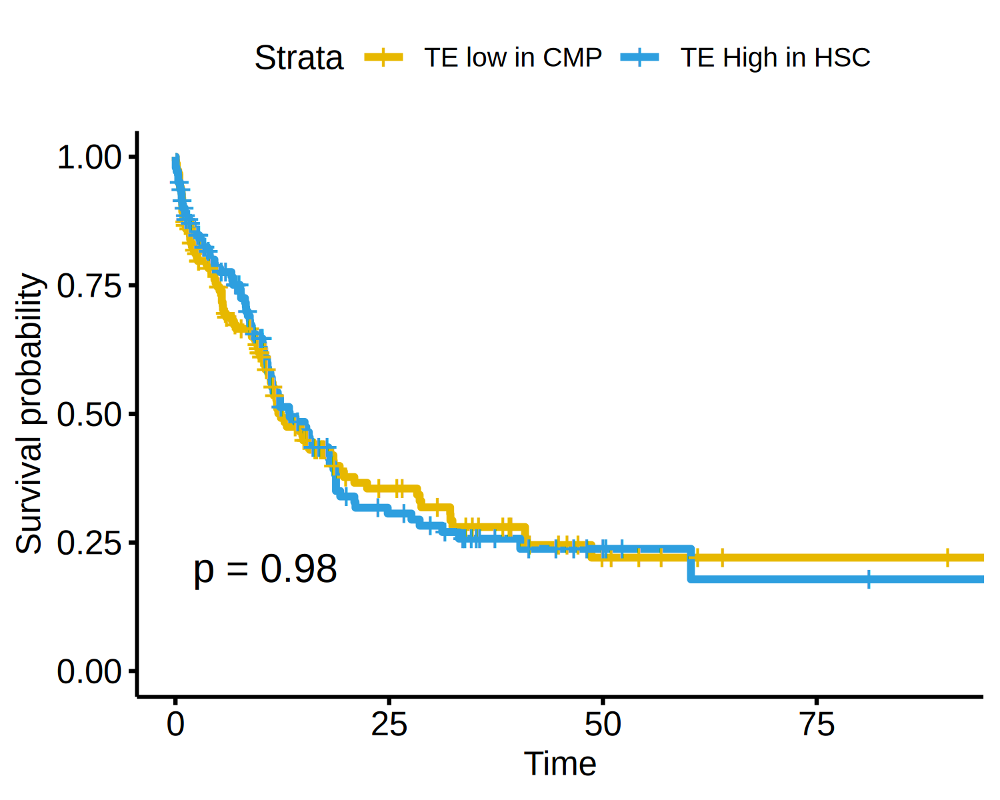

In [1194]:
plotdat[, lvl := 'low' ]
plotdat[cmp_up_LINE > mean(plotdat$cmp_up_LINE, na.rm = T), lvl := 'hi' ]
fit <- survfit(Surv(OS_MONTHS, OS_STATUS) ~ lvl, data = plotdat)
options(repr.plot.width = 5, repr.plot.height = 4, repr.plo.res = 300)
ggsurvplot(fit, data = plotdat,
           size = 1,                 # change line size
           palette =  c("#E7B800", "#2E9FDF"),# custom color palettes
           pval = TRUE,              # Add p-value
           legend.labs =  c("TE low in CMP", "TE High in HSC"),    # Change legend labels
           ggtheme = theme_pubr(), xlim = c(0, 90))      # Change ggplot2 theme



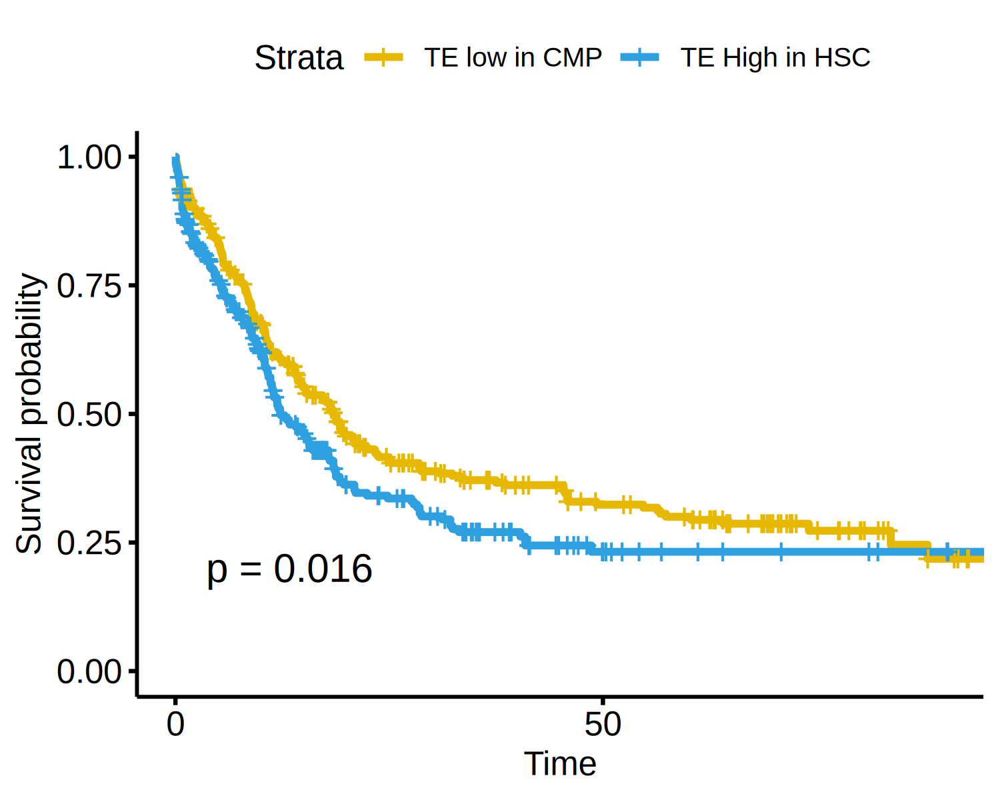

In [648]:
plotdat[, OS_STATUS := as.numeric(OS_Stat) ]
plotdat[, OS_MONTHS := as.numeric(OS_Month) ]
plotdat[, lvl := 'low' ]
plotdat[cmp_dn_DNA_LINE > mean(plotdat$cmp_dn_DNA_LINE, na.rm = T), lvl := 'hi' ]
fit <- survfit(Surv(OS_MONTHS, OS_STATUS) ~ lvl, data = plotdat)
options(repr.plot.width = 5, repr.plot.height = 4, repr.plo.res = 300)
ggsurvplot(fit, data = plotdat,
           size = 1,                 # change line size
           palette =  c("#E7B800", "#2E9FDF"),# custom color palettes
           pval = TRUE,              # Add p-value
           legend.labs =  c("TE low in CMP", "TE High in HSC"),    # Change legend labels
           ggtheme = theme_pubr(), xlim = c(0, 90))      # Change ggplot2 theme



Warning message in .filterFeatures(expr, method):
"173 genes with constant expression values throuhgout the samples."
Warning message in .filterFeatures(expr, method):
"Since argument method!="ssgsea", genes with constant expression values are discarded."


Estimating GSVA scores for 11 gene sets.
Estimating ECDFs with Gaussian kernels
  |======================================================================| 100%



rn,cmp_up_DNA_LTR_LINE,cmp_up_DNA_LINE,cmp_up_DNA_LTR,cmp_up_LINE,cmp_up_LTR,cmp_up_DNA,cmp_dn_DNA_LTR_LINE,cmp_dn_DNA_LINE,cmp_dn_DNA_LTR,cmp_dn_LTR,cmp_dn_DNA
<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
2000_BA2123,-0.02131601,0.1052717,-0.10281134,0.60440529,-0.02767214,-0.2892455,-0.2393356,-0.16814159,-0.2393356,-0.30106060,-0.16814159
2003_BA2499,-0.47092669,-0.6112405,-0.51164621,-0.09074890,-0.40051736,-0.8156966,-0.2160188,0.08849558,-0.2160188,-0.25354451,0.08849558
2004_BA2846,0.37051499,-0.0565371,0.44760649,-0.29648418,0.46235681,0.1278660,0.1087914,0.46652588,0.1087914,-0.02356181,0.46652588
2008_BA2676,0.22521273,-0.1467195,0.24001703,0.11175891,0.36111458,-0.3237821,0.1994967,-0.26811992,0.1994967,0.31932343,-0.26811992
2010_BA2304,0.02584917,0.2712159,0.02394627,-0.08370044,-0.12071461,0.3347816,-0.2820529,0.06320824,-0.2820529,-0.32123733,0.06320824
2014_BA2226,-0.28841136,-0.1922750,-0.19983897,-0.87687519,-0.34953676,0.1852683,0.1701465,0.02386646,0.1701465,0.16500676,0.02386646


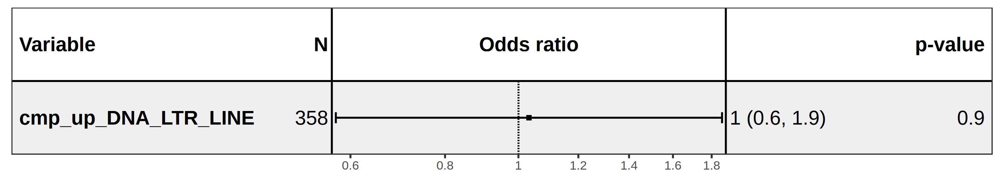

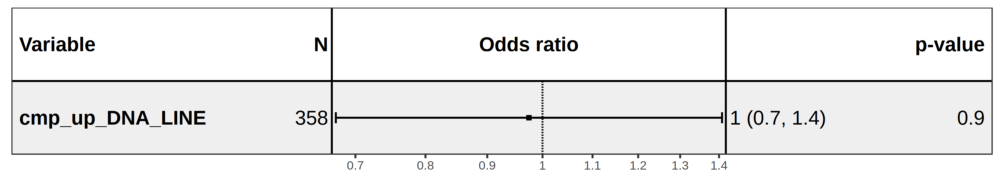

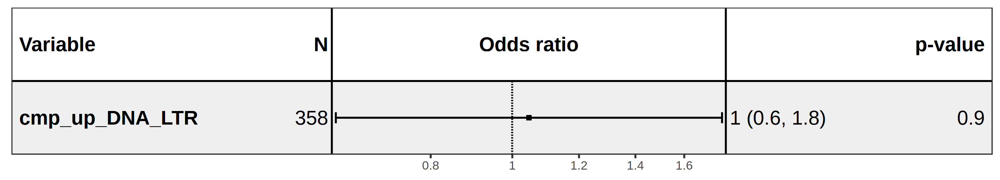

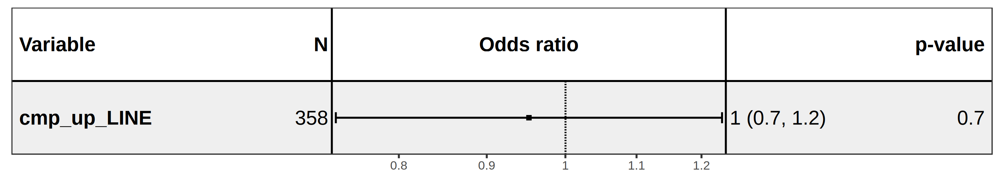

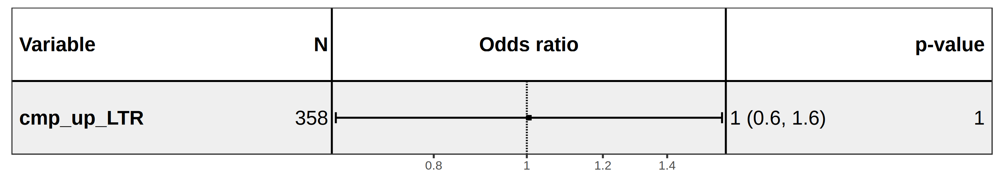

Resized limits to included dashed line in forest panel



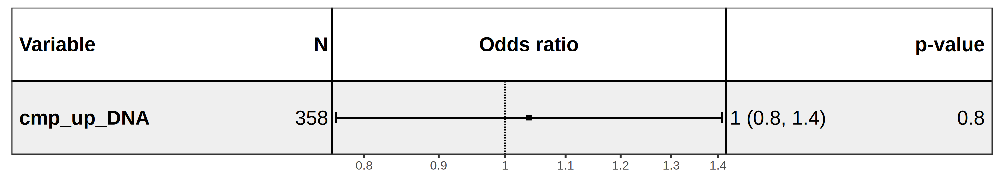

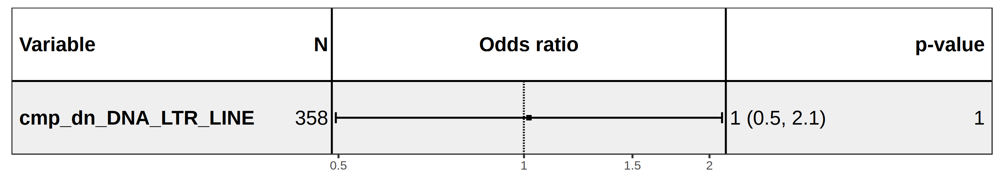

ERROR: Error in model.frame.default(formula = Surv(OS_MONTHS, OS_STATUS) ~ cmp_dn_LINE, : variable lengths differ (found for 'cmp_dn_LINE')


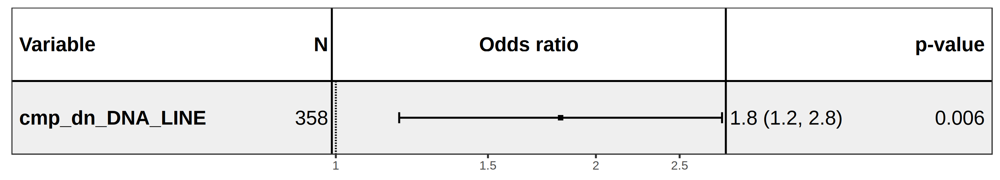

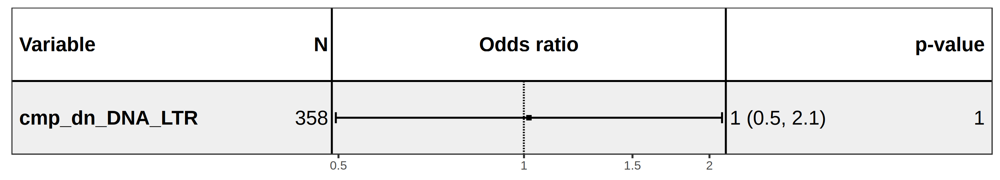

In [1262]:
# batch2
gsva_res = gsva(expr = as.matrix(logcpm_te_b2), gset)
gsva_res = as.data.table(t(gsva_res), keep.rownames = T)
head(gsva_res)

dsn_CMP_TE_score_b2 = merge(dsn_b2, gsva_res, by.x = 'sample_name', by.y = 'rn', all.x = T)

dsn_CMP_TE_score_b2[, OS_STATUS := as.numeric(OS_Stat) ]
dsn_CMP_TE_score_b2[, OS_MONTHS := as.numeric(OS_Month) ]
plotdat = dsn_CMP_TE_score_b2

dependent_os  <- "Surv(OS_MONTHS, OS_STATUS)"

for(var in vars){
    fm = as.formula(paste0(dependent_os, ' ~ ', var ))
    mylogit = coxph(fm, data = plotdat)
    options(repr.plot.width = 10, repr.plot.height = 1.8, repr.plot.res = 300)
    mm = forest_model(mylogit, recalculate_width = F, exponentiate = T, panels = panels,
             format_options = forest_model_format_options(text_size = 5, point_size = 1.5, banded = TRUE))
    print(mm)
}



In [1200]:
dim(logcpm_te_b2)

[1] 1310  359

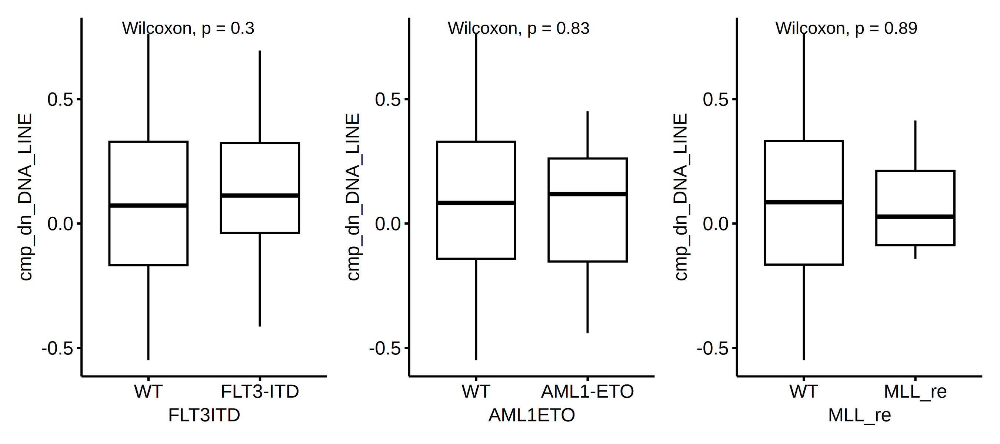

In [1263]:
plotdat = copy(dsn_CMP_TE_score_b2)
options(repr.plot.width = 9, repr.plot.height = 4, repr.plo.res = 300)
ggboxplot(plotdat, x = 'FLT3ITD', y = 'cmp_dn_DNA_LINE' ) + stat_compare_means() | 
ggboxplot(plotdat, x = 'AML1ETO', y = 'cmp_dn_DNA_LINE' ) + stat_compare_means() |
ggboxplot(plotdat, x = 'MLL_re',  y = 'cmp_dn_DNA_LINE' )  + stat_compare_means()
#ggboxplot(logcpm_beat_t, x = 'MLL_re', y = 'relapse', add = 'dotplot', add.params = list(color = 'grey', alpha = 0.5)) + stat_compare_means() 


   Min. 1st Qu.  Median    Mean 3rd Qu.    Max. 
 0.0000  0.2736  0.5544  0.5501  0.7939  2.1331 

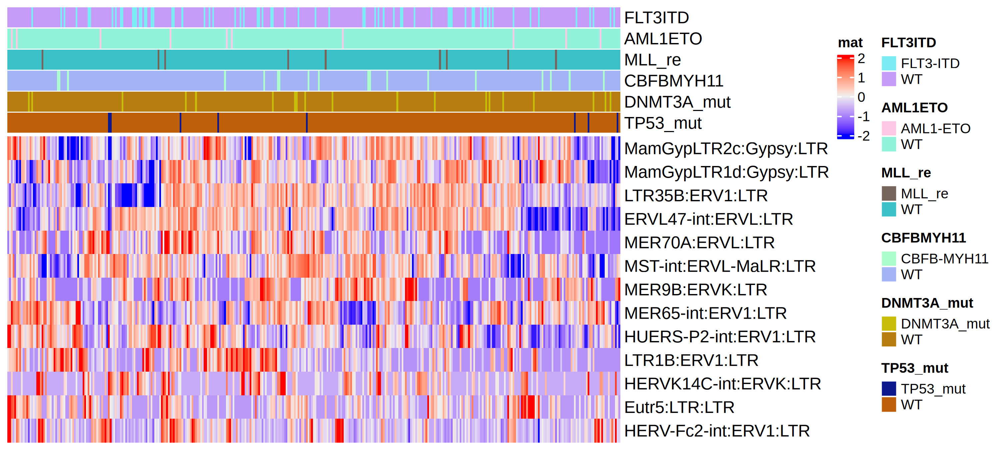

In [1264]:
# significant TEs
options(repr.plot.width = 10, repr.plot.height = 4.5, repr.plot.res = 300)
te_sel = cmp_dn_LTR
te_sel = unique(te_sel)
row_sd = rowSds(logcpm_te_b2)
summary(row_sd)
te_sel = intersect(te_sel, names(row_sd[row_sd > .5]))

plotdat = logcpm_te_b2[te_sel, dsn_b2$sample_name]

plotdat = scale_fun(plotdat) 
plotdat[plotdat > 2] = 2
plotdat[plotdat < -2] = -2

column_ha = HeatmapAnnotation(df = dsn_b2[, .(FLT3ITD, AML1ETO, MLL_re, CBFBMYH11, DNMT3A_mut, TP53_mut)])
#column_ra = rowAnnotation(df = row_sel[, .(.id)]) 
Heatmap(plotdat, name = "mat", show_column_names = F, show_row_names = T, show_column_dend = F, cluster_columns  = T, 
        cluster_rows = T, # row_split = row_sel$.id, 
        show_row_dend = F , top_annotation = column_ha) #, #left_annotation = column_ra, 
#        column_split = factor(dsn_sel$cell_type, levels = cell_types))  

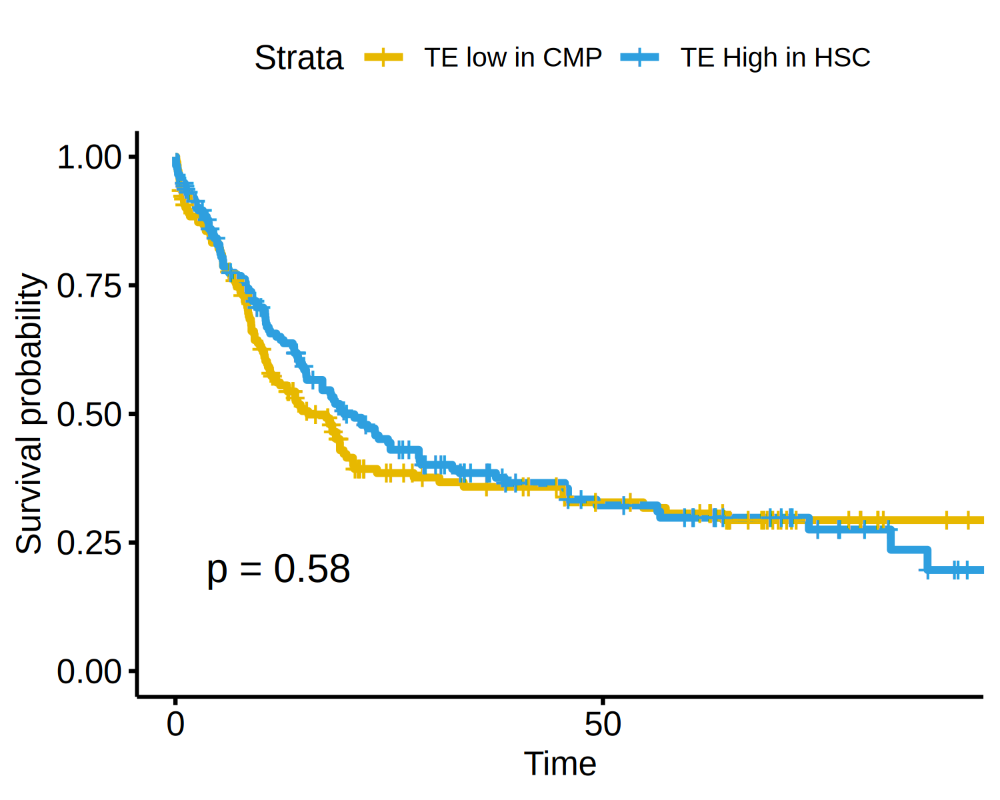

In [1268]:
plotdat = copy(dsn_CMP_TE_score_b2)
plotdat[, OS_STATUS := as.numeric(OS_Stat) ]
plotdat[, OS_MONTHS := as.numeric(OS_Month) ]
plotdat[, lvl := 'low' ]
plotdat[cmp_up_LTR > mean(plotdat$cmp_up_LTR, na.rm = T), lvl := 'hi' ]
fit <- survfit(Surv(OS_MONTHS, OS_STATUS) ~ lvl, data = plotdat)
options(repr.plot.width = 5, repr.plot.height = 4, repr.plo.res = 300)
ggsurvplot(fit, data = plotdat,
           size = 1,                 # change line size
           palette =  c("#E7B800", "#2E9FDF"),# custom color palettes
           pval = TRUE,              # Add p-value
           legend.labs =  c("TE low in CMP", "TE High in HSC"),    # Change legend labels
           ggtheme = theme_pubr(), xlim = c(0, 90))      # Change ggplot2 theme



## expression by molecular subtype

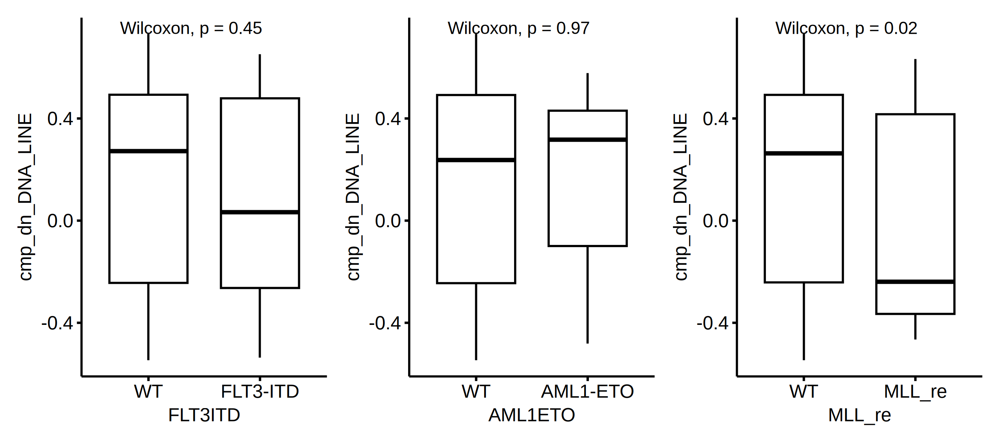

## survival of the TE PCA groups subtype_pca

In [ ]:
plotdat[, OS_STATUS := as.numeric(OS_Stat) ]
plotdat[, OS_MONTHS := as.numeric(OS_Month) ]
plotdat[, lvl := 'low' ]
plotdat[cmp_dn_DNA_LINE > mean(plotdat$cmp_dn_DNA_LINE, na.rm = T), lvl := 'hi' ]
fit <- survfit(Surv(OS_MONTHS, OS_STATUS) ~ lvl, data = plotdat)
options(repr.plot.width = 5, repr.plot.height = 4, repr.plo.res = 300)
ggsurvplot(fit, data = plotdat,
           size = 1,                 # change line size
           palette =  c("#E7B800", "#2E9FDF"),# custom color palettes
           pval = TRUE,              # Add p-value
           legend.labs =  c("TE low in CMP", "TE High in HSC"),    # Change legend labels
           ggtheme = theme_pubr(), xlim = c(0, 90))      # Change ggplot2 theme



## heatmap

[1]  21 735

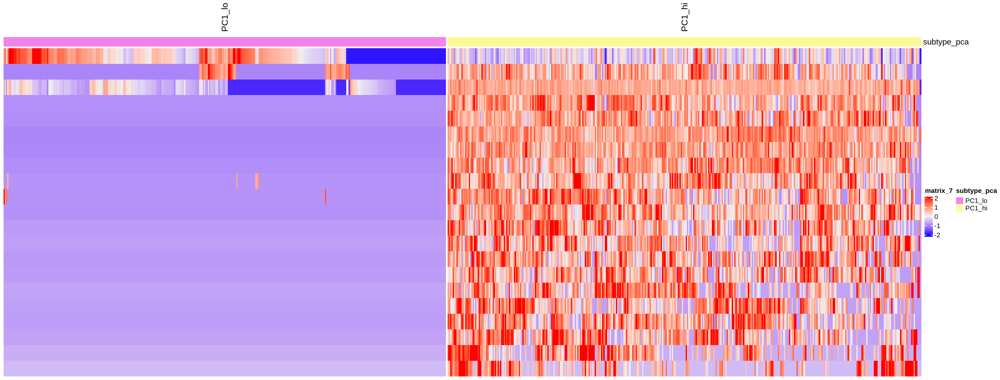

In [652]:
te_sel = cmp_dn_DNA_LINE
dsn_df = setDF(dsn[, .(subtype_pca)], rownames = dsn$sample_name)
plotdat = logcpm_beat_te[te_sel, rownames(dsn_df)]
plotdat = scale_fun(plotdat)
plotdat[plotdat > 2] = 2
plotdat[plotdat < -2] = -2
dim(plotdat)
column_ha = HeatmapAnnotation(df = dsn_df)
args = list(matrix = plotdat, top_annotation = column_ha, 
            column_split = factor(dsn$subtype_pca), show_column_names = F, 
            show_row_names = F, show_column_dend = F, cluster_columns = T, 
            cluster_rows = T, row_names_gp = grid::gpar(fontsize = 7), 
            show_row_dend = F, column_title_rot = 90)
hp = do.call(Heatmap, args)
options(repr.plot.width = 21, repr.plot.height = 8, repr.plot.res = 200)
draw(hp)


# CMP related TElocal signature score

In [181]:
table(deg_telocal_MEPCMP[batch == 'CMP' & logFC > 2 & FDR < 0.01, class_id])



 DNA LINE  LTR SINE 
 340 4012  662  352 

In [178]:
sel = unique(deg_telocal_MEPCMP[batch == 'CMP' & logFC > 2 & FDR < 0.01 & class_id == 'LTR', rn])
length(sel)


[1] 662

In [182]:
plotdat = gsva(expr = logcpm_beat_, list(CMP_up = sel))
plotdat = as.data.table(t(plotdat), keep.rownames = T)
head(plotdat)


Warning message in .filterFeatures(expr, method):
"12 genes with constant expression values throuhgout the samples."
Warning message in .filterFeatures(expr, method):
"Since argument method!="ssgsea", genes with constant expression values are discarded."


ERROR: Error in .mapGeneSetsToFeatures(gset.idx.list, rownames(expr)): No identifiers in the gene sets could be matched to the identifiers in the expression data.


# test Gu's paper gene list

In [275]:
gu = fread('~/WenhuoHu/TE/gu')
setnames(gu, 1, 'gene')
line1 = gu[grep('LINE', gene), gene]
line1 = unlist(lapply(line1, function(xx){
    paste(unlist(strsplit(x = xx, ':'))[c(1,3,2)], collapse = ':')
}))
line1


[1] "L1PA12:L1:LINE" "L1PA2:L1:LINE"  "L1PA10:L1:LINE" "L1MEd:L1:LINE" 
 [5] "L1MA4A:L1:LINE" "L1HS:L1:LINE"   "L1PA3:L1:LINE"  "L1MEc:L1:LINE" 
 [9] "HAL1M8:L1:LINE" "L1ME4b:L1:LINE" "L1MA3:L1:LINE"  "L1PA7:L1:LINE" 
[13] "L1M7:L1:LINE"   "L1M4a2:L1:LINE" "L1MA2:L1:LINE"  "L1MA8:L1:LINE" 
[17] "L1MB2:L1:LINE"  "L1PA16:L1:LINE" "L1ME2:L1:LINE"  "L1PB1:L1:LINE" 
[21] "L1MCa:L1:LINE"  "L1MDa:L1:LINE"  "L1PA6:L1:LINE"  "L1PA4:L1:LINE" 
[25] "L1MA5:L1:LINE"  "L1ME1:L1:LINE"  "L1M3:L1:LINE"   "L1MB3:L1:LINE" 
[29] "L1P1:L1:LINE"   "L1MB8:L1:LINE"  "L1MEf:L1:LINE"  "L1PB4:L1:LINE" 
[33] "L1MEi:L1:LINE"  "L1MC4:L1:LINE"  "L1MA4:L1:LINE"  "L1MD1:L1:LINE"

Warning message:
“Calling gsva(expr=., gset.idx.list=., method=., ...) is deprecated; use a method-specific parameter object (see '?gsva').”
Warning message in .filterFeatures(expr, method):
“11 genes with constant expression values throughout the samples.”
Warning message in .filterFeatures(expr, method):
“Since argument method!="ssgsea", genes with constant expression values are discarded.”


Estimating GSVA scores for 1 gene sets.
Estimating ECDFs with Gaussian kernels
  |======================================================================| 100%




 low high 
  90  269 

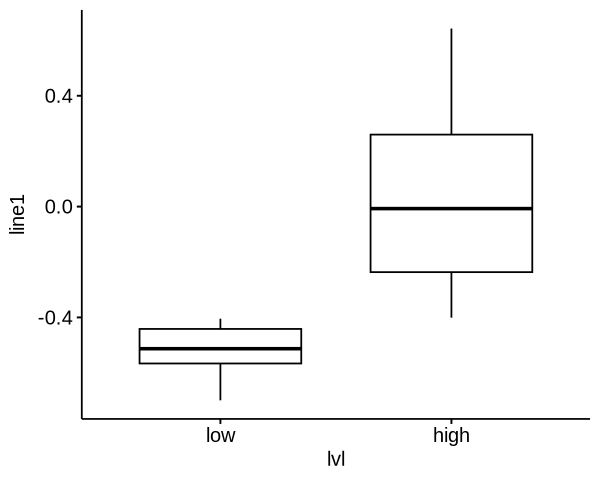

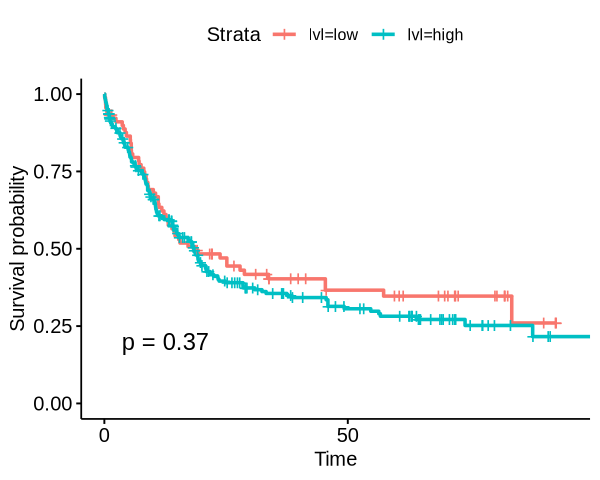

In [407]:
gset_line = list(line1 = line1)
gsva_res = gsva(expr = as.matrix(logcpm_beat_te_combat), gset_line)
gsva_res = as.data.table(t(gsva_res), keep.rownames = T)
gsva_res = merge(dsn_b2, gsva_res, by.x = 'sample_name', by.y = 'rn', all.x = T)
gsva_res[, OS_STATUS := as.numeric(OS_Stat) ]
gsva_res[, OS_MONTHS := as.numeric(OS_Month) ]
var = 'line1'
gsva_res$lvl = cut_quantile(unlist(gsva_res[, var, with = F]), probs = c(0, .25, 1), n_names = c('low', 'high'))
table(gsva_res$lvl)
gg1 = ggboxplot(gsva_res, x = 'lvl', y = var)
fit <- survfit(Surv(OS_MONTHS, OS_STATUS) ~ lvl, data = gsva_res)
options(repr.plot.width = 5, repr.plot.height = 4, repr.plo.res = 300)
gg2 = ggsurvplot(fit, data = gsva_res, size = 1, pval = TRUE, ggtheme = theme_pubr(), xlim = c(0, 95)) 
gg1 
gg2




 low high 
  90  269 

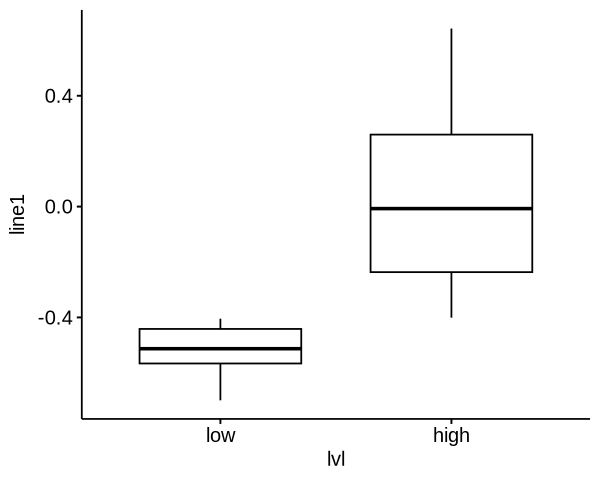

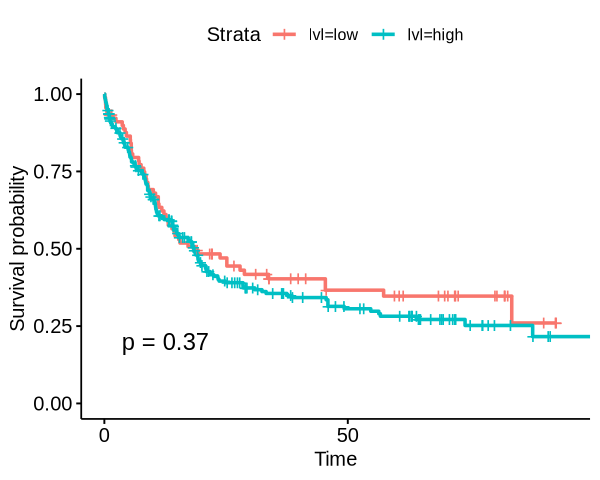

In [402]:
gset_line = list(line1 = line1)
gsva_res = gsva(expr = as.matrix(logcpm_beat_te_combat), gset_line)
gsva_res = as.data.table(t(gsva_res), keep.rownames = T)
gsva_res = merge(dsn_b2, gsva_res, by.x = 'sample_name', by.y = 'rn', all.x = T)
gsva_res[, OS_STATUS := as.numeric(OS_Stat) ]
gsva_res[, OS_MONTHS := as.numeric(OS_Month) ]
var = 'line1'
gsva_res$lvl = cut_quantile(unlist(gsva_res[, var, with = F]), probs = c(0, .25, 1), n_names = c('low', 'high'))
table(gsva_res$lvl)
gg1 = ggboxplot(gsva_res, x = 'lvl', y = var)
fit <- survfit(Surv(OS_MONTHS, OS_STATUS) ~ lvl, data = gsva_res)
options(repr.plot.width = 5, repr.plot.height = 4, repr.plo.res = 300)
gg2 = ggsurvplot(fit, data = gsva_res, size = 1, pval = TRUE, ggtheme = theme_pubr(), xlim = c(0, 95)) 
gg1 
gg2



In [320]:
logcpm_te_b1 = readRDS('/home/whu78/WenhuoHu/dataset/beataml/rds/logcpm_te_batch1_312cases.rds')

In [324]:
dsn_b1 = fread('/home/whu78/WenhuoHu/dataset/beataml/tsv//dsn_b1.tsv')


Warning message:
“Calling gsva(expr=., gset.idx.list=., method=., ...) is deprecated; use a method-specific parameter object (see '?gsva').”
Warning message in .filterFeatures(expr, method):
“11 genes with constant expression values throughout the samples.”
Warning message in .filterFeatures(expr, method):
“Since argument method!="ssgsea", genes with constant expression values are discarded.”


Estimating GSVA scores for 1 gene sets.
Estimating ECDFs with Gaussian kernels
  |======================================================================| 100%



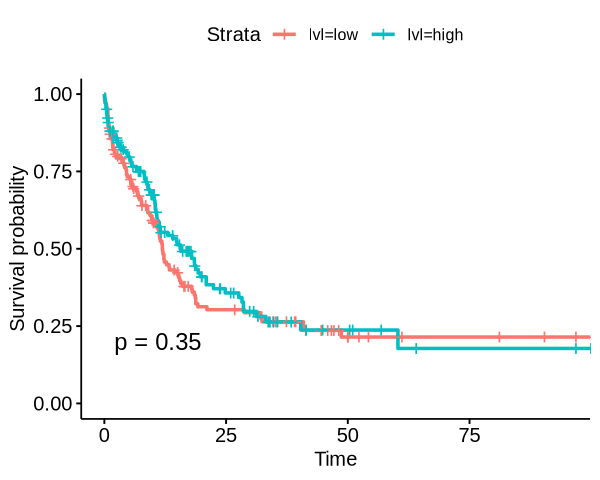

In [403]:
gset_line = list(line1 = line1)

gsva_res = gsva(expr = as.matrix(logcpm_beat_te_combat), gset_line)
gsva_res = as.data.table(t(gsva_res), keep.rownames = T)
gsva_res = merge(dsn_b1, gsva_res, by.x = 'sample_name', by.y = 'rn', all.x = T)
gsva_res[, OS_STATUS := as.numeric(OS_Stat) ]
gsva_res[, OS_MONTHS := as.numeric(OS_Month) ]

vars = names(gset_custom)
var = 'line1'
probs = c(0, .5, 1)
gsva_res$lvl = cut_quantile(unlist(gsva_res[, var, with = F]), probs = probs, n_names = c('low', 'high'))
fit <- survfit(Surv(OS_MONTHS, OS_STATUS) ~ lvl, data = gsva_res)
options(repr.plot.width = 5, repr.plot.height = 4, repr.plo.res = 300)
ggsurvplot(fit, data = gsva_res, size = 1, pval = TRUE, ggtheme = theme_pubr(), xlim = c(0, 95)) 


In [337]:
datatable(logcpm_te_b1[rownames(logcpm_te_b1) %in% gset_custom$cl_1, ])

HTML widgets cannot be represented in plain text (need html)

## **LINE cluster 1**

In [56]:
gsva_res[, .(id, lvl, OS_STATUS, OS_MONTHS)][!is.na(OS_STATUS), ][order(OS_MONTHS), ][OS_MONTHS > 10 & OS_MONTHS < 25, ]
#gsva_res[id == 112, OS_STATUS := 1]
#gsva_res[id == 257, OS_STATUS := 1]
#gsva_res[id == 284, OS_STATUS := 1]
#gsva_res[id == 71, OS_STATUS := 1]
#gsva_res[id == 235, OS_STATUS := 1]
#gsva_res[id == 67, OS_STATUS := 1]
#gsva_res[id == 299, OS_STATUS := 1]

id,lvl,OS_STATUS,OS_MONTHS
<int>,<fct>,<dbl>,<dbl>
97,high,0,10.04959
67,low,0,10.08264
160,low,0,10.08264
57,high,0,10.11570
18,low,0,10.14876
290,low,1,10.18182
260,low,1,10.24793
114,high,1,10.38017
131,low,1,10.44628


Warning message:
“Calling gsva(expr=., gset.idx.list=., method=., ...) is deprecated; use a method-specific parameter object (see '?gsva').”
Warning message in .filterFeatures(expr, method):
“11 genes with constant expression values throughout the samples.”
Warning message in .filterFeatures(expr, method):
“Since argument method!="ssgsea", genes with constant expression values are discarded.”


Estimating GSVA scores for 1 gene sets.
Estimating ECDFs with Gaussian kernels
  |======================================================================| 100%



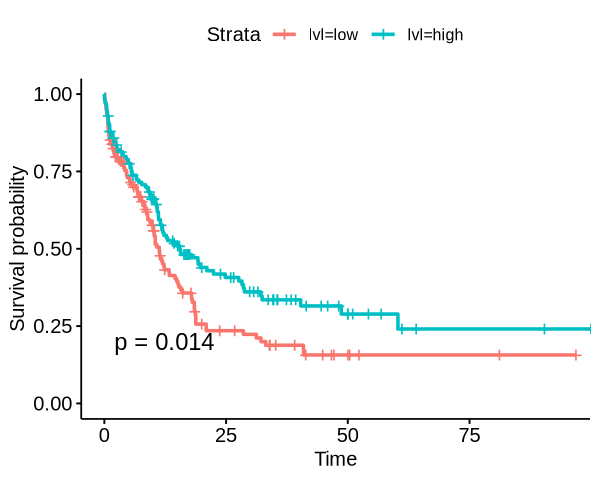

In [57]:
gset_custom = list(custom =  c('HAL1M8:L1:LINE', 'L1M2a:L1:LINE', 'L1M3de:L1:LINE', 'L1MC:L1:LINE', 'L1PA5:L1:LINE', 'Penelope1_Vert:Penelope:LINE', 'X7C_LINE:CR1:LINE'))

gsva_res = gsva(expr = as.matrix(logcpm_beat_te_combat), gset_custom)
gsva_res = as.data.table(t(gsva_res), keep.rownames = T)
tmp = rbindlist(list(dsn_b1, dsn_b2))
gsva_res = merge(dsn_b1, gsva_res, by.x = 'sample_name', by.y = 'rn', all.x = T)
gsva_res[, id := 1:nrow(gsva_res) ]
gsva_res[, OS_STATUS := as.numeric(OS_Stat) ]
gsva_res[, OS_MONTHS := as.numeric(OS_Month) ]
gsva_res[id == 112, OS_STATUS := 1]
gsva_res[id == 257, OS_STATUS := 1]
gsva_res[id == 284, OS_STATUS := 1]
gsva_res[id == 71, OS_STATUS := 1]
gsva_res[id == 235, OS_STATUS := 1]
gsva_res[id == 67, OS_STATUS := 1]
gsva_res[id == 299, OS_STATUS := 1]

var = 'custom'
probs = c(0, .5, 1)
gsva_res$lvl = cut_quantile(unlist(gsva_res[, var, with = F]), probs = probs, n_names = c('low', 'high'))
fit <- survfit(Surv(OS_MONTHS, OS_STATUS) ~ lvl, data = gsva_res)
options(repr.plot.width = 5, repr.plot.height = 4, repr.plo.res = 300)
ggsurvplot(fit, data = gsva_res, size = 1, pval = TRUE, ggtheme = theme_pubr(), xlim = c(0, 95)) 


Warning message:
“Calling gsva(expr=., gset.idx.list=., method=., ...) is deprecated; use a method-specific parameter object (see '?gsva').”
Warning message in .filterFeatures(expr, method):
“11 genes with constant expression values throughout the samples.”
Warning message in .filterFeatures(expr, method):
“Since argument method!="ssgsea", genes with constant expression values are discarded.”


Estimating GSVA scores for 2 gene sets.
Estimating ECDFs with Gaussian kernels
  |======================================================================| 100%



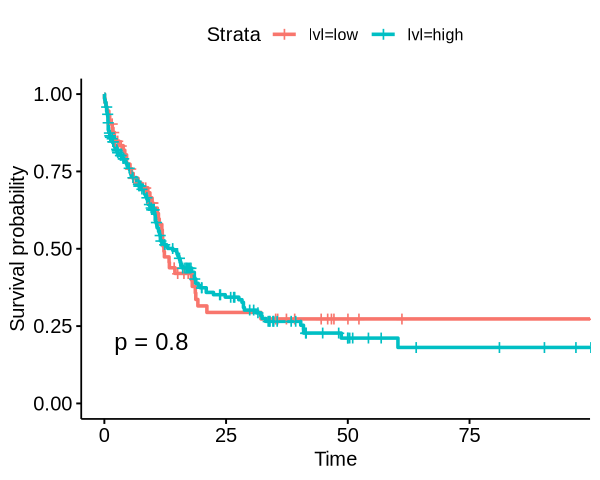

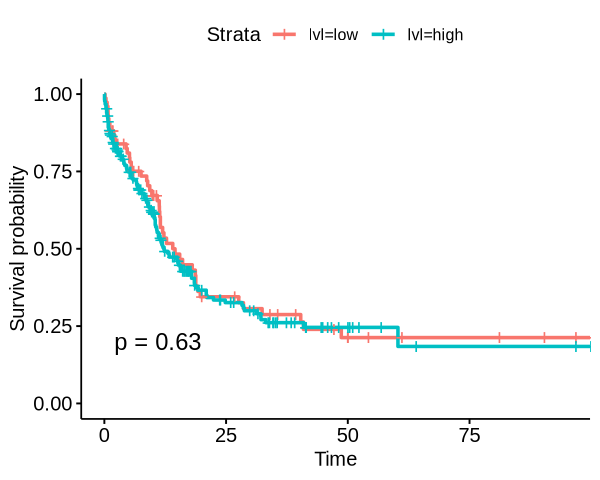

In [436]:
tmp = fread('~/collab_Farhan/cluster_gu.tsv')
n_cl = sort(unique(tmp$cluster))
gset_custom = lapply(n_cl, function(ii){tmp[cluster == ii, gene]})
names(gset_custom) = paste0('cl_', n_cl)

gsva_res = gsva(expr = as.matrix(logcpm_beat_te_combat), gset_custom)
gsva_res = as.data.table(t(gsva_res), keep.rownames = T)
gsva_res = merge(dsn_b1, gsva_res, by.x = 'sample_name', by.y = 'rn', all.x = T)
gsva_res[, OS_STATUS := as.numeric(OS_Stat) ]
gsva_res[, OS_MONTHS := as.numeric(OS_Month) ]

vars = names(gset_custom)
var = vars[1]
probs = c(0, .25, 1)
gsva_res$lvl = cut_quantile(unlist(gsva_res[, var, with = F]), probs = probs, n_names = c('low', 'high'))
fit <- survfit(Surv(OS_MONTHS, OS_STATUS) ~ lvl, data = gsva_res)
options(repr.plot.width = 5, repr.plot.height = 4, repr.plo.res = 300)
ggsurvplot(fit, data = gsva_res, size = 1, pval = TRUE, ggtheme = theme_pubr(), xlim = c(0, 95)) 

var = vars[2]
gsva_res$lvl = cut_quantile(unlist(gsva_res[, var, with = F]), probs = probs, n_names = c('low', 'high'))
fit <- survfit(Surv(OS_MONTHS, OS_STATUS) ~ lvl, data = gsva_res)
options(repr.plot.width = 5, repr.plot.height = 4, repr.plo.res = 300)
ggsurvplot(fit, data = gsva_res, size = 1, pval = TRUE, ggtheme = theme_pubr(), xlim = c(0, 95)) 


Warning message:
“Calling gsva(expr=., gset.idx.list=., method=., ...) is deprecated; use a method-specific parameter object (see '?gsva').”
Warning message in .filterFeatures(expr, method):
“11 genes with constant expression values throughout the samples.”
Warning message in .filterFeatures(expr, method):
“Since argument method!="ssgsea", genes with constant expression values are discarded.”


Estimating GSVA scores for 2 gene sets.
Estimating ECDFs with Gaussian kernels
  |======================================================================| 100%



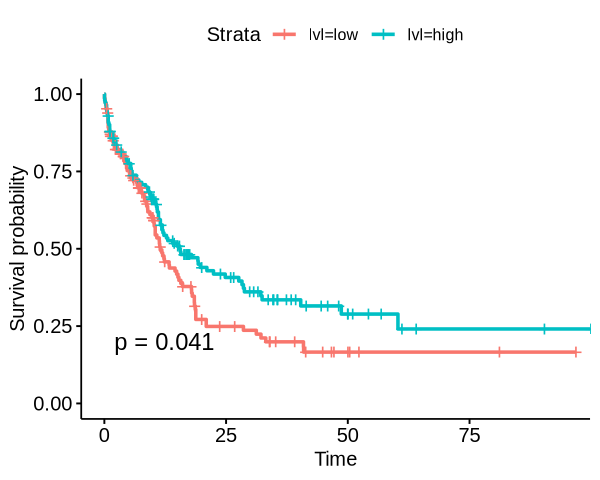

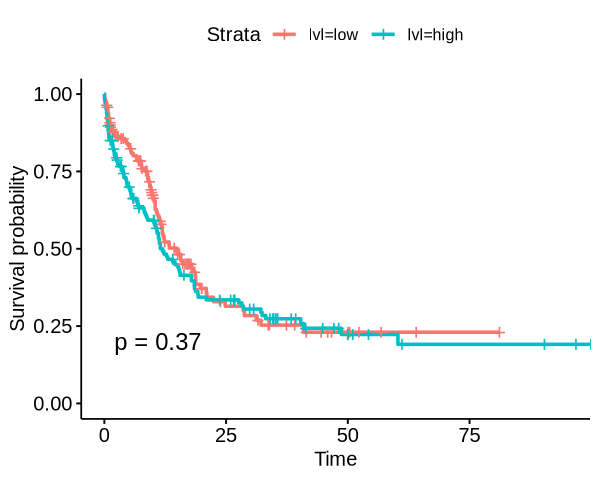

In [438]:
tmp = fread('~/collab_Farhan/cluster.tsv')
n_cl = sort(unique(tmp$cluster))
gset_custom = lapply(n_cl, function(ii){tmp[cluster == ii, gene]})
names(gset_custom) = paste0('cl_', n_cl)

gsva_res = gsva(expr = as.matrix(logcpm_beat_te_combat), gset_custom)
gsva_res = as.data.table(t(gsva_res), keep.rownames = T)
gsva_res = merge(dsn_b1, gsva_res, by.x = 'sample_name', by.y = 'rn', all.x = T)
gsva_res[, OS_STATUS := as.numeric(OS_Stat) ]
gsva_res[, OS_MONTHS := as.numeric(OS_Month) ]

vars = names(gset_custom)
var = vars[1]
probs = c(0, .5, 1)
gsva_res$lvl = cut_quantile(unlist(gsva_res[, var, with = F]), probs = probs, n_names = c('low', 'high'))
fit <- survfit(Surv(OS_MONTHS, OS_STATUS) ~ lvl, data = gsva_res)
options(repr.plot.width = 5, repr.plot.height = 4, repr.plo.res = 300)
ggsurvplot(fit, data = gsva_res, size = 1, pval = TRUE, ggtheme = theme_pubr(), xlim = c(0, 95)) 

var = vars[2]
gsva_res$lvl = cut_quantile(unlist(gsva_res[, var, with = F]), probs = probs, n_names = c('low', 'high'))
fit <- survfit(Surv(OS_MONTHS, OS_STATUS) ~ lvl, data = gsva_res)
options(repr.plot.width = 5, repr.plot.height = 4, repr.plo.res = 300)
ggsurvplot(fit, data = gsva_res, size = 1, pval = TRUE, ggtheme = theme_pubr(), xlim = c(0, 95)) 


Warning message:
“Calling gsva(expr=., gset.idx.list=., method=., ...) is deprecated; use a method-specific parameter object (see '?gsva').”
Warning message in .filterFeatures(expr, method):
“11 genes with constant expression values throughout the samples.”
Warning message in .filterFeatures(expr, method):
“Since argument method!="ssgsea", genes with constant expression values are discarded.”


Estimating GSVA scores for 2 gene sets.
Estimating ECDFs with Gaussian kernels
  |======================================================================| 100%



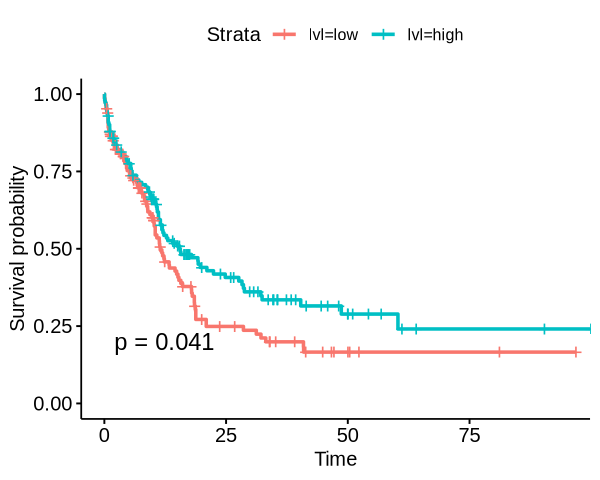

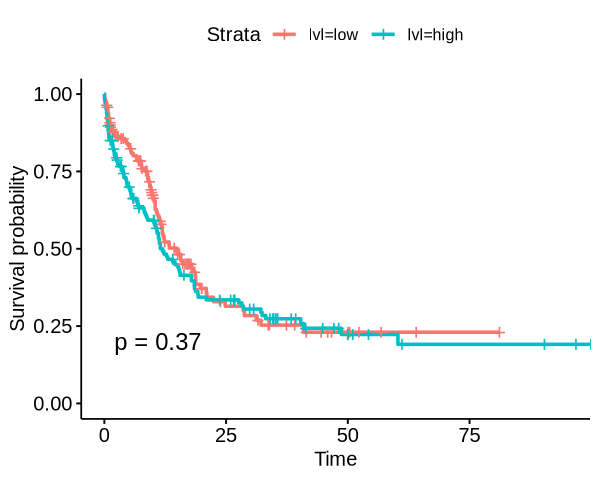

In [406]:
tmp = fread('~/collab_Farhan/cluster.tsv')
n_cl = sort(unique(tmp$cluster))
gset_custom = lapply(n_cl, function(ii){tmp[cluster == ii, gene]})
names(gset_custom) = paste0('cl_', n_cl)

gsva_res = gsva(expr = as.matrix(logcpm_beat_te_combat), gset_custom)
gsva_res = as.data.table(t(gsva_res), keep.rownames = T)
gsva_res = merge(dsn_b1, gsva_res, by.x = 'sample_name', by.y = 'rn', all.x = T)
gsva_res[, OS_STATUS := as.numeric(OS_Stat) ]
gsva_res[, OS_MONTHS := as.numeric(OS_Month) ]

vars = names(gset_custom)
var = vars[1]
probs = c(0, .5, 1)
gsva_res$lvl = cut_quantile(unlist(gsva_res[, var, with = F]), probs = probs, n_names = c('low', 'high'))
fit <- survfit(Surv(OS_MONTHS, OS_STATUS) ~ lvl, data = gsva_res)
options(repr.plot.width = 5, repr.plot.height = 4, repr.plo.res = 300)
ggsurvplot(fit, data = gsva_res, size = 1, pval = TRUE, ggtheme = theme_pubr(), xlim = c(0, 95)) 

var = vars[2]
gsva_res$lvl = cut_quantile(unlist(gsva_res[, var, with = F]), probs = probs, n_names = c('low', 'high'))
fit <- survfit(Surv(OS_MONTHS, OS_STATUS) ~ lvl, data = gsva_res)
options(repr.plot.width = 5, repr.plot.height = 4, repr.plo.res = 300)
ggsurvplot(fit, data = gsva_res, size = 1, pval = TRUE, ggtheme = theme_pubr(), xlim = c(0, 95)) 


In [470]:
library(glmnet)

Loading required package: Matrix


Attaching package: ‘Matrix’


The following objects are masked from ‘package:tidyr’:

    expand, pack, unpack


The following object is masked from ‘package:S4Vectors’:

    expand


Loaded glmnet 4.1-8



In [473]:
selected_genes

[1] "HERV15-int:ERV1:LTR"          "HERVK9-int:ERVK:LTR"         
 [3] "L1M2a:L1:LINE"                "LTR13A:ERVK:LTR"             
 [5] "LTR4:ERV1:LTR"                "LTR5:ERVK:LTR"               
 [7] "LTR61:ERV1:LTR"               "LTR6A:ERV1:LTR"              
 [9] "LTR6B:ERV1:LTR"               "LTR70:ERV1:LTR"              
[11] "LTR7Y:ERV1:LTR"               "MER21B:ERVL:LTR"             
[13] "MER49:ERV1:LTR"               "PABL_B-int:ERV1:LTR"         
[15] "Penelope1_Vert:Penelope:LINE"

Warning message:
“Calling gsva(expr=., gset.idx.list=., method=., ...) is deprecated; use a method-specific parameter object (see '?gsva').”
Warning message in .filterFeatures(expr, method):
“11 genes with constant expression values throughout the samples.”
Warning message in .filterFeatures(expr, method):
“Since argument method!="ssgsea", genes with constant expression values are discarded.”


Estimating GSVA scores for 2 gene sets.
Estimating ECDFs with Gaussian kernels
  |======================================================================| 100%



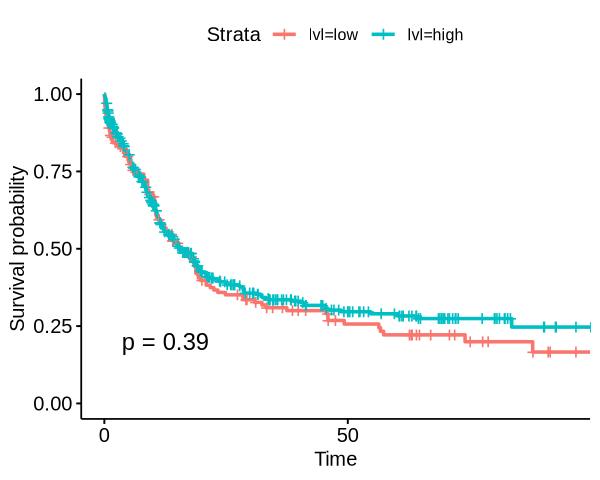

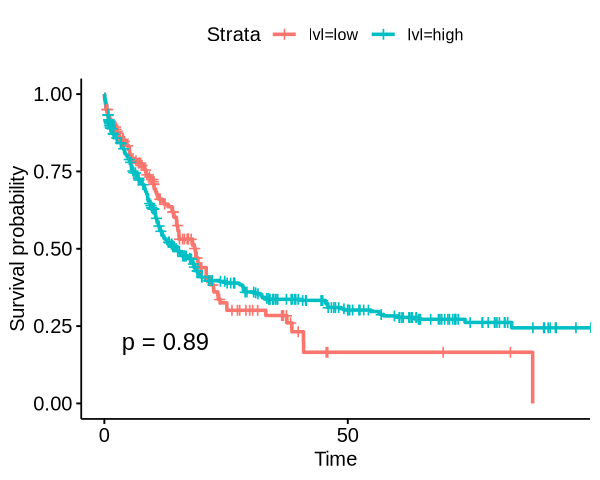

In [479]:
tmp = fread('~/collab_Farhan/cluster_LTRLINE.tsv')
n_cl = sort(unique(tmp$cluster))
gset_custom = lapply(n_cl, function(ii){tmp[cluster == ii, gene]})
names(gset_custom) = paste0('cl_', n_cl)

gsva_res = gsva(expr = as.matrix(logcpm_beat_te_combat), gset_custom)
gsva_res = as.data.table(t(gsva_res), keep.rownames = T)
gsva_res = merge(rbindlist(list(dsn_b1, dsn_b2)), gsva_res, by.x = 'sample_name', by.y = 'rn', all.x = T)
#gsva_res = merge(dsn_b1, gsva_res, by.x = 'sample_name', by.y = 'rn', all.x = T)
gsva_res[, OS_STATUS := as.numeric(OS_Stat) ]
gsva_res[, OS_MONTHS := as.numeric(OS_Month) ]

probs = c(0, .25, 1)
vars = names(gset_custom)
var = vars[1]
gsva_res$lvl = cut_quantile(unlist(gsva_res[, var, with = F]), probs = probs, n_names = c('low', 'high'))
fit <- survfit(Surv(OS_MONTHS, OS_STATUS) ~ lvl, data = gsva_res)
options(repr.plot.width = 5, repr.plot.height = 4, repr.plo.res = 300)
ggsurvplot(fit, data = gsva_res, size = 1, pval = TRUE, ggtheme = theme_pubr(), xlim = c(0, 95)) 

var = vars[2]
gsva_res$lvl = cut_quantile(unlist(gsva_res[, var, with = F]), probs = probs, n_names = c('low', 'high'))
fit <- survfit(Surv(OS_MONTHS, OS_STATUS) ~ lvl, data = gsva_res)
options(repr.plot.width = 5, repr.plot.height = 4, repr.plo.res = 300)
ggsurvplot(fit, data = gsva_res, size = 1, pval = TRUE, ggtheme = theme_pubr(), xlim = c(0, 95)) 


In [478]:
gset_custom$cl_1
selected_genes

[1] "HAL1M8:L1:LINE"               "HERV15-int:ERV1:LTR"         
 [3] "HERV1_I:ERV1:LTR"             "HERV1_LTRa:ERV1:LTR"         
 [5] "HERVE_a-int:ERV1:LTR"         "HERVK3-int:ERVK:LTR"         
 [7] "HERVK9-int:ERVK:LTR"          "HERVS71-int:ERV1:LTR"        
 [9] "L1M2a:L1:LINE"                "L1M3de:L1:LINE"              
[11] "L1MC:L1:LINE"                 "L1PA5:L1:LINE"               
[13] "LTR10C:ERV1:LTR"              "LTR10E:ERV1:LTR"             
[15] "LTR13:ERVK:LTR"               "LTR13A:ERVK:LTR"             
[17] "LTR13_v:ERVK:LTR"             "LTR27C:ERV1:LTR"             
[19] "LTR4:ERV1:LTR"                "LTR5:ERVK:LTR"               
[21] "LTR5B:ERVK:LTR"               "LTR5_Hs:ERVK:LTR"            
[23] "LTR61:ERV1:LTR"               "LTR6A:ERV1:LTR"              
[25] "LTR6B:ERV1:LTR"               "LTR70:ERV1:LTR"              
[27] "LTR7B:ERV1:LTR"               "LTR7Y:ERV1:LTR"              
[29] "MER21A:ERVL:LTR"              "MER21B:ERVL:LTR"             
[31] "MER49:ERV1:LTR"               "MER57E3:ERV1:LTR"            
[33] "MER68:ERVL:LTR"               "MER83B:ERV1:LTR"             
[35] "PABL_A:ERV1:LTR"              "PABL_B-int:ERV1:LTR"         
[37] "PRIMA4-int:ERV1:LTR"          "Penelope1_Vert:Penelope:LINE"
[39] "X7C_LINE:CR1:LINE"

[1] "HERV15-int:ERV1:LTR" "HERVK9-int:ERVK:LTR" "LTR5:ERVK:LTR"      
[4] "LTR61:ERV1:LTR"      "LTR7Y:ERV1:LTR"

In [ ]:
# lasso regression for feature selection
x <- as.matrix(t(logcpm_beat_te_combat[gset_custom$cl_1, gsva_res$sample_name]))
y <- as.numeric(gsva_res$OS_MONTHS)

# Fit Lasso with cross-validation to find optimal lambda
cv_lasso <- cv.glmnet(x, y, alpha = 1) # Alpha = 1 indicates Lasso
best_lambda <- cv_lasso$lambda.min

# Fit Lasso model with the best lambda
lasso_model <- glmnet(x, y, alpha = 1, lambda = best_lambda)

# Extract non-zero coefficients (selected genes)
selected_genes <- rownames(coef(lasso_model))[-1][coef(lasso_model)[-1] != 0]

gsva_res = gsva(expr = as.matrix(logcpm_beat_te_combat), list(custom = selected_genes))
gsva_res = as.data.table(t(gsva_res), keep.rownames = T)
#gsva_res = merge(rbindlist(list(dsn_b1, dsn_b2)), gsva_res, by.x = 'sample_name', by.y = 'rn', all.x = T)
gsva_res = merge(dsn_b1, gsva_res, by.x = 'sample_name', by.y = 'rn', all.x = T)
gsva_res[, OS_STATUS := as.numeric(OS_Stat) ]
gsva_res[, OS_MONTHS := as.numeric(OS_Month) ]
gsva_res$lvl = cut_quantile(unlist(gsva_res[, 'custom', with = F]), probs = probs, n_names = c('low', 'high'))
fit <- survfit(Surv(OS_MONTHS, OS_STATUS) ~ lvl, data = gsva_res)
options(repr.plot.width = 5, repr.plot.height = 4, repr.plo.res = 300)
ggsurvplot(fit, data = gsva_res, size = 1, pval = TRUE, ggtheme = theme_pubr(), xlim = c(0, 95)) 


Warning message:
“Calling gsva(expr=., gset.idx.list=., method=., ...) is deprecated; use a method-specific parameter object (see '?gsva').”
Warning message in .filterFeatures(expr, method):
“11 genes with constant expression values throughout the samples.”
Warning message in .filterFeatures(expr, method):
“Since argument method!="ssgsea", genes with constant expression values are discarded.”


Warning message:
“Calling gsva(expr=., gset.idx.list=., method=., ...) is deprecated; use a method-specific parameter object (see '?gsva').”
Warning message in .filterFeatures(expr, method):
“11 genes with constant expression values throughout the samples.”
Warning message in .filterFeatures(expr, method):
“Since argument method!="ssgsea", genes with constant expression values are discarded.”


Estimating GSVA scores for 2 gene sets.
Estimating ECDFs with Gaussian kernels
  |======================================================================| 100%



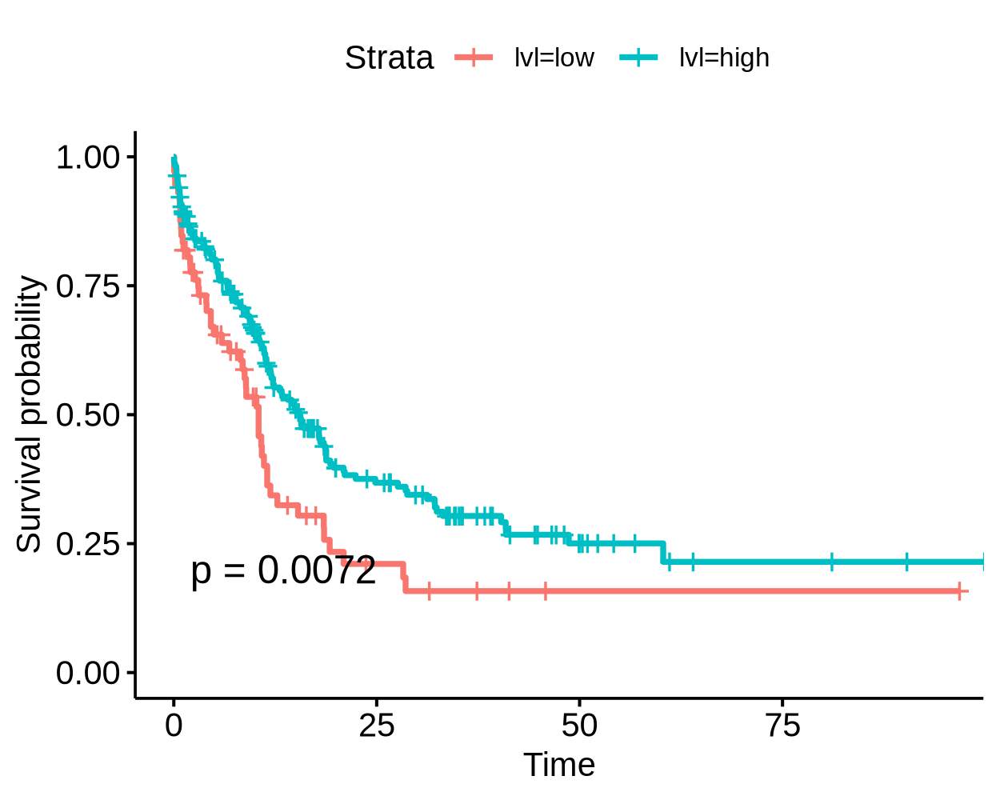

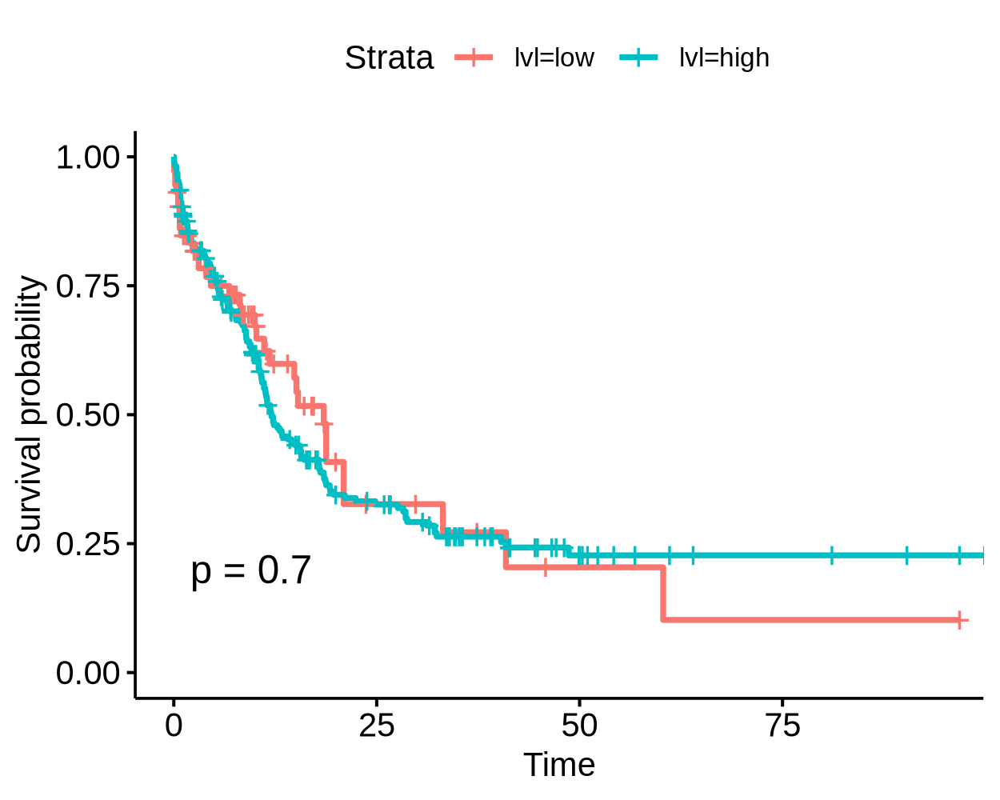

In [554]:
tmp = fread('~/collab_Farhan/cluster_LTR.tsv')
n_cl = sort(unique(tmp$cluster))
gset_custom = lapply(n_cl, function(ii){tmp[cluster == ii, gene]})
names(gset_custom) = paste0('cl_', n_cl)

gsva_res = gsva(expr = as.matrix(logcpm_beat_te_combat), gset_custom)
gsva_res = as.data.table(t(gsva_res), keep.rownames = T)
#gsva_res = merge(rbindlist(list(dsn_b1, dsn_b2)), gsva_res, by.x = 'sample_name', by.y = 'rn', all.x = T)
gsva_res = merge(dsn_b1, gsva_res, by.x = 'sample_name', by.y = 'rn', all.x = T)
gsva_res[, OS_STATUS := as.numeric(OS_Stat) ]
gsva_res[, OS_MONTHS := as.numeric(OS_Month) ]

probs = c(0, .25, 1)
vars = names(gset_custom)
var = vars[1]
gsva_res$lvl = cut_quantile(unlist(gsva_res[, var, with = F]), probs = probs, n_names = c('low', 'high'))
fit <- survfit(Surv(OS_MONTHS, OS_STATUS) ~ lvl, data = gsva_res)
options(repr.plot.width = 5, repr.plot.height = 4, repr.plo.res = 300)
ggsurvplot(fit, data = gsva_res, size = 1, pval = TRUE, ggtheme = theme_pubr(), xlim = c(0, 95)) 

var = vars[2]
gsva_res$lvl = cut_quantile(unlist(gsva_res[, var, with = F]), probs = probs, n_names = c('low', 'high'))
fit <- survfit(Surv(OS_MONTHS, OS_STATUS) ~ lvl, data = gsva_res)
options(repr.plot.width = 5, repr.plot.height = 4, repr.plo.res = 300)
ggsurvplot(fit, data = gsva_res, size = 1, pval = TRUE, ggtheme = theme_pubr(), xlim = c(0, 95)) 


In [405]:
head(logcpm_beat_te_combat)
dim(logcpm_beat_te_combat)

,2000_BA2123,2002_BA2111,2003_BA2499,2004_BA2846,2005_BA2802,2008_BA2676,2009_BA3322,2010_BA2304,2013_BA2195,2014_BA2226,⋯,2825_BA3415,2827_BA3195,2829_BA3245,2830_BA3079,2831_BA3141,2832_BA3124,2833_BA3412,2834_BA3438,2835_BA3109,2835_BA3452
(CATTC)n:Satellite:Satellite,0.4353962,-0.0473015,-0.0473015,-0.0473015,-0.0473015,-0.0473015,-0.0473015,-0.0473015,-0.0473015,0.7194616,⋯,-0.0473015,-0.0473015,-0.0473015,-0.0473015,-0.0473015,-0.0473015,1.6281037,1.8522644,-0.0473015,-0.0473015
(GAATG)n:Satellite:Satellite,0.4353962,1.7035381,0.4270006,-0.0473015,-0.0473015,3.1319275,-0.0473015,0.7868479,-0.0473015,0.5061888,⋯,-0.0473015,-0.0473015,-0.0473015,3.4143245,-0.0473015,-0.0473015,-0.0473015,-0.0473015,1.8305604,-0.0473015
7SLRNA:srpRNA:srpRNA,0.4353962,-0.0473015,0.4270006,0.4426732,-0.0473015,0.3557798,-0.0473015,-0.0473015,-0.0473015,0.9052290,⋯,-0.0473015,-0.0473015,-0.0473015,-0.0473015,-0.0473015,-0.0473015,-0.0473015,-0.0473015,-0.0473015,-0.0473015
A-rich:Low_complexity:Low_complexity,0.7964479,-0.0473015,-0.0473015,1.0988719,-0.0473015,-0.0473015,-0.0473015,-0.0473015,-0.0473015,-0.0473015,⋯,-0.0473015,-0.0473015,-0.0473015,-0.0473015,-0.0473015,-0.0473015,-0.0473015,-0.0473015,-0.0473015,-0.0473015
ACRO1:acro:Satellite,0.4353962,-0.0473015,0.4270006,0.4426732,1.7370640,0.3557798,-0.0473015,0.7868479,-0.0473015,0.2558258,⋯,-0.0473015,-0.0473015,-0.0473015,-0.0473015,-0.0473015,-0.0473015,-0.0473015,-0.0473015,-0.0473015,-0.0473015
ALR/Alpha:centr:Satellite,7.3337801,6.9342522,6.2537227,8.6116489,7.5535695,7.3111172,7.3374947,6.8594263,7.2399562,6.6384115,⋯,9.4516744,8.1071810,5.9760320,7.4145301,8.9549356,6.8161722,8.2305287,8.3835990,5.0016145,6.6375930


[1] 1310  735

In [359]:
row_zero = apply(logcpm_te_b2, 1, FUN = function(rr){sum(rr == 0)}) 
head(row_zero)
length(row_zero)

(CATTC)n:Satellite:Satellite         (GAATG)n:Satellite:Satellite 
                                 278                                  251 
                7SLRNA:srpRNA:srpRNA A-rich:Low_complexity:Low_complexity 
                                 357                                  359 
                ACRO1:acro:Satellite            ALR/Alpha:centr:Satellite 
                                 357                                    0

[1] 1310

In [363]:
row_zero = apply(logcpm_te_b1, 1, FUN = function(rr){sum(rr == 0)}) 
head(row_zero)
length(row_zero)

(CATTC)n:Satellite:Satellite         (GAATG)n:Satellite:Satellite 
                                 238                                  210 
                7SLRNA:srpRNA:srpRNA A-rich:Low_complexity:Low_complexity 
                                 308                                  312 
                ACRO1:acro:Satellite            ALR/Alpha:centr:Satellite 
                                 305                                    0

[1] 1310

In [362]:
sum(logcpm_te_b2[1,] == 0)

[1] 278

Warning message:
“Calling gsva(expr=., gset.idx.list=., method=., ...) is deprecated; use a method-specific parameter object (see '?gsva').”
Warning message in .filterFeatures(expr, method):
“173 genes with constant expression values throughout the samples.”
Warning message in .filterFeatures(expr, method):
“Since argument method!="ssgsea", genes with constant expression values are discarded.”


Estimating GSVA scores for 2 gene sets.
Estimating ECDFs with Gaussian kernels
  |======================================================================| 100%



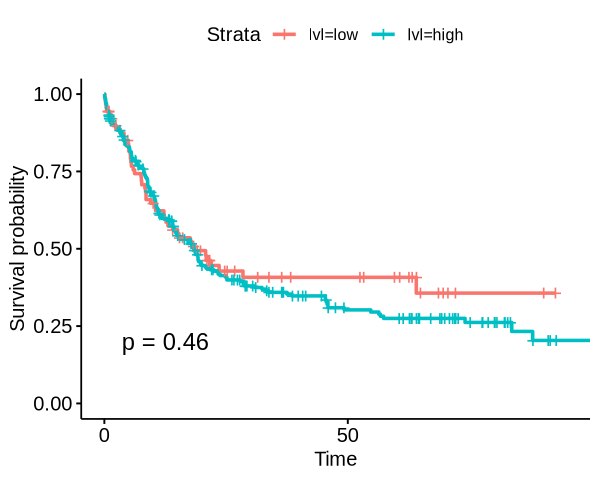

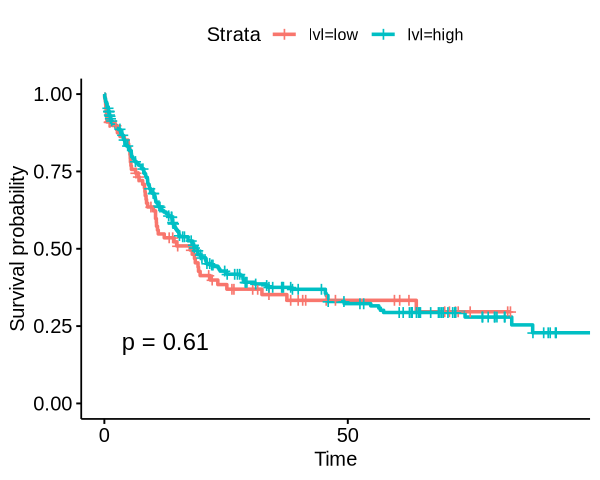

In [354]:
tmp = fread('~/collab_Farhan/cluster.tsv')
n_cl = sort(unique(tmp$cluster))
gset_custom = lapply(n_cl, function(ii){tmp[cluster == ii, gene]})
names(gset_custom) = paste0('cl_', n_cl)

gsva_res = gsva(expr = as.matrix(logcpm_te_b2), gset_custom)
gsva_res = as.data.table(t(gsva_res), keep.rownames = T)
gsva_res = merge(dsn_b2, gsva_res, by.x = 'sample_name', by.y = 'rn', all.x = T)
gsva_res[, OS_STATUS := as.numeric(OS_Stat) ]
gsva_res[, OS_MONTHS := as.numeric(OS_Month) ]

vars = names(gset_custom)
var = vars[1]
probs = c(0, .25, 1)
gsva_res$lvl = cut_quantile(unlist(gsva_res[, var, with = F]), probs = probs, n_names = c('low', 'high'))
fit <- survfit(Surv(OS_MONTHS, OS_STATUS) ~ lvl, data = gsva_res)
options(repr.plot.width = 5, repr.plot.height = 4, repr.plo.res = 300)
ggsurvplot(fit, data = gsva_res, size = 1, pval = TRUE, ggtheme = theme_pubr(), xlim = c(0, 95)) 

var = vars[2]
gsva_res$lvl = cut_quantile(unlist(gsva_res[, var, with = F]), probs = probs, n_names = c('low', 'high'))
fit <- survfit(Surv(OS_MONTHS, OS_STATUS) ~ lvl, data = gsva_res)
options(repr.plot.width = 5, repr.plot.height = 4, repr.plo.res = 300)
ggsurvplot(fit, data = gsva_res, size = 1, pval = TRUE, ggtheme = theme_pubr(), xlim = c(0, 95)) 


# TE signature score test Nov 5

In [ ]:
logcpm_te_b2 = readRDS(file = '~/WenhuoHu/dataset/beataml/tsv/.rds')
dsn_b2 = fread('~/WenhuoHu/dataset/beataml/tsv/dsn_b2.tsv')


In [ ]:
logcpm_te_b2 = readRDS(file = '~/WenhuoHu/dataset/beataml/rds/deg_te_dt_twoBatch_beataml_359cases.rds')
dsn_b2 = fread('~/WenhuoHu/dataset/beataml/tsv/dsn_b2.tsv')


In [9]:
cluster_info_dt = fread('~/WenhuoHu/collab_Farhan/cluster_info_dt.tsv')

In [14]:
cluster_info_dt[, tag := paste0(info, '__', cluster) ]

In [10]:
head(cluster_info_dt)

.id,gene,cluster,info,category,class_id
<chr>,<chr>,<int>,<chr>,<chr>,<chr>
cluster_info_blue_6ctypes_updn_2cluster.tsv,Charlie12:hAT-Charlie:DNA,2,1(91): high in CMP/GMP/MEP; 2(128): high in HSC/EB/MK,all sig,DNA
cluster_info_blue_6ctypes_updn_2cluster.tsv,Charlie15a:hAT-Charlie:DNA,1,1(91): high in CMP/GMP/MEP; 2(128): high in HSC/EB/MK,all sig,DNA
cluster_info_blue_6ctypes_updn_2cluster.tsv,Charlie16a:hAT-Charlie:DNA,1,1(91): high in CMP/GMP/MEP; 2(128): high in HSC/EB/MK,all sig,DNA
cluster_info_blue_6ctypes_updn_2cluster.tsv,Charlie19a:hAT-Charlie:DNA,1,1(91): high in CMP/GMP/MEP; 2(128): high in HSC/EB/MK,all sig,DNA
cluster_info_blue_6ctypes_updn_2cluster.tsv,Charlie1a:hAT-Charlie:DNA,1,1(91): high in CMP/GMP/MEP; 2(128): high in HSC/EB/MK,all sig,DNA
cluster_info_blue_6ctypes_updn_2cluster.tsv,Charlie1b:hAT-Charlie:DNA,1,1(91): high in CMP/GMP/MEP; 2(128): high in HSC/EB/MK,all sig,DNA


In [15]:
table(cluster_info_dt$tag, cluster_info_dt$class_id)

                                                          
                                                           DNA LINE LTR
  1(26): high in CMP; 2(24): high in CMP/GMP__1             12    3  11
  1(26): high in CMP; 2(24): high in CMP/GMP__2             16    0   8
  1(44): high in HSC; 2(18): high in HSC/GMP__1             13    6  25
  1(44): high in HSC; 2(18): high in HSC/GMP__2              4    5   9
  1(49): high in HSC/Eb/MK; 2(43): high in CMP/MEP__1       28    3  18
  1(49): high in HSC/Eb/MK; 2(43): high in CMP/MEP__2        9    5  29
  1(50): high in CMP/GMP/MEP; 2(62): high in HSC/EB/MK__1   28    3  19
  1(50): high in CMP/GMP/MEP; 2(62): high in HSC/EB/MK__2   17   11  34
  1(91): high in CMP/GMP/MEP; 2(128): high in HSC/EB/MK__1  47    8  36
  1(91): high in CMP/GMP/MEP; 2(128): high in HSC/EB/MK__2  29   14  85

In [42]:
tmp = unique(cluster_info_dt$tag)
#combn(tmp, 1:length(tmp))
tmp = lapply(1:length(tmp), function(kk){combn(tmp, kk)}) 
tag1_list = list()
for(ii in 1:length(tmp)){
    tag1_list = c(tag1_list, apply(tmp[[ii]], 2, as.list))
}
tag1_list = lapply(tag1_list, function(ii){unname(unlist(ii))}) 
head(tag1_list) 
length(tag1_list) 


[[1]]
[1] "1(91): high in CMP/GMP/MEP; 2(128): high in HSC/EB/MK__2"

[[2]]
[1] "1(91): high in CMP/GMP/MEP; 2(128): high in HSC/EB/MK__1"

[[3]]
[1] "1(50): high in CMP/GMP/MEP; 2(62): high in HSC/EB/MK__1"

[[4]]
[1] "1(50): high in CMP/GMP/MEP; 2(62): high in HSC/EB/MK__2"

[[5]]
[1] "1(26): high in CMP; 2(24): high in CMP/GMP__1"

[[6]]
[1] "1(26): high in CMP; 2(24): high in CMP/GMP__2"

In [40]:
tmp = unique(cluster_info_dt$class_id)
#combn(tmp, 1:length(tmp))
tmp = lapply(1:length(tmp), function(kk){combn(tmp, kk)}) 
tag2_list = list()
for(ii in 1:length(tmp)){
    tag2_list = c(tag2_list, apply(tmp[[ii]], 2, as.list))
}
tag2_list = lapply(tag2_list, function(ii){unname(unlist(ii))}) 
tag2_list

[[1]]
[1] "DNA"

[[2]]
[1] "LTR"

[[3]]
[1] "LINE"

[[4]]
[1] "DNA" "LTR"

[[5]]
[1] "DNA"  "LINE"

[[6]]
[1] "LTR"  "LINE"

[[7]]
[1] "DNA"  "LTR"  "LINE"

In [47]:
tag12_list = list()
for(ii in 1:length(tag1_list)){
    for(jj in 1:length(tag2_list)){
        tag12_list = c(tag12_list, list(list(tag1 = tag1_list[[ii]], tag2 = tag2_list[[jj]])))
    }
}

In [59]:
names(tag12_list) = paste0('com_', 1:length(tag12_list))

In [72]:
length(tag12_list)

[1] 7161

In [140]:
tag12_list[[4]][['tag2']]

[1] "DNA" "LTR"

In [181]:
gset = lapply(1:length(tag12_list), function(ii){
    tag1 = unname(tag12_list[[ii]][['tag1']])
    tag2 = unname(tag12_list[[ii]][['tag2']])
    unique(cluster_info_dt[tag %in% tag1 & class_id %in% tag2, gene])
})
names(gset) = names(tag12_list)
gset = gset[unlist(lapply(gset, function(xx){length(xx) > 0})) == T]
head(gset)


$com_1
 [1] "Charlie12:hAT-Charlie:DNA"      "Charlie7b_Mars:hAT-Charlie:DNA"
 [3] "Eulor10:DNA:DNA"                "Eulor3:DNA:DNA"                
 [5] "Eulor5B:Crypton-A:DNA"          "Eulor6C:Crypton:DNA"           
 [7] "Eulor7:DNA:DNA"                 "Eulor8:TcMar:DNA"              
 [9] "Eutr15:hAT-Tip100:DNA"          "MER121:hAT:DNA"                
[11] "MER123:DNA:DNA"                 "MER133A:PIF-Harbinger:DNA"     
[13] "MER133B:PIF-Harbinger:DNA"      "MER136:Merlin:DNA"             
[15] "MER45R:hAT-Tip100:DNA"          "MER97d:hAT-Tip100:DNA"         
[17] "MER99:hAT?:DNA"                 "MamRep1879:hAT-Tip100?:DNA"    
[19] "Tigger1a_Mars:TcMar-Tigger:DNA" "UCON11:TcMar-Tigger:DNA"       
[21] "UCON15:hAT-Ac:DNA"              "UCON21:DNA:DNA"                
[23] "UCON23:hAT-Tip100:DNA"          "UCON62:Crypton:DNA"            
[25] "UCON7:DNA:DNA"                  "X22_DNA:TcMar:DNA"             
[27] "X23_DNA:DNA:DNA"                "Zaphod:hAT-Tip100:DNA"         
[29] "hAT-N1_Mam:hAT-Tip100?:DNA"    

$com_2
 [1] "ERV3-16A3_I:ERVL:LTR"    "ERVL-B4-int:ERVL:LTR"   
 [3] "HERV-Fc1-int:ERV1:LTR"   "HERV-Fc1_LTR1:ERV1:LTR" 
 [5] "HERV-Fc1_LTR3:ERV1:LTR"  "HERV-Fc2-int:ERV1:LTR"  
 [7] "HERV16-int:ERVL:LTR"     "HERV1_LTRe:ERV1:LTR"    
 [9] "HERV35I-int:ERV1:LTR"    "HERVK11D-int:ERVK:LTR"  
[11] "HERVK14C-int:ERVK:LTR"   "HERVKC4-int:ERVK:LTR"   
[13] "HERVL18-int:ERVL:LTR"    "HERVL32-int:ERVL:LTR"   
[15] "HUERS-P2-int:ERV1:LTR"   "LOR1a:ERV1:LTR"         
[17] "LTR103_Mam:ERV1:LTR"     "LTR108b_Mam:ERVL:LTR"   
[19] "LTR108c_Mam:ERVL:LTR"    "LTR109A2:ERV1:LTR"      
[21] "LTR16:ERVL:LTR"          "LTR16A1:ERVL:LTR"       
[23] "LTR16A2:ERVL:LTR"        "LTR16D:ERVL:LTR"        
[25] "LTR16E1:ERVL:LTR"        "LTR16E2:ERVL:LTR"       
[27] "LTR1B0:ERV1:LTR"         "LTR1B:ERV1:LTR"         
[29] "LTR1C3:ERV1:LTR"         "LTR21C:ERV1:LTR"        
[31] "LTR27D:ERV1:LTR"         "LTR28:ERV1:LTR"         
[33] "LTR33C:ERVL:LTR"         "LTR35B:ERV1:LTR"        
[35] "LTR37-int:ERV1:LTR"      "LTR38A1:ERV1:LTR"       
[37] "LTR40a:ERVL:LTR"         "LTR43-int:ERV1:LTR"     
[39] "LTR47B:ERVL:LTR"         "LTR48B:ERV1:LTR"        
[41] "LTR52:ERVL:LTR"          "LTR53B:ERVL:LTR"        
[43] "LTR58:ERV1:LTR"          "LTR77:ERV1:LTR"         
[45] "LTR80A:ERVL:LTR"         "LTR81:Gypsy:LTR"        
[47] "LTR82A:ERVL:LTR"         "LTR85a:Gypsy:LTR"       
[49] "LTR88b:Gypsy:LTR"        "LTR89B:ERVL:LTR"        
[51] "LTR8B:ERV1:LTR"          "MER101B:ERV1:LTR"       
[53] "MER31-int:ERV1:LTR"      "MER4-int:ERV1:LTR"      
[55] "MER41G:ERV1:LTR"         "MER4B-int:ERV1:LTR"     
[57] "MER4CL34:ERV1:LTR"       "MER50-int:ERV1:LTR"     
[59] "MER61-int:ERV1:LTR"      "MER65-int:ERV1:LTR"     
[61] "MER66C:ERV1:LTR"         "MER67C:ERV1:LTR"        
[63] "MER67D:ERV1:LTR"         "MER84:ERV1:LTR"         
[65] "MER89-int:ERV1:LTR"      "MER89:ERV1:LTR"         
[67] "MER92-int:ERV1:LTR"      "MER92A:ERV1:LTR"        
[69] "MER92C:ERV1:LTR"         "MER92D:ERV1:LTR"        
[71] "MER9B:ERVK:LTR"          "MLT2A2:ERVL:LTR"        
[73] "MST-int:ERVL-MaLR:LTR"   "MamGyp-int:Gypsy:LTR"   
[75] "MamGypLTR1a:Gypsy:LTR"   "MamGypLTR1b:Gypsy:LTR"  
[77] "MamGypLTR1d:Gypsy:LTR"   "MamGypLTR2c:Gypsy:LTR"  
[79] "MamGypsy2-I:Gypsy:LTR"   "MamGypsy2-LTR:Gypsy:LTR"
[81] "MamRep1527:LTR:LTR"      "PABL_B:ERV1:LTR"        
[83] "PRIMA41-int:ERV1:LTR"    "THE1D-int:ERVL-MaLR:LTR"
[85] "X1_LR:Gypsy:LTR"        

$com_3
 [1] "L1MA1:L1:LINE"         "L1MDb:L1:LINE"         "L1P3b:L1:LINE"        
 [4] "L1P4a:L1:LINE"         "L1P4c:L1:LINE"         "L1P4d:L1:LINE"        
 [7] "L1PA15-16:L1:LINE"     "L1PA16:L1:LINE"        "L1PA8A:L1:LINE"       
[10] "L1PB2:L1:LINE"         "L1PB3:L1:LINE"         "L1PB:L1:LINE"         
[13] "MamRTE2:RTE-BovB:LINE" "X7D_LINE:CR1:LINE"    

$com_4
  [1] "Charlie12:hAT-Charlie:DNA"      "Charlie7b_Mars:hAT-Charlie:DNA"
  [3] "ERV3-16A3_I:ERVL:LTR"           "ERVL-B4-int:ERVL:LTR"          
  [5] "

In [187]:
length(gset)

[1] 7160

In [283]:
gsva_res = gsva(expr = as.matrix(logcpm_te_b2), gset)
gsva_res = as.data.table(t(gsva_res), keep.rownames = T)
gsva_res = merge(dsn_b2, gsva_res, by.x = 'sample_name', by.y = 'rn', all.x = T)
gsva_res[, OS_STATUS := as.numeric(OS_Stat) ]
gsva_res[, OS_MONTHS := as.numeric(OS_Month) ]



Warning message:
“Calling gsva(expr=., gset.idx.list=., method=., ...) is deprecated; use a method-specific parameter object (see '?gsva').”
Warning message in .filterFeatures(expr, method):
“173 genes with constant expression values throughout the samples.”
Warning message in .filterFeatures(expr, method):
“Since argument method!="ssgsea", genes with constant expression values are discarded.”


Estimating GSVA scores for 7160 gene sets.
Estimating ECDFs with Gaussian kernels
  |======================================================================| 100%



In [281]:
source('~/script/utils.r')

In [291]:
vars_surv_list = lapply(vars, function(var){
    gsva_res$lvl = cut_quantile(unlist(gsva_res[, var, with = F]), probs = c(0, .25, 1), n_names = c('low', 'high'))
    plotdat = gsva_res[MLL_re == 'WT' & AML1ETO == 'WT' & FLT3ITD == 'WT', ]
    tmp = surv_sum_fun(plotdat)
    tmp
})
names(vars_surv_list) = vars
vars_surv_dt = rbindlist(vars_surv_list, idcol = T) 
vars_surv_dt = vars_surv_dt[order(pval), ]
head(vars_surv_dt) 


.id,rn,records,n.max,n.start,events,rmean,se(rmean),median,0.95LCL,0.95UCL,pval
<chr>,<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
com_26,lvl=low,68,68,68,33,86.53972,11.081306,32.36364,18.11570,NA,0.009629926
com_26,lvl=high,206,206,206,141,41.73238,5.722552,15.53719,14.01653,19.66942,0.009629926
com_257,lvl=low,68,68,68,33,86.53972,11.081306,32.36364,18.11570,NA,0.009629926
com_257,lvl=high,206,206,206,141,41.73238,5.722552,15.53719,14.01653,19.66942,0.009629926
com_264,lvl=low,68,68,68,33,86.53972,11.081306,32.36364,18.11570,NA,0.009629926
com_264,lvl=high,206,206,206,141,41.73238,5.722552,15.53719,14.01653,19.66942,0.009629926


In [292]:
tcga_surv_dt = fread('../tcga/vars_surv_dt.tsv')

In [293]:
head(tcga_surv_dt)

.id,rn,records,n.max,n.start,events,rmean,se(rmean),median,0.95LCL,0.95UCL,pval
<chr>,<chr>,<int>,<int>,<int>,<int>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
com_17,lvl=low,35,35,35,28,23.82744,7.360229,7.5,4.5,11.8,9.703299e-05
com_17,lvl=high,87,87,87,53,51.47972,5.596024,27.0,19.0,53.9,9.703299e-05
com_31,lvl=low,35,35,35,28,23.82744,7.360229,7.5,4.5,11.8,9.703299e-05
com_31,lvl=high,87,87,87,53,51.47972,5.596024,27.0,19.0,53.9,9.703299e-05
com_199,lvl=low,35,35,35,28,23.82744,7.360229,7.5,4.5,11.8,9.703299e-05
com_199,lvl=high,87,87,87,53,51.47972,5.596024,27.0,19.0,53.9,9.703299e-05


In [294]:
intersect(tcga_surv_dt[pval < 0.05, .id], 
vars_surv_dt[pval < 0.05, .id])

[1] "com_1197"

$tag1
[1] "1(26): high in CMP; 2(24): high in CMP/GMP__1"

$tag2
[1] "LINE"

[1] "HAL1M8:L1:LINE" "L1M2a:L1:LINE"  "L1MC:L1:LINE"


 low high 
  90  269 

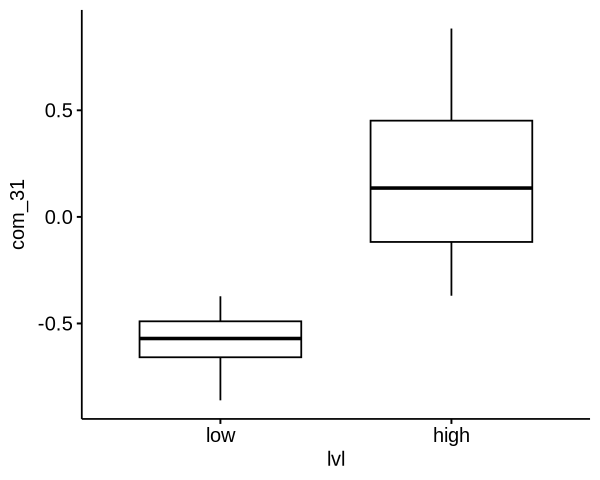

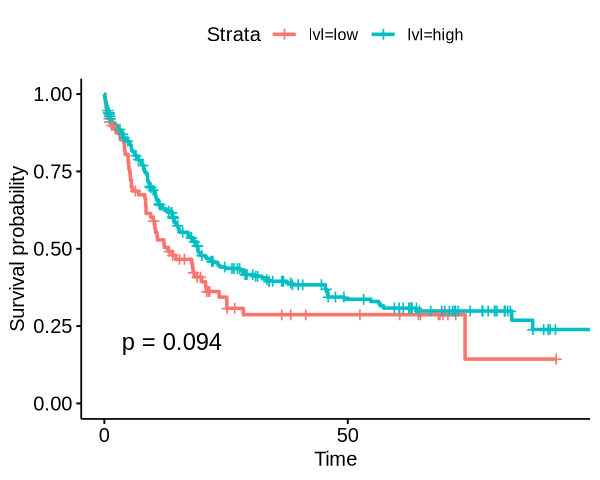

In [296]:
var = 'com_31'
tag12_list[[var]]
gset[[var]]
gsva_res$lvl = cut_quantile(unlist(gsva_res[, var, with = F]), probs = c(0, .25, 1), n_names = c('low', 'high'))
table(gsva_res$lvl)
gg1 = ggboxplot(gsva_res, x = 'lvl', y = var)
fit <- survfit(Surv(OS_MONTHS, OS_STATUS) ~ lvl, data = gsva_res)
options(repr.plot.width = 5, repr.plot.height = 4, repr.plo.res = 300)
gg2 = ggsurvplot(fit, data = gsva_res, size = 1, pval = TRUE, ggtheme = theme_pubr(), xlim = c(0, 95)) 
gg1 
gg2


In [234]:
saveRDS(gset, file = '~/WenhuoHu/dataset/beataml/gset.rds')
saveRDS(tag12_list, file = '~/WenhuoHu/dataset/beataml/tag12_list.rds')


In [225]:
table(gsva_res$lvl, gsva_res$AML1ETO)

    
     AML1-ETO  WT
  Q1        4 116
  Q2        3 116
  Q3        3 117

In [ ]:
cell_type_mep = c('HSC', 'CMP', 'GMP', 'MEP', 'EB', 'MK')
gene_sel = unique(deg_MEPCMP[abs(logFC) > 1 & FDR < 0.05 & class_id %in% 'LTR', rn])
length(gene_sel)
dsn_sel = dsn_all_df_n24[dsn_all_df_n24$cell_type %in% cell_type_mep, , drop = F]
plotdat = logcpm_te[rownames(logcpm_te) %in% gene_sel, rownames(dsn_sel)]
plotdat[, 'GMP1'] = unlist(lapply(1:nrow(plotdat), function(ii){
    mm = (plotdat[ii, 'GMP2'] + plotdat[ii, 'GMP3'])/2
    runif(1, mm*.9, mm*1.1) }))

plotdat = scale_fun(plotdat) 
plotdat[plotdat > 2] = 2
plotdat[plotdat < -2] = -2

column_ha = HeatmapAnnotation(df = dsn_sel[, 'cell_type', drop = F])

options(repr.plot.width = 5, repr.plot.height = 4, repr.plot.res = 200)
set.seed(123)
hp = Heatmap(plotdat, name = "mat", show_column_names = F, show_row_names = F, show_column_dend = F, cluster_columns  = F, 
        cluster_rows = T,  row_names_gp = grid::gpar(size = 4), 
        show_row_dend = F, top_annotation = column_ha, km = 2,
        column_split = factor(dsn_sel$cell_type, levels = cell_types))  
hp_draw = draw(hp)

row_clusters = as.data.table(melt(row_order(hp_draw)))[order(value), L1]  # Get row indices for each cluster
cluster_info = data.table( gene = rownames(plotdat), cluster = row_clusters)
cluster_info[, info := '1(91): high in CMP/GMP/MEP; 2(128): high in HSC/EB/MK']
cluster_info[, category := 'all sig' ]
table(cluster_info$cluster)
fwrite(cluster_info, file = 'cluster_info_blue_6ctypes_updn_2cluster.tsv')


In [118]:
var = 'com_1'
plotdat = gsva_res[, c(var, 'OS_MONTHS', 'OS_STATUS'), with = F]
plotdat$lvl = cut_quantile(unlist(gsva_res[, var, with = F]), n = 2, n_names = c('lo', 'hi'))

# Extract p-value
test <- survdiff(Surv(OS_MONTHS, OS_STATUS) ~ lvl, data = plotdat)
p_value <- 1 - pchisq(test$chisq, length(test$n) - 1)

# Summary of the survfit object
fit <- survfit(Surv(OS_MONTHS, OS_STATUS) ~ lvl, data = plotdat)
summary_fit <- summary(fit)
tmp = as.data.table(summary_fit$table, keep.rownames = T)
tmp$pval = p_value
tmp$com = var
tmp

rn,records,n.max,n.start,events,rmean,se(rmean),median,0.95LCL,0.95UCL,pval,com
<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<chr>
lvl=lo,179,179,179,102,56.97164,10.247500,20.79339,15.53719,37.48760,0.06192105,com_1
lvl=hi,179,179,179,119,45.60967,6.797934,15.30579,11.80165,19.73554,0.06192105,com_1


# relapse signature score

In [99]:
tecount_relapse_sel_LTR_up_id = tecount_relapse_sel[class_id == 'LTR' & logFC < 0, rn]
tecount_relapse_sel_LTR_up_id


[1] "MER34B-int:ERV1:LTR"  "MER61F:ERV1:LTR"      "LTR12C:ERV1:LTR"     
[4] "MER57F:ERV1:LTR"      "LTR54:ERV1:LTR"       "MamGypLTR4:Gypsy:LTR"
[7] "LTR7Y:ERV1:LTR"       "HERV30-int:ERV1:LTR"  "HERV9NC-int:ERV1:LTR"

In [100]:
plotdat = gsva(expr = logcpm_beat_te, list(relapse_LTR_UP = tecount_relapse_sel_LTR_up_id))
plotdat = as.data.table(t(plotdat), keep.rownames = T)
head(plotdat)


Warning message in .filterFeatures(expr, method):
"12 genes with constant expression values throuhgout the samples."
Warning message in .filterFeatures(expr, method):
"Since argument method!="ssgsea", genes with constant expression values are discarded."


Estimating GSVA scores for 1 gene sets.
Estimating ECDFs with Gaussian kernels
  |======================================================================| 100%



rn,relapse_LTR_UP
<chr>,<dbl>
2000_BA2123,-0.44322427
2003_BA2499,-0.25674422
2004_BA2846,-0.15109353
2008_BA2676,-0.01008534
2010_BA2304,0.70360443
2014_BA2226,0.24979191


In [101]:
plotdat[, dbgap_id := sub('_.*', '', rn) ]
plotdat[, rnaseq_id:= sub('.*_', '', rn) ]
head(plotdat)

rn,relapse_LTR_UP,dbgap_id,rnaseq_id
<chr>,<dbl>,<chr>,<chr>
2000_BA2123,-0.44322427,2000,BA2123
2003_BA2499,-0.25674422,2003,BA2499
2004_BA2846,-0.15109353,2004,BA2846
2008_BA2676,-0.01008534,2008,BA2676
2010_BA2304,0.70360443,2010,BA2304
2014_BA2226,0.24979191,2014,BA2226


In [102]:
logcpm_beat_t = merge(logcpm_beat_t, plotdat[, .(rnaseq_id, relapse_LTR_UP)], by.x = 'rn2', by.y = 'rnaseq_id')
logcpm_beat_t[1:3, 1:10]

rn2,rn,UBE2Q2P2,HMGB1P1,RNU12-2P,EFCAB8,SDR16C6P,HSPB1P1,PPBPP1,GTPBP6
<chr>,<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
BA2000,BA2000R,0.02926131,0.4846250,0.18884637,0.1122339,0,0.1122339,0,3.915470
BA2003,BA2003R,0.90268049,0.4228661,0.03690553,0.3191444,0,0.2034060,0,4.137656
BA2011,BA2011R,0.70116448,0.3463987,0.17241135,1.5996898,0,0.1069691,0,4.180953


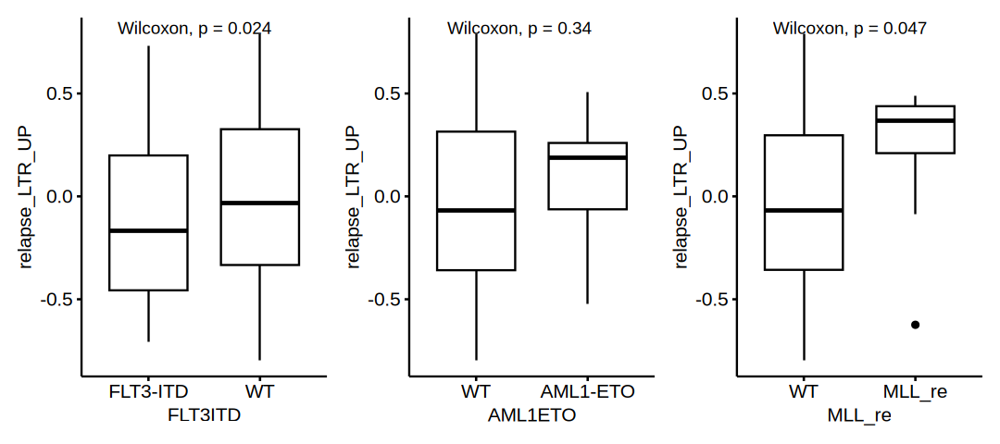

In [103]:
options(repr.plot.width = 9, repr.plot.height = 4, repr.plo.res = 300)
ggboxplot(logcpm_beat_t, x = 'FLT3ITD', y = 'relapse_LTR_UP' ) + stat_compare_means() | 
ggboxplot(logcpm_beat_t, x = 'AML1ETO', y = 'relapse_LTR_UP' ) + stat_compare_means() |
ggboxplot(logcpm_beat_t, x = 'MLL_re',  y = 'relapse_LTR_UP' )  + stat_compare_means()
#ggboxplot(logcpm_beat_t, x = 'MLL_re', y = 'relapse', add = 'dotplot', add.params = list(color = 'grey', alpha = 0.5)) + stat_compare_means() 


In [94]:
library(survminer)
library(survival)


Attaching package: 'survival'


The following object is masked from 'package:survminer':

    myeloma




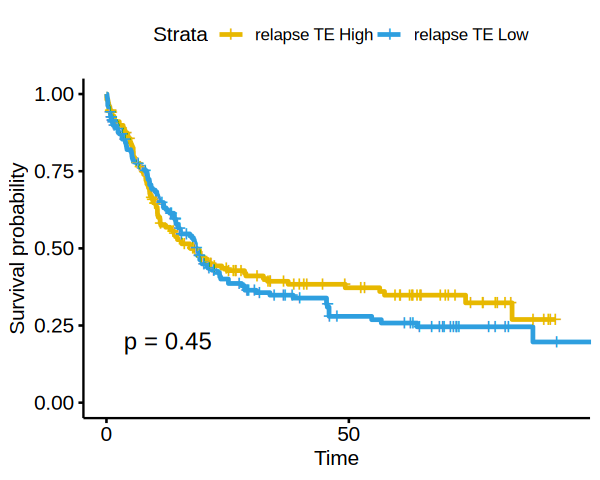

In [104]:
plotdat = logcpm_beat_t[, .(relapse_LTR_UP, BCAT1, OS_MONTHS, OS_STATUS)]
plotdat[, OS_STATUS := as.numeric(OS_STATUS) ]
plotdat[, lvl := 'low' ]
plotdat[relapse_LTR_UP > mean(plotdat$relapse_LTR_UP, na.rm = T), lvl := 'hi' ]
fit <- survfit(Surv(OS_MONTHS, OS_STATUS) ~ lvl, data = plotdat)
options(repr.plot.width = 5, repr.plot.height = 4, repr.plo.res = 300)
ggsurvplot(fit, data = plotdat,
           size = 1,                 # change line size
           palette =  c("#E7B800", "#2E9FDF"),# custom color palettes
           pval = TRUE,              # Add p-value
           legend.labs =  c("relapse TE High", "relapse TE Low"),    # Change legend labels
           ggtheme = theme_pubr(), xlim = c(0, 95))      # Change ggplot2 theme



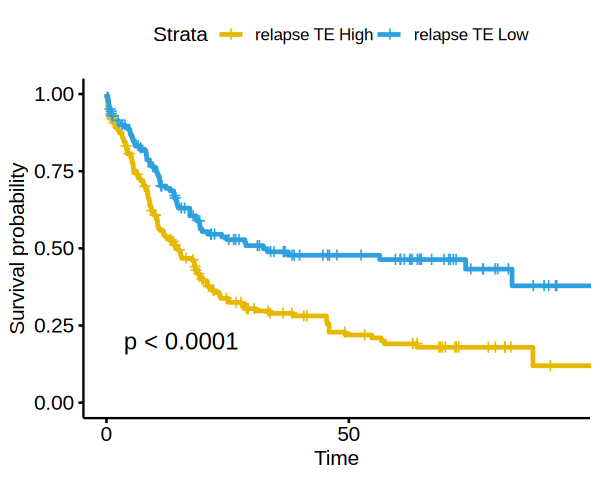

In [96]:
plotdat = logcpm_beat_t[, .(relapse_LTR_UP, BCAT1, OS_MONTHS, OS_STATUS)]
plotdat[, OS_STATUS := as.numeric(OS_STATUS) ]
plotdat[, lvl := 'low' ]
plotdat[BCAT1 > mean(plotdat$BCAT1, na.rm = T), lvl := 'hi' ]
fit <- survfit(Surv(OS_MONTHS, OS_STATUS) ~ lvl, data = plotdat)
options(repr.plot.width = 5, repr.plot.height = 4, repr.plo.res = 300)
ggsurvplot(fit, data = plotdat,
           size = 1,                 # change line size
           palette =  c("#E7B800", "#2E9FDF"),# custom color palettes
           pval = TRUE,              # Add p-value
           legend.labs =  c("relapse TE High", "relapse TE Low"),    # Change legend labels
           ggtheme = theme_pubr(), xlim = c(0, 95))      # Change ggplot2 theme



# NMF

In [ ]:
library(NMF)
meth <- nmfAlgorithm(version='R')
meth <- c(names(meth), meth)
meth
plotdat = log2( 1 + 2 ^ logcpm_telocal_b2)
#plotdat = scale_fun(plotdat)
#row_sd = apply(logcpm_tcga_te, 1, sd) 
#summary(row_sd)
#plotdat = logcpm_tcga_te[row_sd > .65, ]
res2 <- nmf(plotdat, 500, meth, seed=123456)

Loading required package: pkgmaker

Loading required package: registry


Attaching package: ‘pkgmaker’


The following object is masked from ‘package:S4Vectors’:

    new2


Loading required package: rngtools

Loading required package: cluster

NMF - BioConductor layer [OK] | Shared memory capabilities [NO: bigmemory] | Cores 159/160

  To enable shared memory capabilities, try: install.extras('
NMF
')


Attaching package: ‘NMF’


The following object is masked from ‘package:BiocParallel’:

    register


The following object is masked from ‘package:nlme’:

    coef<-


The following object is masked from ‘package:S4Vectors’:

    nrun




brunet         lee 
   "brunet"       "lee"    "offset"     "nsNMF" ".R#brunet"    ".R#lee" 
     offset       nsNMF 
".R#offset"  ".R#nsNMF"

Compute NMF method 'brunet' [1/8] ... 

Warning message in validityMethod(object):
“Dimensions of W and H look strange [ncol(W)= 500 > ncol(H)= 359 ]”
Warning message in validityMethod(object):
“Dimensions of W and H look strange [ncol(W)= 500 > ncol(H)= 359 ]”
Warning message in validityMethod(object):
“Dimensions of W and H look strange [ncol(W)= 500 > ncol(H)= 359 ]”


# RIGI

In [94]:
logcpm_coding = fread('/research_jude/rgs01_jude/groups/jxugrp/home/common/Lab_Members/WenhuoHu/share_data/BeatAML_671cases_logcpm.xls') 
logcpm_coding = setDF(logcpm_coding[, 2:ncol(logcpm_coding)], rownames = logcpm_coding$geneName)


In [99]:
logcpm_coding[rownames(logcpm_coding) %in% c('IFIH1', 'RIGI', 'DHX58', 'DDX41', 'TLR3'), beat_clin_df$sampleName, drop = F]

,BA2452R,BA2922R,BA2707R,BA2409R,BA2480R,BA2496R,BA3037R,BA2236R,BA2172R,BA2865R,⋯,BA3237R,BA3130R,BA3376R,BA3137R,BA3300R,BA3375R,BA3249R,BA3385R,BA3416R,BA3123R
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,⋯,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
DHX58,5.162118,4.4571723,4.7322820,4.681693,5.420214,4.974213,5.138374,4.3944561,5.23174307,4.5890593,⋯,6.1116154,5.039627,4.645211,5.1167321,4.7182454,3.603079,5.6335943,4.5020995,4.159728,6.400255
IFIH1,4.996651,4.0160217,5.0062298,5.085166,5.215349,4.316296,6.586736,5.0300787,4.05042304,4.7091207,⋯,5.5536654,5.201895,4.421171,5.0153170,4.9186124,4.167569,5.7195036,4.9378701,4.544854,5.209040
TLR3,3.679911,0.8990945,-0.8805168,-2.391974,1.156034,-1.955393,-1.320006,0.9198351,0.06409522,-0.4427142,⋯,-0.6491899,-1.370552,1.681354,0.2231415,0.7177342,0.811476,0.3031201,-0.9636854,-2.774024,1.616173
DDX41,6.452499,5.8474900,6.2728928,6.356274,6.115037,6.400255,7.143032,6.0879414,6.91004547,6.4910217,⋯,6.3041808,6.179899,6.631112,6.2589692,6.7155417,6.274688,6.4613617,6.4373919,7.057960,6.225453


In [83]:
beat_clin =  logcpm_coding = fread('/research_jude/rgs01_jude/groups/jxugrp/home/common/Lab_Members/WenhuoHu/share_data/BeatAML_671cases_clincalInfo.xls') 


In [96]:
beat_clin[, subtype2 := 'WT']
for(ii in aml_mut){
    if(length(intersect(ii, colnames(beat_clin))) > 0){
        beat_clin[get(ii)  != 'WT', subtype2 := ii]
    }
}
tmp = beat_clin[sampleName %in% colnames(logcpm_coding), ]
beat_clin_df = setDF(tmp, rownames = tmp$sampleName)
head(beat_clin_df)

,sampleName,dbgap_subject_id,dbgap_dnaseq_sample,dbgap_rnaseq_sample,cohort,used_manuscript_analyses,manuscript_dnaseq,manuscript_rnaseq,manuscript_inhibitor,consensus_sex,⋯,ASXL1_mut,NRAS_mut,JAK2_mut,GNB1_mut,KRAS_mut,CBL_mut,IDH1_mut,IDH2_mut,OS_Stat,subtype2
,<chr>,<int>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,⋯,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<int>,<chr>
BA2452R,BA2452R,2157,BA2452D,BA2452R,Both,no,no,no,no,Male,⋯,WT,WT,WT,WT,WT,WT,WT,WT,1,WT
BA2922R,BA2922R,2269,,BA2922R,Waves1+2,yes,no,yes,yes,Male,⋯,WT,WT,WT,WT,WT,WT,WT,WT,1,FLT3ITD
BA2707R,BA2707R,2313,BA2707D,BA2707R,Both,no,no,no,no,Male,⋯,WT,WT,WT,WT,WT,WT,WT,WT,1,WT
BA2409R,BA2409R,2418,,BA2409R,Waves1+2,yes,no,yes,yes,Female,⋯,WT,WT,WT,WT,WT,WT,WT,WT,1,WT
BA2480R,BA2480R,2374,,BA2480R,Waves1+2,yes,no,yes,no,Male,⋯,WT,WT,WT,WT,WT,WT,WT,WT,1,WT
BA2496R,BA2496R,2099,,BA2496R,Waves1+2,yes,no,yes,yes,Male,⋯,WT,WT,WT,WT,WT,WT,WT,WT,1,WT


In [113]:
#logcpm_all[rownames(logcpm_all) %in% c('MDA5', 'RIGI', 'LGP2'), , drop = F]
dsn_sel = beat_clin_df[beat_clin_df$sampleName %in% dsn_b2$sampleName, ]
plotdat = logcpm_coding[rownames(logcpm_coding) %in% c('IFIH1', 'RIGI', 'DHX58', 'DDX41', 'TLR3', 'IFNGR1'), dsn_sel$sampleName, drop = F]
dim(plotdat)
plotdat = scale_fun(plotdat) 
plotdat[plotdat > 2] = 2
plotdat[plotdat < -2] = -2
col_ha = HeatmapAnnotation(df = dsn_sel[, 'subtype2', drop = F])
hp = Heatmap(plotdat, top_annotation = col_ha, row_names_gp = grid::gpar(fontsize = 9), show_row_names = T, show_column_names = F, column_title_gp = gpar(fontsize = 5), 
        show_column_dend = F, show_row_dend = F, column_split = factor(dsn_sel$subtype2))
draw(hp)
fname = '~/WenhuoHu/collab_Farhan/plot/beat_subtype_sensor_b2.pdf'
pdf(file = fname, width = 10, height = 2)
Heatmap(plotdat, top_annotation = col_ha, row_names_gp = grid::gpar(fontsize = 9), show_row_names = T, show_column_names = F, column_title_gp = gpar(fontsize = 5), 
        show_column_dend = F, show_row_dend = F, column_split = factor(dsn_sel$subtype2))
dev.off()


[1]   5 359

Warning message:
“The input is a data frame-like object, convert it to a matrix.”
Warning message:
“The input is a data frame-like object, convert it to a matrix.”


pdf 
  2

In [105]:
#logcpm_all[rownames(logcpm_all) %in% c('MDA5', 'RIGI', 'LGP2'), , drop = F]

plotdat = logcpm_coding[rownames(logcpm_coding) %in% c('IFIH1', 'RIGI', 'DHX58', 'DDX41', 'TLR3', 'IFNGR1'), beat_clin_df$sampleName, drop = F]
dim(plotdat)
plotdat = scale_fun(plotdat) 
plotdat[plotdat > 2] = 2
plotdat[plotdat < -2] = -2
col_ha = HeatmapAnnotation(df = beat_clin_df[, 'subtype2', drop = F])
Heatmap(plotdat, top_annotation = col_ha, row_names_gp = grid::gpar(fontsize = 9), show_row_names = T, show_column_names = F, column_title_gp = gpar(fontsize = 5), 
        show_column_dend = F, show_row_dend = F, column_split = factor(beat_clin_df$subtype2))
fname = '~/WenhuoHu/collab_Farhan/plot/beat_subtype_sensor.pdf'
pdf(file = fname, width = 10, height = 2)
Heatmap(plotdat, top_annotation = col_ha, row_names_gp = grid::gpar(fontsize = 9), show_row_names = T, show_column_names = F, column_title_gp = gpar(fontsize = 5), 
        show_column_dend = F, show_row_dend = F, column_split = factor(beat_clin_df$subtype2))
dev.off()

options(repr.plot.width = 10, repr.plot.height = 2, repr.plot.res = 250)
Heatmap(plotdat, top_annotation = col_ha, row_names_gp = grid::gpar(fontsize = 9), show_row_names = T, show_column_names = F, column_title_gp = gpar(fontsize = 5), 
        show_column_dend = F, show_row_dend = F, column_split = factor(beat_clin_df$subtype2))

[1]   5 671

Warning message:
“The input is a data frame-like object, convert it to a matrix.”
Warning message:
“The input is a data frame-like object, convert it to a matrix.”


pdf 
  2

In [103]:
plotdat

,BA2452R,BA2922R,BA2707R,BA2409R,BA2480R,BA2496R,BA3037R,BA2236R,BA2172R,BA2865R,⋯,BA3237R,BA3130R,BA3376R,BA3137R,BA3300R,BA3375R,BA3249R,BA3385R,BA3416R,BA3123R
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,⋯,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
DHX58,0.7621343,-0.3667576,0.07379976,-0.007213605,1.1754460,0.46122475,0.7241104,-0.46719059,0.8736307,-0.15555533,⋯,2.0000000,0.5659781,-0.06563393,0.68945353,0.05132179,-1.7344916,1.5171505,-0.29481177,-0.8430816,2.0000000
IFIH1,-0.1233110,-1.5372642,-0.10950022,0.004316933,0.1920257,-1.10430339,2.0000000,-0.07511292,-1.4876614,-0.53789669,⋯,0.6798377,0.1726258,-0.95308675,-0.09639762,-0.23583419,-1.3187510,0.9189569,-0.20806693,-0.7747495,0.1829276
TLR3,2.0000000,0.9058541,-0.19474055,-1.129495963,1.0647573,-0.85949440,-0.4665412,0.91868105,0.3894516,0.07601697,⋯,-0.0516772,-0.4978015,1.38963996,0.48781321,0.79369243,0.8516667,0.5372757,-0.24617593,-1.3657736,1.3493290
DDX41,0.1222597,-1.5706482,-0.38030621,-0.146991975,-0.8220102,-0.02392829,2.0000000,-0.89782850,1.4025443,0.23005193,⋯,-0.2927575,-0.6405157,0.62204704,-0.41926647,0.85829315,-0.3752823,0.1470587,0.07998757,1.8164321,-0.5130512


In [102]:
Heatmap(plotdat)

Warning message:
“The input is a data frame-like object, convert it to a matrix.”


# INFGR1 vs LTR


In [ ]:
logcpm_telocal_b2

In [12]:
dim(logcpm_telocal_b1)
head(logcpm_telocal_b1)

[1] 27256   312

,2005_BA2802,2009_BA3322,2013_BA2195,2017_BA2156,2025_BA2461,2031_BA2501,2036_BA2731,2037_BA2300,2041_BA2724,2057_BA2659,⋯,2825_BA3415,2827_BA3195,2829_BA3245,2830_BA3079,2831_BA3141,2832_BA3124,2833_BA3412,2834_BA3438,2835_BA3109,2835_BA3452
A1BG,2.204327,0.7019714,1.4426294,2.2437198,0.05767877,3.254038,2.2883460,1.5566487,2.1127493,0.1073201,⋯,1.5842933,1.9168543,2.6243100,1.8191258,1.4209923,1.674087,2.4319940,1.7359932,2.2563650,2.3707406
A1BG-AS1,2.061752,2.3068070,0.9890345,2.8614398,0.68486653,3.270698,2.5246478,2.5430702,1.4173748,1.0491249,⋯,2.8616562,2.4446581,2.2278928,2.5251371,2.7599908,2.778585,2.8762582,2.6115348,0.8005871,2.1623898
A2M,-2.324316,2.7751904,-1.6202540,-0.5579756,1.01896550,-2.798254,-0.5500553,0.5346962,-1.4624974,0.2957651,⋯,0.6276361,-3.5196799,-2.4854836,0.3372072,-0.6113991,-2.099745,-2.4793114,-1.1827111,2.0367436,0.1353723
A2M-AS1,2.354604,1.2437010,-0.8446466,1.4825369,1.05363209,-3.693835,-1.7533780,2.3023027,-2.9208235,-2.0862815,⋯,-2.4555949,-0.2776209,0.6196622,1.0132337,2.5109390,1.608159,-0.4787525,0.8395186,-1.6984422,0.3473859
A4GALT,-4.181429,4.3077234,0.9318090,1.3514449,3.17782268,3.997041,-0.5500553,-2.1246624,-0.9524909,-0.6750880,⋯,2.2622560,-3.0677293,0.5299986,-1.8280207,-1.6000699,1.574030,-1.9315882,-2.8603799,2.8805147,-2.6945771
AAAS,5.809162,5.1481556,4.7296166,5.2916001,4.59571385,5.332736,4.8058913,5.8870450,4.5368805,4.7608062,⋯,5.3604465,5.1588291,4.7841700,4.6874527,5.3937388,4.909845,4.6427626,5.0920685,3.5125046,3.3906310


In [ ]:
logcpm__

In [35]:
dim(logcpm_telocal_b2)

[1] 92102   359

In [72]:
plotdat = as.data.table(t(logcpm_telocal_b2[c('IFNGR1', 'THE1A_dup1758:THE1A:ERVL-MaLR:LTR'), ]), keep.rownames = T) 
setnames(plotdat, 3, 'THE1A')
plotdat = merge(plotdat, dsn_b2, by.x = 'rn', by.y = 'sample_name', all.x = T)
table(plotdat$THE1A < -4)



FALSE  TRUE 
   67   292 

In [ ]:
# INFGR1 vs LTR
options(repr.plot.width = 2.5, repr.plot.height = 2.3, repr.plot.res = 300)
gg = ggscatter(plotdat[THE1A > -4, ], x = "IFNGR1", y = "THE1A", size = 1, add = "reg.line",   add.params = list(color = "blue", fill = "lightgray"),  conf.int = TRUE  ) + 
stat_cor(method = "pearson")
gg


pdf 
  2

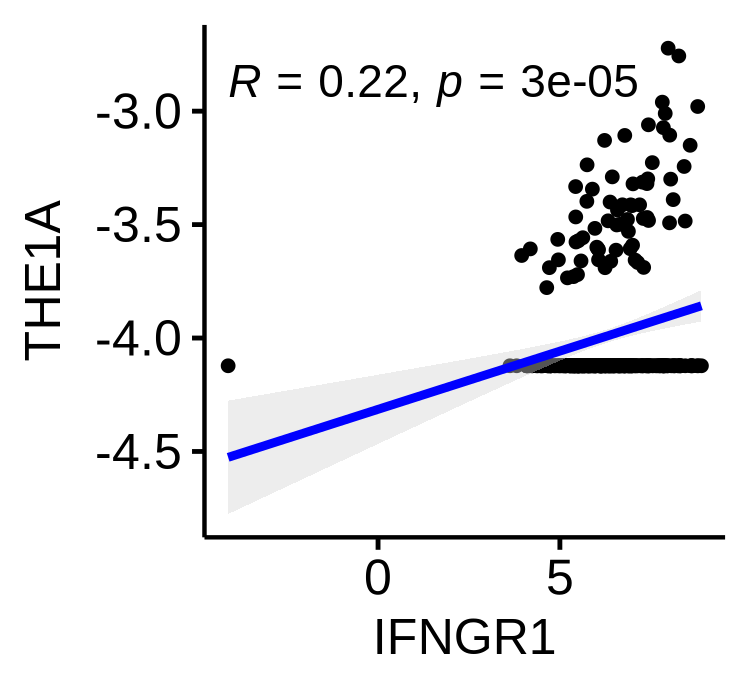

In [50]:
fname = '~/WenhuoHu/collab_Farhan/plot/beat_cor.pdf' 
pdf(file = fname, width = 2, height = 2) 
gg
dev.off()


In [2]:
ls()

character(0)

# molecular subtypes and TE expression DEG

In [485]:
beat_clin = fread(file = '/research_jude/rgs01_jude/groups/jxugrp/home/common/Lab_Members/WenhuoHu/collab_JinWang/bcat/data/beat_clin_beatAug13.tsv')
dim(beat_clin)
head(beat_clin) 
# '/research_jude/rgs01_jude/groups/jxugrp/home/common/Lab_Members/WenhuoHu/collab_JinWang/bcat'
 

[1] 942 118

dbgap_subject_id,dbgap_dnaseq_sample,dbgap_rnaseq_sample,cohort,used_manuscript_analyses,manuscript_dnaseq,manuscript_rnaseq,manuscript_inhibitor,consensus_sex,inferred_sex,⋯,TP53_mut,PPM1D_mut,ASXL1_mut,NRAS_mut,JAK2_mut,GNB1_mut,KRAS_mut,CBL_mut,IDH1_mut,IDH2_mut
<int>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,⋯,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>
2476,BA2102D,,Waves1+2,yes,yes,no,no,Female,Female,⋯,WT,WT,WT,WT,WT,WT,WT,WT,WT,WT
2476,BA2005D,,Waves1+2,no,no,no,no,Female,Male,⋯,WT,WT,WT,WT,WT,WT,WT,WT,WT,WT
2476,BA3074D,,Waves1+2,no,no,no,no,Female,Male,⋯,WT,WT,WT,WT,WT,WT,WT,WT,WT,WT
2476,BA2555D,,Waves1+2,no,no,no,no,Female,Female,⋯,WT,WT,WT,WT,WT,WT,WT,WT,WT,WT
2476,,BA3073R,Waves1+2,no,no,no,no,Female,,⋯,WT,WT,WT,WT,WT,WT,WT,WT,WT,WT
2157,BA2452D,BA2452R,Both,no,no,no,no,Male,Male,⋯,WT,WT,WT,WT,WT,WT,WT,WT,WT,WT


In [486]:
beat_clin[, idd := paste0(dbgap_subject_id, '_', sub('R$', '', dbgap_rnaseq_sample)) ]

In [488]:
dsn_clin = merge(beat_clin, dsn, by.y = 'sample_name', by.x = 'idd', all.x = T)

In [507]:
dsn_clin_sel = dsn_clin[idd %in% colnames(count_df_te), ]
dsn_clin_sel_df = setDF(dsn_clin_sel, rownames = dsn_clin_sel$idd)
dim(dsn)

[1] 735  51

In [517]:
dsn_b1_df = setDF(copy(dsn_b1), rownames = dsn_b1$sample_name) 
dsn_b2_df = setDF(copy(dsn_b2), rownames = dsn_b2$sample_name) 

In [ ]:
#gene_sel = setdiff(aml_genes, c( c('TP53', 'PPM1D', 'ASXL1', 'JAK2', 'GNB1', 'KRAS', 'CBL', 'IDH1'))) 
gene_sel = c('TET2', 'DNMT3A', 'SF3B1', 'NRAS', 'IDH2', 'TP53')
deg_mut_gene_b1 = lapply(gene_sel, function(gene){
    message(gene)
    gene_mut = paste0(gene, '_mut')
    dsn_sel = dsn_b1_df[dsn_b1_df$karyotype == 'Normal', ]
    dsn_sel$group = 'WT'
    dsn_sel$group[dsn_sel[, gene_mut] != 'WT'] = 'mut'
    dsn_sel$group = factor(dsn_sel$group, levels = c('WT', 'mut'))
    mtx = count_df_te_b1[, rownames(dsn_sel) ] 
    deg_fun2(dsn_sel, mtx)
})
names(deg_mut_gene_b1) = gene_sel

mut_sel = c('AML1ETO',  'MLL_re',  'FLT3ITD',  'PMLRARA',  'CBFBMYH11',  'GATA2MECOM')
deg_fus_gene_b1 = lapply(mut_sel, function(mut){
    message(mut)
    dsn1 = dsn_b1_df[dsn_b1_df$karyotype == 'Normal', ]
    dsn2 = dsn_b1_df[dsn_b1_df[, mut] != 'WT', ]
    dsn1 = dsn1[!(rownames(dsn1) %in% rownames(dsn2)), ]
    dsn1$group = 'WT'
    dsn2$group = 'mut'
    dsn_sel = rbind(dsn1, dsn2) 
    dsn_sel$group = factor(dsn_sel$group, levels = c('WT', 'mut'))
    mtx = count_df_te_b1[, rownames(dsn_sel) ] 
    deg_fun2(dsn_sel, mtx)
})
names(deg_fus_gene_b1) = mut_sel

deg_mut_b1 = c(deg_mut_gene_b1, deg_fus_gene_b1)
deg_mut_dt_b1 = rbindlist(deg_mut_b1, idcol = T)
head(deg_mut_dt_b1)

saveRDS(deg_mut_dt_b1, file = 'rds/deg_mut_dt_b1.rds')


In [527]:
table(dsn_b1_df$TP53_mut)


TP53_mut       WT 
       5      307 

In [ ]:
#gene_sel = setdiff(aml_genes, c( c('TP53', 'PPM1D', 'ASXL1', 'JAK2', 'GNB2', 'KRAS', 'CBL', 'IDH1'))) 
gene_sel = c('TET2', 'DNMT3A', 'NRAS', 'IDH2', 'TP53')
deg_mut_gene_b2 = lapply(gene_sel, function(gene){
    message(gene)
    gene_mut = paste0(gene, '_mut')
    dsn_sel = dsn_b2_df[dsn_b2_df$karyotype == 'Normal', ]
    dsn_sel$group = 'WT'
    dsn_sel$group[dsn_sel[, gene_mut] != 'WT'] = 'mut'
    dsn_sel$group = factor(dsn_sel$group, levels = c('WT', 'mut'))
    mtx = count_df_te_b2[, rownames(dsn_sel) ] 
    deg_fun2(dsn_sel, mtx)
})
names(deg_mut_gene_b2) = gene_sel

mut_sel = c('AML1ETO',  'MLL_re',  'FLT3ITD',  'PMLRARA',  'CBFBMYH11',  'GATA2MECOM')
deg_fus_gene_b2 = lapply(mut_sel, function(mut){
    message(mut)
    dsn1 = dsn_b2_df[dsn_b2_df$karyotype == 'Normal', ]
    dsn2 = dsn_b2_df[dsn_b2_df[, mut] != 'WT', ]
    dsn1 = dsn1[!(rownames(dsn1) %in% rownames(dsn2)), ]
    dsn1$group = 'WT'
    dsn2$group = 'mut'
    dsn_sel = rbind(dsn1, dsn2) 
    dsn_sel$group = factor(dsn_sel$group, levels = c('WT', 'mut'))
    mtx = count_df_te_b2[, rownames(dsn_sel) ] 
    deg_fun2(dsn_sel, mtx)
})
names(deg_fus_gene_b2) = mut_sel

deg_mut_b2 = c(deg_mut_gene_b2, deg_fus_gene_b2)
deg_mut_dt_b2 = rbindlist(deg_mut_b2, idcol = T)
head(deg_mut_dt_b2)

saveRDS(deg_mut_dt_b2, file = 'rds/deg_mut_dt_b2.rds')


In [529]:
deg_mut_dt_b1$batch = 'b1'
deg_mut_dt_b2$batch = 'b2'
deg_mut_dt = rbind(deg_mut_dt_b1, deg_mut_dt_b2)
saveRDS(deg_mut_dt, file = 'rds/deg_mut_dt.rds')


In [17]:
deg_mut_dt_b2 = readRDS(file = 'rds/deg_mut_dt_b2.rds')


In [20]:
deg_mut_dt = readRDS(file = 'rds/deg_mut_dt.rds')


In [18]:
gene_list = read_file('gene_list')

Current maximum version: 4 	 ~/WenhuoHu/collab_Farhan//gene_list_v4.rds 


In [23]:
deg_beat_mut_dt = copy(deg_mut_dt)
gene_list = add_gene_list(deg_beat_mut_dt, comment = 'deg_beat_mut_dt from beataml_myDownload.ipynb')

New version: 6 
File saved as: ~/WenhuoHu/collab_Farhan//gene_list_v6.rds 


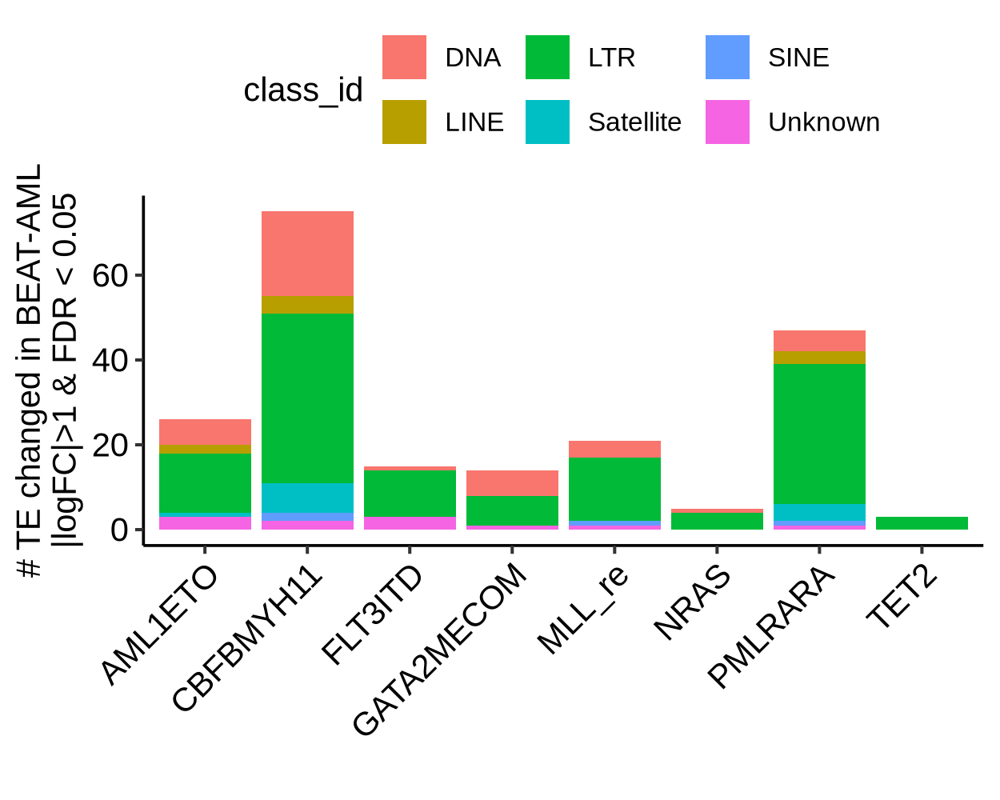

In [23]:
options(repr.plot.width = 7, repr.plot.height = 4, repr.plot.res = 250)
plotdat = deg_mut_dt_b2[FDR < 0.05 & abs(logFC) > 1, ]
plotdat[, class_id := unlist(strsplit(rn, ':'))[3], by = 1:nrow(plotdat)]
options(repr.plot.width = 5, repr.plot.height = 4, repr.plot.res = 250)
ggplot(plotdat, aes(x = .id, fill = class_id)) + geom_bar() + theme_pubr() + theme(axis.text.x = element_text(angle = 45, vjust = 1, hjust = 1)) + 
xlab('') + ylab('# TE changed in BEAT-AML\n|logFC|>1 & FDR < 0.05')

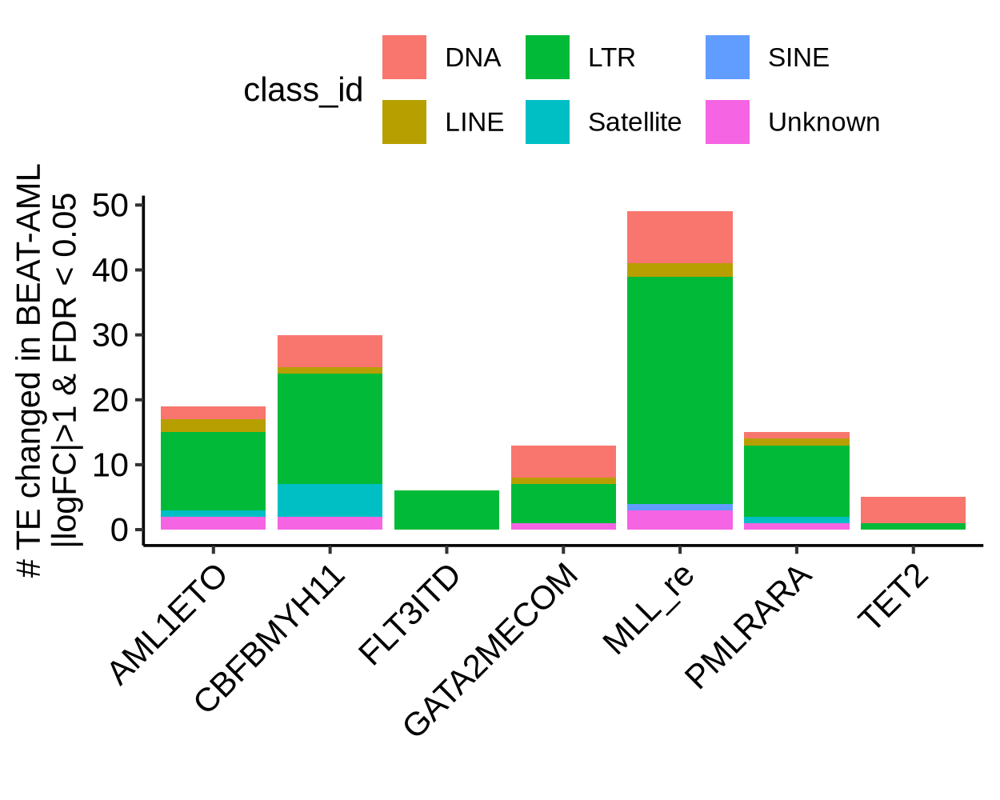

In [555]:
options(repr.plot.width = 7, repr.plot.height = 4, repr.plot.res = 250)
plotdat = deg_mut_dt_b1[FDR < 0.05 & abs(logFC) > 1, ]
plotdat[, class_id := unlist(strsplit(rn, ':'))[3], by = 1:nrow(plotdat)]
options(repr.plot.width = 5, repr.plot.height = 4, repr.plot.res = 250)
ggplot(plotdat, aes(x = .id, fill = class_id)) + geom_bar() + theme_pubr() + theme(axis.text.x = element_text(angle = 45, vjust = 1, hjust = 1)) + 
xlab('') + ylab('# TE changed in BEAT-AML\n|logFC|>1 & FDR < 0.05')

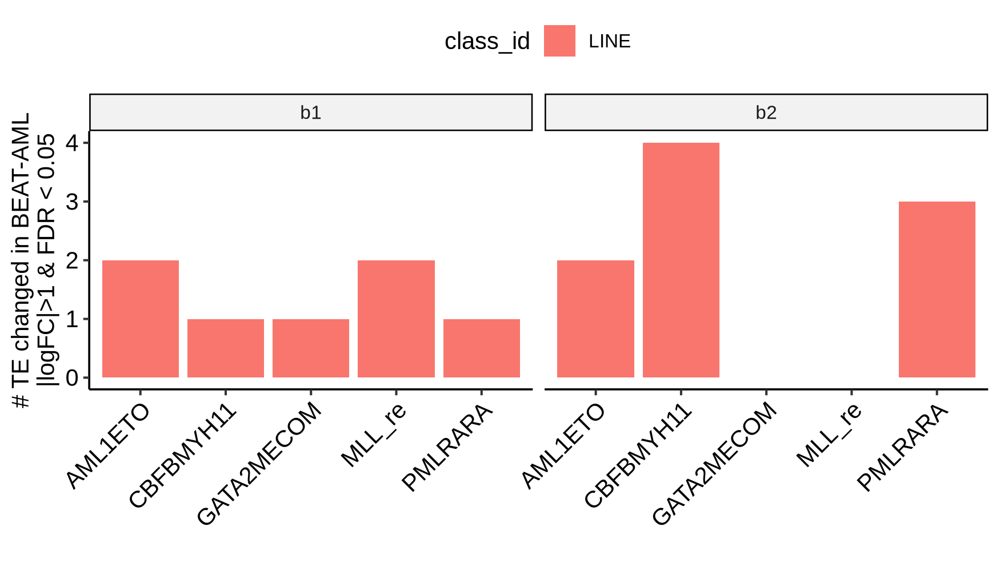

In [537]:
options(repr.plot.width = 14, repr.plot.height = 4, repr.plot.res = 250)
plotdat = deg_mut_dt[FDR < 0.05 & abs(logFC) > 1 & grepl('LINE$', rn), ]
plotdat[, class_id := unlist(strsplit(rn, ':'))[3], by = 1:nrow(plotdat)]
options(repr.plot.width = 7, repr.plot.height = 4, repr.plot.res = 250)
ggplot(plotdat, aes(x = .id, fill = class_id)) + geom_bar() + theme_pubr() + theme(axis.text.x = element_text(angle = 45, vjust = 1, hjust = 1)) + 
xlab('') + ylab('# TE changed in BEAT-AML\n|logFC|>1 & FDR < 0.05') + facet_wrap(~ batch, nrow = 1)

.id,batch,N
<chr>,<chr>,<int>
AML1ETO,b1,19
CBFBMYH11,b1,30
FLT3ITD,b1,6
GATA2MECOM,b1,13
MLL_re,b1,49
NRAS,b1,0


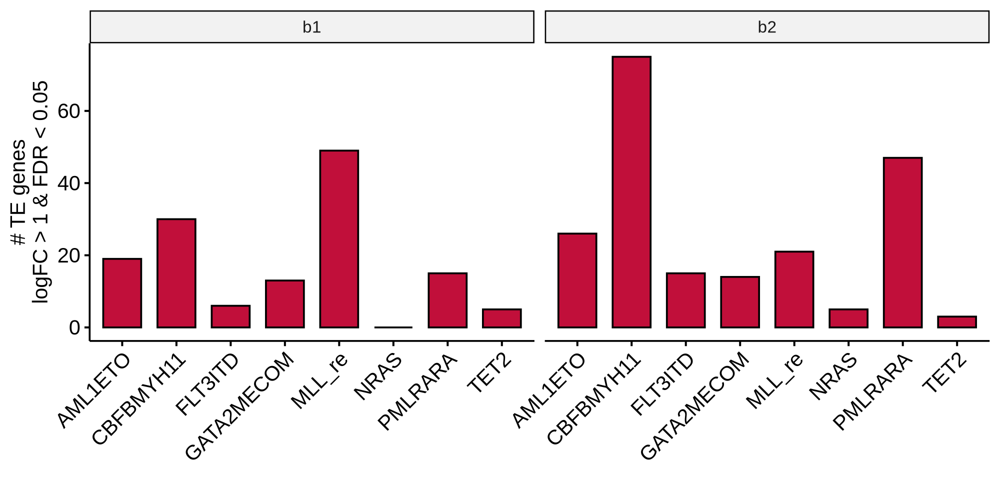

In [536]:
options(repr.plot.width = 8, repr.plot.height = 4, repr.plot.res = 250)
plotdat = as.data.table(table(deg_mut_dt[FDR < 0.05 & abs(logFC) > 1, .(.id, batch)]), keep.rownames = T)
head(plotdat)
ggbarplot(plotdat, x = '.id', y = 'N', fill = '#C10F3A') + theme(axis.text.x = element_text(angle = 45, vjust = 1, hjust = 1)) +
ylab('# TE genes\nlogFC > 1 & FDR < 0.05') + xlab('') + facet_wrap(~ batch, nrow = 1)


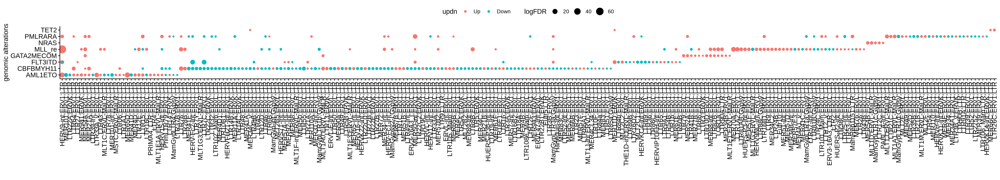

In [553]:
plotdat = deg_mut_dt[FDR < 0.05 & abs(logFC) > .5 & grepl('LTR$', rn), ]
plotdat[, logFDR := -log(FDR, 10) ]
plotdat[, updn := 'Up' ]
plotdat[logFC < 0, updn := 'Down' ]
plotdat[, updn := factor(updn, levels = c('Up', 'Down')) ]
options(repr.plot.width = 25, repr.plot.height = 4.5, repr.plot.res = 250)
ggdotchart(plotdat, y = '.id', x = 'rn', col = 'updn', size = 'logFDR') + xlab('') + ylab('genomic alterations')

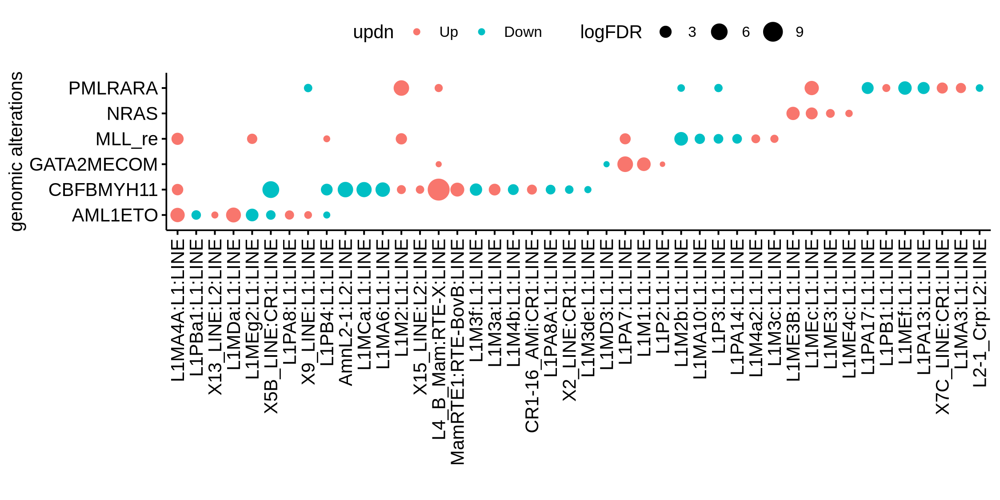

In [550]:
plotdat = deg_mut_dt[FDR < 0.05 & abs(logFC) > .5 & grepl('LINE$', rn), ]
plotdat[, logFDR := -log(FDR, 10) ]
plotdat[, updn := 'Up' ]
plotdat[logFC < 0, updn := 'Down' ]
plotdat[, updn := factor(updn, levels = c('Up', 'Down')) ]
options(repr.plot.width = 9, repr.plot.height = 4.5, repr.plot.res = 250)
ggdotchart(plotdat, y = '.id', x = 'rn', col = 'updn', size = 'logFDR') + xlab('') + ylab('genomic alterations')

In [263]:
table(dsn$PMLRARA)


PML-RARA       WT 
      13      367 

In [340]:
col_sel = c('AML1ETO',  'MLL_re',  'FLT3ITD',  'CBFBMYH11',  'GATA2MECOM',  'PMLRARA', 
  'karyotype',  'TET2_mut',  'DNMT3A_mut',  'SF3B1_mut',  'NRAS_mut',  'IDH2_mut') 


In [345]:
dsn_df$subtype = unlist(apply(dsn_df[, col_sel], 1, function(xx){paste(unique(xx), collapse = '_')}))

In [ ]:
1:3

The automatically generated colors map from the minus and plus 99^th of
the absolute values in the matrix. There are outliers in the matrix
whose patterns might be hidden by this color mapping. You can manually
set the color to `col` argument.

Use `suppressMessages()` to turn off this message.



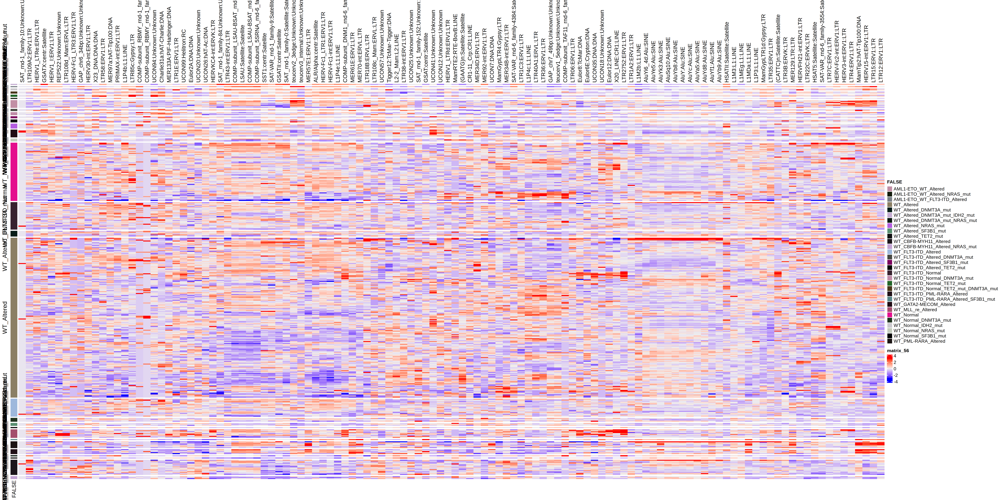

In [358]:
rn_sel = unique(deg_mut_dt[FDR < 0.1 & abs(logFC) > 1, rn])
plotdat = logcpm_beat_te[rn_sel, rownames(dsn_df)]
plotdat = scale_fun(plotdat)
mut_sel = c('AML1ETO',  'MLL_re',  'FLT3ITD',  'PMLRARA',  'CBFBMYH11',  'GATA2MECOM', 'karyotype')
gene_mut = paste0(c('TET2', 'DNMT3A', 'SF3B1', 'NRAS', 'IDH2'), '_mut')
#column_ha = HeatmapAnnotation(df = dsn_df[, c(mut_sel, gene_mut)])
options(repr.plot.width = 30, repr.plot.height = 15, repr.plot.res = 250)
row_ha = rowAnnotation(df = dsn_df[, 'subtype', drop = F], annotation_label = F)
#Heatmap(t(plotdat), top_annotation = column_ha, row_names_gp = grid::gpar(fontsize = 7), show_row_names = T, show_column_names = F, show_column_dend = F, show_row_dend = F)
Heatmap(t(plotdat), left_annotation = row_ha, row_names_gp = grid::gpar(fontsize = 9), show_row_names = F, show_column_names = T, 
        show_column_dend = F, show_row_dend = F, column_names_side = 'top', row_split = dsn_df$subtype)


In [352]:
rn_sel = unique(deg_mut_dt[FDR < 0.1 & abs(logFC) > 1, rn])
plotdat = logcpm_beat_te[rn_sel, rownames(dsn_df)]
plotdat = scale_fun(plotdat)
mut_sel = c('AML1ETO',  'MLL_re',  'FLT3ITD',  'PMLRARA',  'CBFBMYH11',  'GATA2MECOM', 'karyotype')
gene_mut = paste0(c('TET2', 'DNMT3A', 'SF3B1', 'NRAS', 'IDH2'), '_mut')
#column_ha = HeatmapAnnotation(df = dsn_df[, c(mut_sel, gene_mut)])
options(repr.plot.width = 30, repr.plot.height = 75, repr.plot.res = 250)
row_ha = rowAnnotation(df = dsn_df[, 'subtype', drop = F] )
#Heatmap(t(plotdat), top_annotation = column_ha, row_names_gp = grid::gpar(fontsize = 7), show_row_names = T, show_column_names = F, show_column_dend = F, show_row_dend = F)
Heatmap(t(plotdat), left_annotation = row_ha, row_names_gp = grid::gpar(fontsize = 9), show_row_names = F, show_column_names = T, 
        show_column_dend = F, show_row_dend = F, column_names_side = 'top', row_split = dsn_df$subtype)


The automatically generated colors map from the minus and plus 99^th of
the absolute values in the matrix. There are outliers in the matrix
whose patterns might be hidden by this color mapping. You can manually
set the color to `col` argument.

Use `suppressMessages()` to turn off this message.



The automatically generated colors map from the minus and plus 99^th of
the absolute values in the matrix. There are outliers in the matrix
whose patterns might be hidden by this color mapping. You can manually
set the color to `col` argument.

Use `suppressMessages()` to turn off this message.



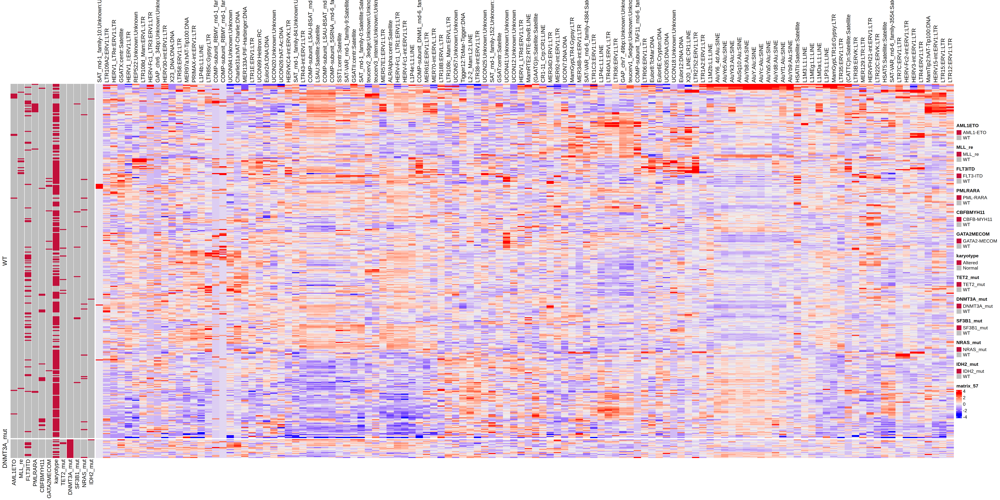

In [359]:
rn_sel = unique(deg_mut_dt[FDR < 0.1 & abs(logFC) > 1, rn])
plotdat = logcpm_beat_te[rn_sel, rownames(dsn_df)]
plotdat = scale_fun(plotdat)
mut_sel = c('AML1ETO',  'MLL_re',  'FLT3ITD',  'PMLRARA',  'CBFBMYH11',  'GATA2MECOM', 'karyotype')
gene_mut = paste0(c('TET2', 'DNMT3A', 'SF3B1', 'NRAS', 'IDH2'), '_mut')
#column_ha = HeatmapAnnotation(df = dsn_df[, c(mut_sel, gene_mut)])
row_ha = rowAnnotation(df = dsn_df[, c(mut_sel, gene_mut)], 
                       col = list(AML1ETO = c('WT' = 'grey', 'AML1-ETO' = '#C10F3A'),
                                  MLL_re  = c('WT' = 'grey', 'MLL_re'   = '#C10F3A'),
                                  FLT3ITD = c('WT' = 'grey', 'FLT3-ITD'   = '#C10F3A'), 
                                  CBFBMYH11 = c('WT' = 'grey', 'CBFB-MYH11'   = '#C10F3A'),
                                  GATA2MECOM = c('WT' = 'grey', 'GATA2-MECOM'   = '#C10F3A'),
                                  PMLRARA = c('WT' = 'grey', 'PML-RARA'   = '#C10F3A'),
                                  karyotype = c('Normal' = 'grey', 'Altered'   = '#C10F3A'),
                                  TET2_mut = c('WT' = 'grey', 'TET2_mut'   = '#C10F3A'),
                                  DNMT3A_mut = c('WT' = 'grey', 'DNMT3A_mut'   = '#C10F3A'),
                                  SF3B1_mut = c('WT' = 'grey', 'SF3B1_mut'   = '#C10F3A'),
                                  NRAS_mut = c('WT' = 'grey', 'NRAS_mut'   = '#C10F3A'),
                                  IDH2_mut = c('WT' = 'grey', 'IDH2_mut'   = '#C10F3A')
                                 ))
options(repr.plot.width = 30, repr.plot.height = 15, repr.plot.res = 250)
#Heatmap(t(plotdat), top_annotation = column_ha, row_names_gp = grid::gpar(fontsize = 7), show_row_names = T, show_column_names = F, show_column_dend = F, show_row_dend = F)
Heatmap(t(plotdat), left_annotation = row_ha, row_names_gp = grid::gpar(fontsize = 9), show_row_names = F, show_column_names = T, 
        show_column_dend = F, show_row_dend = F, column_names_side = 'top', row_split = dsn_df$DNMT3A_mut)


The automatically generated colors map from the minus and plus 99^th of
the absolute values in the matrix. There are outliers in the matrix
whose patterns might be hidden by this color mapping. You can manually
set the color to `col` argument.

Use `suppressMessages()` to turn off this message.



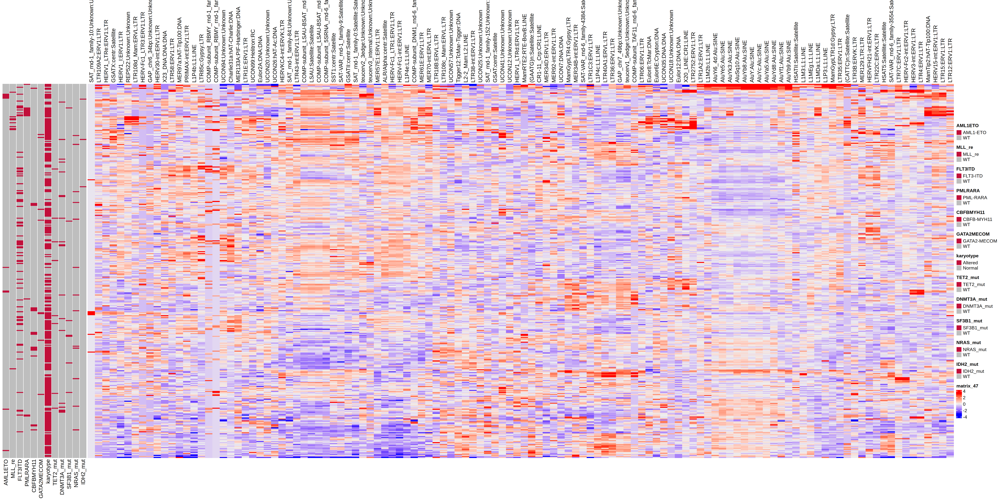

In [267]:
rn_sel = unique(deg_mut_dt[FDR < 0.1 & abs(logFC) > 1, rn])
plotdat = logcpm_beat_te[rn_sel, rownames(dsn_df)]
plotdat = scale_fun(plotdat)
mut_sel = c('AML1ETO',  'MLL_re',  'FLT3ITD',  'PMLRARA',  'CBFBMYH11',  'GATA2MECOM', 'karyotype')
gene_mut = paste0(c('TET2', 'DNMT3A', 'SF3B1', 'NRAS', 'IDH2'), '_mut')
#column_ha = HeatmapAnnotation(df = dsn_df[, c(mut_sel, gene_mut)])
row_ha = rowAnnotation(df = dsn_df[, c(mut_sel, gene_mut)], 
                       col = list(AML1ETO = c('WT' = 'grey', 'AML1-ETO' = '#C10F3A'),
                                  MLL_re  = c('WT' = 'grey', 'MLL_re'   = '#C10F3A'),
                                  FLT3ITD = c('WT' = 'grey', 'FLT3-ITD'   = '#C10F3A'), 
                                  CBFBMYH11 = c('WT' = 'grey', 'CBFB-MYH11'   = '#C10F3A'),
                                  GATA2MECOM = c('WT' = 'grey', 'GATA2-MECOM'   = '#C10F3A'),
                                  PMLRARA = c('WT' = 'grey', 'PML-RARA'   = '#C10F3A'),
                                  karyotype = c('Normal' = 'grey', 'Altered'   = '#C10F3A'),
                                  TET2_mut = c('WT' = 'grey', 'TET2_mut'   = '#C10F3A'),
                                  DNMT3A_mut = c('WT' = 'grey', 'DNMT3A_mut'   = '#C10F3A'),
                                  SF3B1_mut = c('WT' = 'grey', 'SF3B1_mut'   = '#C10F3A'),
                                  NRAS_mut = c('WT' = 'grey', 'NRAS_mut'   = '#C10F3A'),
                                  IDH2_mut = c('WT' = 'grey', 'IDH2_mut'   = '#C10F3A')
                                 ))
options(repr.plot.width = 30, repr.plot.height = 15, repr.plot.res = 250)
#Heatmap(t(plotdat), top_annotation = column_ha, row_names_gp = grid::gpar(fontsize = 7), show_row_names = T, show_column_names = F, show_column_dend = F, show_row_dend = F)
Heatmap(t(plotdat), left_annotation = row_ha, row_names_gp = grid::gpar(fontsize = 9), show_row_names = F, show_column_names = T, 
        show_column_dend = F, show_row_dend = F, column_names_side = 'top')


In [45]:
dsn_df$group = dsn_df$FLT3ITD
deg_te_flt3itd = deg_fun('WT', 'FLT3-ITD', dsn_df, count_df_te, if_cpm = T)
logcpm_deg_te_flt3itd = deg_te_flt3itd[[2]]
deg_te_flt3itd = deg_te_flt3itd[[1]]
head(deg_te_flt3itd)


rn,logFC,logCPM,PValue,FDR
<chr>,<dbl>,<dbl>,<dbl>,<dbl>
Charlie31a:hAT-Charlie:DNA,1.2205151,7.5652691,3.782802e-16,4.955471e-13
GSAT:centr:Satellite,1.5397224,0.3324116,7.777793e-16,5.094455e-13
LTR33A_v:ERVL:LTR,0.5911217,8.1352381,9.934955e-14,4.338264e-11
HERV-Fc2-int:ERV1:LTR,-1.9905639,8.4630227,6.632486e-11,2.172139e-08
HERV15-int:ERV1:LTR,0.9989653,8.1866454,1.226929e-08,3.214555e-06
LTR36:ERV1:LTR,-0.9815219,7.2302871,2.274285e-08,4.965521e-06


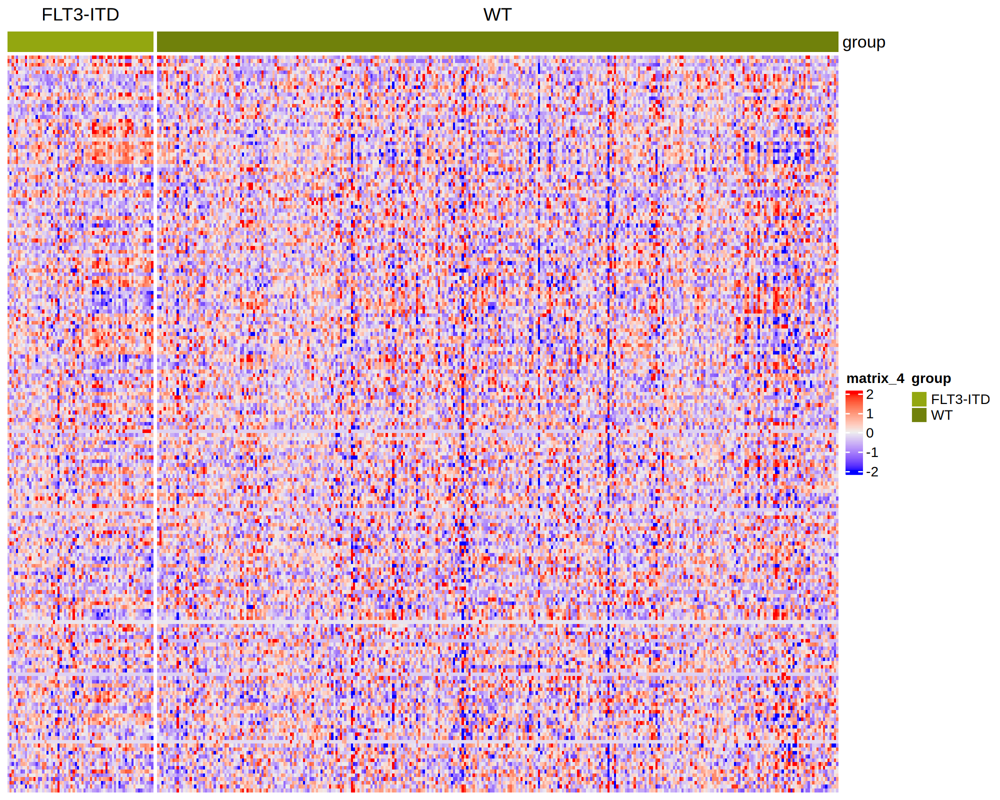

In [71]:
options(repr.plot.width = 10, repr.plot.height = 8, repr.plot.res = 200)
heatmap_fun(logcpm_deg_te_flt3itd, dsn_df, deg_te_flt3itd, show_row_names = F)

In [69]:
tmp = list(a=1, b=2)
tmp
c(tmp, a=3)
list(tmp, a=3)

$a
[1] 1

$b
[1] 2

$a
[1] 1

$b
[1] 2

$a
[1] 3

[[1]]
[[1]]$a
[1] 1

[[1]]$b
[1] 2


$a
[1] 3

In [1]:
ls()

character(0)

In [ ]:
options(repr.plot.width = ncol(plotdat) * unit(5, 'mm'), repr.plot.height = nrow(plotdat) * unit(5, 'mm'), repr.plot.res = 200)
hp

ERROR: Error in Cairo::Cairo(width, height, tf, "png", pointsize, bg, "transparent", : Failed to create Cairo backend!


ERROR: Error in eval(expr, envir, enclos): object 'dsn_df' not found


In [28]:
logcpm_deg_te_flt3itd

ERROR: Error in eval(expr, envir, enclos): object 'logcpm_deg_te_flt3itd' not found


In [30]:
ls()

[1] "add_ann"            "aml_genes"          "base_dir"          
 [4] "coding_genes"       "count_df"           "count_df_coding"   
 [7] "count_df_te"        "count_dt"           "count_list"        
[10] "cpm_fun"            "cut_quantile"       "data_dir"          
[13] "deg_fun"            "deg_local_fun"      "deg_telocal_fun"   
[16] "dge"                "dsn"                "dsn_sel"           
[19] "head2"              "logcpm_3cohorts_t"  "logcpm_beat_coding"
[22] "logcpm_beat_t"      "logcpm_beat_te"     "pathway_fun"       
[25] "PP"                 "scale_fun"          "tail2"             
[28] "telocal_dt"         "telocal_list"       "tmp"               
[31] "txdb"

In [287]:
deg_te_dnmt3a = deg_fun('WT', 'DNMT3A_mut', dsn_sel_df, count_df_te, if_cpm = T)


In [289]:
head(deg_te_dnmt3a[[1]])

rn,logFC,logCPM,PValue,FDR
<chr>,<dbl>,<dbl>,<dbl>,<dbl>
SAT_rnd-1_family-152:Unknown:Unknown,4.1349143,2.546314,1.348128e-13,1.766048e-10
ERVL-int:ERVL:LTR,0.5634708,7.323699,8.355040e-05,5.472551e-02
Tigger8:TcMar-Tigger:DNA,0.2997231,8.024739,7.653334e-04,3.341956e-01
LTR75_1:ERV1:LTR,-0.6100929,4.802873,4.627500e-03,9.932995e-01
HERV-Fc2-int:ERV1:LTR,-2.9667759,9.237230,6.599939e-03,9.932995e-01
LTR1C:ERV1:LTR,-0.3990580,3.418123,7.009829e-03,9.932995e-01


In [265]:
deg_fun

function (group1, group2, dsn, mtx, if_cpm = F) 
{
    group1_name = paste(group1, collapse = "_")
    group2_name = paste(group2, collapse = "_")
    dsn_sel = dsn[dsn$group %in% c(group1, group2), , drop = F]
    dsn_sel$group[dsn_sel$group %in% group1] = group1_name
    dsn_sel$group[dsn_sel$group %in% group2] = group2_name
    groups = factor(dsn_sel$group, levels = c(group1_name, group2_name))
    mtx_sel = mtx[, rownames(dsn_sel)]
    dge = DGEList(counts = mtx_sel, group = groups)
    dge <- calcNormFactors(dge)
    dge = normLibSizes(dge)
    design = model.matrix(~0 + groups)
    dge = estimateDisp(dge, design)
    et <- exactTest(dge)
    deg = topTags(et, n = nrow(mtx_sel))
    deg = as.data.table(deg$table, keep.rownames = T)
    if (if_cpm == T) {
        logcpm = cpm(dge, log = T)
        deg = list(deg = deg, logcpm = logcpm)
    }
    deg
}

In [ ]:
count_df_te

In [261]:
tail2(logcpm_beat_t)

teucerv1_5edge:Unknown:Unknown,teucerv2_3edge:Unknown:Unknown,teucerv3_internal:Unknown:Unknown,relapse_LTR_UP,CMP_dn_LTR_DNA,lvl
<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<chr>
9.191442,6.413226,-0.06159675,-0.02520708,-0.14783536,low
8.284575,7.012904,-0.01837146,0.37121286,0.25099435,hi
5.401812,7.824462,0.60311330,-0.59817373,-0.21096334,low
8.550444,7.054691,1.21496140,-0.36407600,-0.02528668,low


In [ ]:
logcpm_beat_t$FLT3ITD
logcpm_beat_t$MLL_re
logcpm_beat_t$AML1ETO
logcpm_beat_t$DNMT3A_mut

# concensus clusterting

In [94]:
library(ConsensusClusterPlus)


In [103]:
aml_genes
aml_genes_mut = paste0(aml_genes, '_mut')
feat_sel = c(aml_genes_mut, 'MLL_re', 'FLT3ITD', 'AML1ETO', 'karyotype')


[1] "TET2"   "DNMT3A" "SF3B1"  "TP53"   "PPM1D"  "ASXL1"  "NRAS"   "JAK2"  
 [9] "GNB1"   "KRAS"   "CBL"    "IDH1"   "IDH2"

In [147]:
myPal = function(n=10){
  #returns n colors
  seq = rev(seq(0,255,by=255/(n)))
  palRGB = cbind(seq,seq,255)
  rgb(palRGB,maxColorValue=255)
}

In [ ]:
plotdat = scale_fun(logcpm_beat_te)
consensus_te = ConsensusClusterPlus(plotdat,maxK=15,reps=50,pItem=0.8,pFeature=1, title='BEATAML_te',clusterAlg="hc",distance="pearson",seed=1262118388.71279,plot="pdf")


In [190]:
length(consensus_te)

[1] 15

[1] 381 380

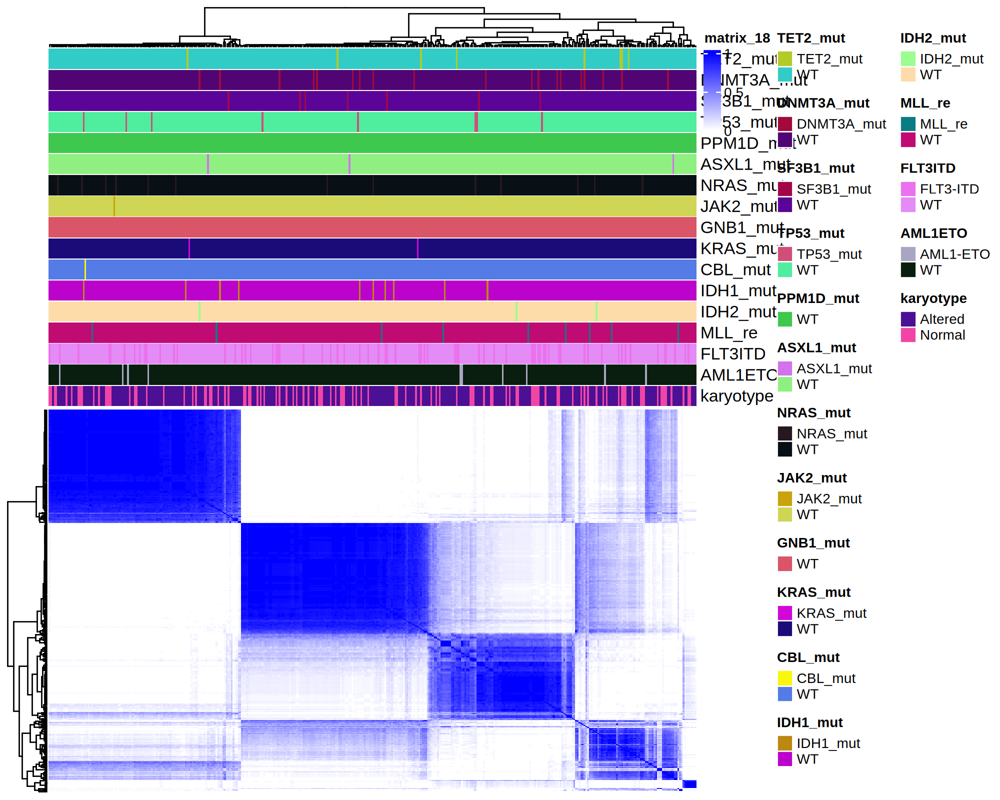

In [195]:
tk = 6
c = consensus_te[[tk]]$consensusMatrix
hc = consensus_te[[tk]]$consensusTree
ct = consensus_te[[tk]]$consensusClass
pc = c[hc$order, ]
#res[[tk]] = list(consensusMatrix = c, consensusTree = hc, consensusClass = ct, ml = ml[[tk]], clrs = colorList)
pc = rbind(pc, 0)
dim(pc)
tmyPal = myPal(10)
clrs = consensus_te[[tk]]$clrs
column_ha = HeatmapAnnotation(df = dsn_df[, feat_sel, drop = F])
Heatmap(pc, col = tmyPal, top_annotation = column_ha)
#heatmap(pc, Colv = as.dendrogram(hc), Rowv = NA,  symm = FALSE, scale = "none", col = tmyPal, na.rm = TRUE, 
#            labRow = F, labCol = F, mar = c(5, 5), main = paste("consensus matrix k=",  tk, sep = ""), ColSideCol = clrs[[1]])


In [177]:
tmyPal

[1] "#FFFFFF" "#E5E5FF" "#CCCCFF" "#B2B2FF" "#9999FF" "#7F7FFF" "#6666FF"
 [8] "#4C4CFF" "#3333FF" "#1919FF" "#0000FF"

In [171]:
head(pc)

0,0,0,0,0,0,0,0,0,0,⋯,0,0,0,0,0,0,0,0,0,0
0,0,0,0,0,0,0,0,0,0,⋯,0,0,0,0,0,0,0,0,0,0
0,0,0,0,0,0,0,0,0,0,⋯,0,0,0,0,0,0,0,0,0,0
0,0,0,0,0,0,0,0,0,0,⋯,0,0,0,0,0,0,0,0,0,0
0,0,0,0,0,0,0,0,0,0,⋯,0,0,0,0,0,0,0,0,0,0
0,0,0,0,0,0,0,0,0,0,⋯,0,0,0,0,0,0,0,0,0,0


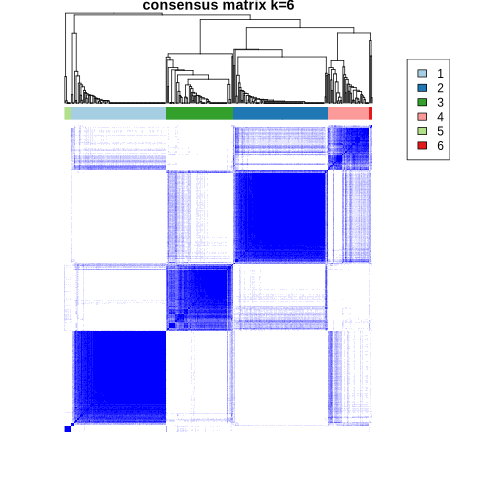

In [164]:
display_png(file = 'BEATAML_te/consensus006.png')

In [194]:
file.exists('BEATAML_te/consensus.pdf')
getwd()

[1] TRUE

[1] "/research_jude/rgs01_jude/groups/jxugrp/home/common/Lab_Members/WenhuoHu/dataset/beataml"

In [ ]:
/research_jude/rgs01_jude/groups/jxugrp/home/common/Lab_Members/WenhuoHu/dataset/beataml/BEATAML_te/consensus.pdf

In [170]:
table(ct)

ct
  1   2   3   4   5   6 
372   3   1   1   2   1 

In [ ]:
consensus_coding = ConsensusClusterPlus(logcpm_beat_coding,maxK=6,reps=50,pItem=0.8,pFeature=1, title='BEATAML_coding',clusterAlg="hc",distance="pearson",seed=1262118388.71279,plot="png")

[](BEATAML_te//consensus001.png)

In [ ]:
icl = calcICL(results,title=title,plot="png")
 icl[["clusterConsensus"]]

# export 

In [738]:
sample_name_gdc   = dsn[if_gdc == 'Yes',  sample_name]
sample_name_local = dsn[if_gdc == 'No',   sample_name]


In [1069]:
getwd()

[1] "/research_jude/rgs01_jude/groups/jxugrp/home/common/Lab_Members/WenhuoHu/dataset/beataml"

In [485]:
fwrite(dsn, file = 'dsn_beat_735cases_sep5.tsv', sep = '\t')


In [6]:
dsn = fread('tsv/dsn_beat_735cases_sep5.tsv')


In [ ]:
saveRDS(logcpm_telocal_b1, file = 'rds/logcpm_telocal_b1.rds')
saveRDS(logcpm_telocal_b2, file = 'rds/logcpm_telocal_b2.rds')


In [ ]:
saveRDS(count_df, file = 'count_d.rds')
saveRDS(logcpm_beataml_telocal, file = 'logcpm_beataml_telocal.rds') 
saveRDS(telocal_df, file = 'telocal_df.rds') 


saveRDS(count_df_coding, file = 'count_df_coding.rds')
saveRDS(logcpm_beat_coding, file = 'logcpm_beat_coding.rds')

saveRDS(count_df_te, file = 'count_df_te.rds')
saveRDS(logcpm_beat_te, file = 'logcpm_beat_te.rds')


In [7]:
logcpm_telocal_b1 = readRDS(file = 'rds/logcpm_telocal_b1.rds')
logcpm_telocal_b2 = readRDS(file = 'rds/logcpm_telocal_b2.rds')


In [10]:
getwd()

[1] "/research_jude/rgs01_jude/groups/jxugrp/home/common/Lab_Members/WenhuoHu/dataset/beataml"

In [11]:
count_df_coding     = readRDS(file = 'rds/count_df_coding.rds')
logcpm_beat_coding  = readRDS(file = 'rds/logcpm_beat_coding.rds')

count_df_te    = readRDS(file = 'rds/count_df_te.rds')
logcpm_beat_te = readRDS(file = 'rds/logcpm_beat_te.rds')


Warning message in gzfile(file, "rb"):
"cannot open compressed file 'rds/count_df_coding.rds', probable reason 'No such file or directory'"


ERROR: Error in gzfile(file, "rb"): cannot open the connection


In [37]:
fwrite(dsn, file = 'beataml_dsn_15Jul.tsv')
fwrite(dsn_sel, file = 'beataml_dsn_sel_15Jul.tsv')

In [ ]:
fwrite(dsn_clin_sel_df, file = 'dsn_clin_sel_df_735cases.tsv')
fwrite(dsn_clin_sel, file = 'dsn_clin_sel_735cases.tsv')

In [ ]:
dsn = fread('tsv/beataml_dsn_15Jul.tsv')

In [497]:
fwrite(dsn_b1, file = 'tsv/dsn_b1.tsv') 
fwrite(dsn_b2, file = 'tsv/dsn_b2.tsv') 

In [9]:
dsn_b1 = fread(file = 'tsv/dsn_b1.tsv') 
dsn_b2 = fread(file = 'tsv/dsn_b2.tsv') 

In [9]:
colnames(dsn)

[1] "bam_ori_file"        "sample_name"         "sample_name2"       
 [4] "sample_pre"          "sample_dir"          "sorted_bam_file"    
 [7] "validateBam_jobname" "validateBam_oo"      "validateBam_er"     
[10] "validateBam_cmd"     "sortBam_jobname"     "sortBam_oo"         
[13] "sortBam_er"          "sortBam_cmd"         "eof"                
[16] "fq_1"                "fq_2"                "bam2fq_jobname"     
[19] "bam2fq_oo"           "bam2fq_er"           "bam2fq_cmd"         
[22] "fq_1_gz"             "fq_2_gz"             "fq1_gzip_jobname"   
[25] "fq1_gzip_oo"         "fq1_gzip_er"         "fq1_gzip_cmd"       
[28] "fq2_gzip_jobname"    "fq2_gzip_oo"         "fq2_gzip_er"        
[31] "fq2_gzip_cmd"        "star_jobname"        "star_oo"            
[34] "star_eo"             "bam_prefix"          "bam_file"           
[37] "star_cmd"            "tecount_jobname"     "tecount_oo"         
[40] "tecount_eo"          "tecount_cmd"         "tecount_file"       
[43] "telocal_jobname"     "telocal_oo"          "telocal_eo"         
[46] "telocal_cmd"         "telocal_file"

# clean up storage

In [1067]:
dsn$bam_ori_gdc_file[1]

[1] "/research_jude/rgs01_jude/groups/jxugrp/home/common/Data_Public/RNA_seq/BEATAML/GDCdata/7c360cd7-5df2-4389-ab5f-7d808d33a53d/9c70490e-3cf5-4cf7-82e4-82e1a894c835.rna_seq.transcriptome.gdc_realn.bam"

In [ ]:
# /research_jude/rgs01_jude/groups/jxugrp/home/common/Data_Public/RNA_seq/BEATAML/GDCdata/

In [1066]:
all(file.exists(dsn$bam_ori_gdc_file))

[1] TRUE